# ML-модель для прогнозирования темпа (BPM) музыкальных треков

## Описание проекта

Данный проект создан в рамках портфолио и реализуется в рамках соревнования __Kaggle Playground Series - Season 5, Episode 9— Predicting the Beats-per-Minute of Songs (2025)__
- https://www.kaggle.com/competitions/playground-series-s5e9/

__Цель проекта — построить модель машинного обучения, способную предсказывать количество ударов в минуту (BeatsPerMinute, BPM) для музыкальных треков на основе их акустических и композиционных характеристик.__
- BPM является ключевым параметром в музыкальной индустрии, используемым для классификации жанров, создания плейлистов, диджеинга и музыкального производства.

Проект демонстрирует навыки:
- загрузки и предобработки данных,
- исследовательского анализа (EDA),
- построения и сравнения моделей машинного обучения,
- визуализации результатов,
- оценки качества предсказаний с использованием метрики Root Mean Squared Error (RMSE).

В рамках проекта будут использованы методы машинного обучения для регрессии, а также проведен полный цикл анализа данных.

__Метрика оценки:__ Root Mean Squared Error (RMSE) между предсказанными и фактическими значениями BPM.

__Практическая ценность:__
- Музыкальные треки обладают различными параметрами, отражающими ритм, громкость, настроение, инструментальность и другие звуковые особенности
- BPM — важный показатель в музыкальной индустрии, влияющий на восприятие трека, его использование в плейлистах, рекламе и рекомендационных системах.
- Автоматическое определение темпа музыкальных композиций важно для музыкальных стриминговых сервисов (Spotify, Apple Music), DJ-приложений, фитнес-приложений (подбор музыки под темп тренировки)  и музыкальных рекомендательных систем.

## Описание данных

Датасет был синтезирован с помощью глубокого обучения на основе открытого набора данных __"BPM Prediction Challenge"__ (https://www.kaggle.com/datasets/gauravduttakiit/bpm-prediction-challenge)
- Распределения признаков близки к оригинальным, но не идентичны

Данные разделены на три файла:
- train.csv — обучающая выборка, содержит целевую переменную BeatsPerMinute.
- test.csv — тестовая выборка, для которой необходимо предсказать BPM.
- sample_submission.csv — пример файла для отправки предсказаний.

Признаки:
- __id__ — уникальный идентификатор трека
- __RhythmScore__ — оценка ритмичности трека
- __AudioLoudness__ — уровень громкости аудио (в дБ)
- __VocalContent__ — доля вокального контента в треке
- __AcousticQuality__ —  степень "акустичности" трека
- __InstrumentalScore__ — оценка инструментальности трека
- __LivePerformanceLikelihood__ — вероятность живого исполнения
- __MoodScore__ — оценка настроения трека
- __TrackDurationMs__ — длительность трека в миллисекундах
- __Energy__ — оценка энергетичности трека
- __Целевая переменная:__ BeatsPerMinute (только в train.csv)- количество ударов в минуту

## Цели исследования

- Провести исследовательский анализ данных (EDA) и выявить ключевые характеристики трека, влияющие на BPM.
- Выявить закономерности между акустическими признаками и целевой переменной BPM
- Построить и сравнить различные модели машинного обучения для предсказания BPM.
- Оценить качество моделей с помощью кросс-валидации по метрике Root Mean Squared Error (RMSE) и минимизировать ошибку RMSE
- Создать визуализации распределений, корреляций и важности признаков

## Ход исследования

Шаг 1: Загрузка данных
- Подключение к Kaggle API, скачивание файлов
- Первичный анализ структуры и типов данных
- Проверка согласованности id между train и test

Шаг 2: Предобработка данных
- Приведение названий столбцов к единому стилю (snake_case)
- Приведение типов (float, int)
- Проверка на пропуски и дубликаты


Шаг 3: Исследовательский анализ данных (EDA)
- Распределение целевой переменной BeatsPerMinute (гистограмма, boxplot)
- Гистограммы и ящики с усами распределений признаков
  - проверка и обработка выбросов
- Матрица корреляций(heatmap) для выявления зависимостей
- Попарные графики (pairplot) для ключевых признаков
- Диаграммы рассеяния (scatter plots) для пар признаков с высокой корреляцией
- Диаграммы рассеяния (scatter plots) между признаками и BPM
- Поиск мультиколлинеарности и выделение ключевых признаков
- Категории BPM

Шаг 4. Подготовка к обучению моделей
- Feature Engineering (создание новых признаков)
  - TrackDuration в минутах и секундах
  - логарифм длительности трека
  - cоздать взаимодействия признаков:
    - 'energy' * 'rhythm_score'
    - 'vocal_content' * 'instrumental_score'
    - 'mood_score' * 'energy'
    - 'audio_loudness' * 'track_duration_ms'
  - соотношения признаков ('energy'/'rhythm_score', 'vocal_content'/'instrumental_score')
  - полиномиальные признаки для ключевых параметров
  - категории длительности трека (короткий, средний, длинный)
- Разделение признаков и целевой переменной для обучающей выборки на train/valid
- Предобработка данных: масштабирование и кодирование

Шаг 5. Обучение моделей
- Базовые модели: DummyRegressor
- Линейная регрессия: Linear Regression, Ridge, Lasso
- Решающие деревья и градиентный бустинг: Decision Tree, Gradient Boosting (XGBoost, LightGBM, CatBoost)
- Подбор гиперпараметров (GridSearchCV)
- Сравнение моделей по RMSE на валидации
- Анализ ошибок обучающей выборки
- Интерпретация важности признаков (Feature Importance)

Шаг 6: Формирование submission
- Предсказание BPM для тестовой выборки с помощью лучшей модели
- Сохранение итоговых предсказаний в формате:
  - id,BeatsPerMinute
  - 524164,119.5
  - 524165,127.42

Шаг 7: Исследование синтетической природы данных:
- Сравнить распределения с оригинальным BPM Prediction Challenge датасетом (https://www.kaggle.com/datasets/gauravduttakiit/bpm-prediction-challenge)
- Оценить возможность использования оригинальных данных для улучшения модели

## Ожидаемые результаты

- Интерактивные графики распределений и корреляций
- Таблицы важности признаков
- Сравнительная таблица моделей по RMSE
- Финальный submission-файл для Kaggle
- Аналитические инсайты:
  - Определение ТОП-5 признаков, наиболее влияющих на BPM
  - Выявление паттернов: какие характеристики типичны для быстрых/медленных треков
  - Анализ выбросов: треки с необычными комбинациями характеристик
- Сравнение синтетических и реальных данных

<a class="anchor" id="contents"></a>
# Содержание:<a class="anchor" id="ch2_1"></a>

* [Шаг 1: Загрузка данных](#ch2_1_1)
* [Шаг 2: Предобработка данных](#ch2_1_2)
* [Шаг 3: Исследовательский анализ данных (EDA)](#ch2_1_3)
* [Шаг 4: Подготовка к обучению моделей](#ch2_1_4)
* [Шаг 5: Обучение моделей](#ch2_1_5)
* [Шаг 6: Формирование submission](#ch2_1_6)
* [Шаг 7: Исследование синтетической природы данных](#ch2_1_7)

# Выполнение проекта

## Технический стек

- Проект написан на Python с использованием следующих библиотек:

In [1]:
# 📁 Работа с файлами и API
import os, zipfile, requests, re
from IPython.display import display
from kaggle.api.kaggle_api_extended import KaggleApi
from charset_normalizer import from_path

# 📊 Базовые библиотеки анализа данных
import pandas as pd
import numpy as np

# 📈 Визуализация
import matplotlib.pyplot as plt
import seaborn as sns

# 🔍 Корреляционный анализ
import phik
from phik import phik_matrix

from scipy import stats

from sklearn.preprocessing import OneHotEncoder, StandardScaler

import time
from sklearn.dummy import DummyRegressor
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import StackingRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor

from sklearn.model_selection import train_test_split,GridSearchCV, cross_val_score,KFold
from sklearn.metrics import mean_squared_error, make_scorer
from scipy.optimize import minimize


## Шаг 1: Загрузка данных <a class="anchor" id="ch2_1_1"></a>

In [2]:
# 🔍 Определение кодировки файла
def detect_encoding(file_path):
    result = from_path(file_path).best()
    if result is None:
        print("⚠️ Кодировка не определена, используем utf-8 по умолчанию.")
        return "utf-8"
    print(f"🔍 Определена кодировка: {result.encoding}")
    return result.encoding

# 📂 Загрузка и первичный анализ CSV-файла
def process_dataframe(file_name, data_dir, sep=",", decimal="."):
    local_path = os.path.join(data_dir, file_name)
    if not os.path.exists(local_path):
        print(f"❌ Файл '{file_name}' не найден в папке '{data_dir}'.")
        return None

    print(f"📂 Загружаем файл: {file_name}")
    encoding = detect_encoding(local_path)
    print("📁 Абсолютный путь к файлу:", os.path.abspath(local_path))
    df = pd.read_csv(local_path, sep=sep, decimal=decimal, encoding=encoding)

    # 📊 Первичный анализ датафрейма
    print("\n🔎 Первые 5 строк:")
    display(df.head())
    print("\n🎲 Случайные 5 строк:")
    display(df.sample(5))
    print("\n📉 Последние 5 строк:")
    display(df.tail())

    print("\n🧠 Информация о датафрейме:")
    df.info()
    print("\n📐 Размер датафрейма:")
    print(df.shape)
    print("\n🏷️ Названия столбцов:")
    print(df.columns)

    return df

# 📥 Скачивание и обработка конкретного файла из соревнования Kaggle
def fetch_kaggle_file(competition_slug, file_name, data_dir):
    os.makedirs(data_dir, exist_ok=True)
    api = KaggleApi()
    api.authenticate()

    print(f"📥 Скачиваем файл '{file_name}' из соревнования '{competition_slug}'...")
    api.competition_download_file(competition_slug, file_name, path=data_dir)

    file_path = os.path.join(data_dir, file_name)

    # 📦 Распаковка, если это архив
    if file_path.endswith(".zip"):
        print("📦 Распаковываем архив...")
        with zipfile.ZipFile(file_path, 'r') as zip_ref:
            zip_ref.extractall(data_dir)
        extracted_files = zip_ref.namelist()
        if extracted_files:
            file_name = extracted_files[0]
        else:
            print("❌ Архив пуст.")
            return None

    return process_dataframe(file_name, data_dir=data_dir)

# 📁 Новый путь к папке с датасетами
data_dir = r"C:\Users\HP\my_data\kaggle_datasets\02_Kaggle_Playground_S5E9"
competition = "playground-series-s5e9"
files = ["train.csv", "test.csv", "sample_submission.csv"]

# 📦 Загрузка и анализ всех файлов
datasets = {name: fetch_kaggle_file(competition, name, data_dir) for name in files}
df_train = datasets["train.csv"]
df_test = datasets["test.csv"]
df_sample = datasets["sample_submission.csv"]

📥 Скачиваем файл 'train.csv' из соревнования 'playground-series-s5e9'...


100%|██████████████████████████████████████████████████████████████████████████████| 59.0M/59.0M [00:00<00:00, 822MB/s]


📂 Загружаем файл: train.csv
🔍 Определена кодировка: ascii
📁 Абсолютный путь к файлу: C:\Users\HP\my_data\kaggle_datasets\02_Kaggle_Playground_S5E9\train.csv



🔎 Первые 5 строк:


,id,RhythmScore,AudioLoudness,VocalContent,AcousticQuality,InstrumentalScore,LivePerformanceLikelihood,MoodScore,TrackDurationMs,Energy,BeatsPerMinute
0,0,0.603610,-7.636942,0.023500,0.000005,0.000001,0.051385,0.409866,290715.6450,0.826267,147.53020
1,1,0.639451,-16.267598,0.071520,0.444929,0.349414,0.170522,0.651010,164519.5174,0.145400,136.15963
2,2,0.514538,-15.953575,0.110715,0.173699,0.453814,0.029576,0.423865,174495.5667,0.624667,55.31989
3,3,0.734463,-1.357000,0.052965,0.001651,0.159717,0.086366,0.278745,225567.4651,0.487467,147.91212
4,4,0.532968,-13.056437,0.023500,0.068687,0.000001,0.331345,0.477769,213960.6789,0.947333,89.58511



🎲 Случайные 5 строк:


,id,RhythmScore,AudioLoudness,VocalContent,AcousticQuality,InstrumentalScore,LivePerformanceLikelihood,MoodScore,TrackDurationMs,Energy,BeatsPerMinute
423521,423521,0.560046,-2.571387,0.143678,0.063728,0.000001,0.099206,0.978000,293717.7045,0.938667,156.42065
489462,489462,0.748061,-12.291607,0.118582,0.491657,0.000001,0.270519,0.978000,186679.8148,0.110133,145.73271
474383,474383,0.397910,-2.828781,0.095449,0.469908,0.000001,0.024300,0.242998,145832.5658,0.824267,101.59880
512181,512181,0.640090,-6.016793,0.056780,0.054198,0.076067,0.114446,0.660132,230870.0857,0.270067,115.06115
4817,4817,0.636370,-6.867174,0.023500,0.004597,0.248465,0.222822,0.794171,174915.1087,0.391200,102.52182



📉 Последние 5 строк:


,id,RhythmScore,AudioLoudness,VocalContent,AcousticQuality,InstrumentalScore,LivePerformanceLikelihood,MoodScore,TrackDurationMs,Energy,BeatsPerMinute
524159,524159,0.796831,-13.405645,0.023500,0.504738,0.000001,0.191414,0.668079,135528.3189,0.004400,117.83118
524160,524160,0.975000,-12.132914,0.077379,0.069462,0.262320,0.124818,0.288946,240709.3918,0.447067,89.02681
524161,524161,0.542958,-1.357000,0.071390,0.168978,0.000001,0.313912,0.586868,344858.2321,0.718800,90.75885
524162,524162,0.637192,-7.411331,0.113086,0.000005,0.061946,0.287963,0.368891,322710.3187,0.944267,140.63235
524163,524163,0.776515,-5.484091,0.023500,0.271189,0.067338,0.339319,0.793487,313870.0566,0.223933,77.45960



🧠 Информация о датафрейме:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 524164 entries, 0 to 524163
Data columns (total 11 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   id                         524164 non-null  int64  
 1   RhythmScore                524164 non-null  float64
 2   AudioLoudness              524164 non-null  float64
 3   VocalContent               524164 non-null  float64
 4   AcousticQuality            524164 non-null  float64
 5   InstrumentalScore          524164 non-null  float64
 6   LivePerformanceLikelihood  524164 non-null  float64
 7   MoodScore                  524164 non-null  float64
 8   TrackDurationMs            524164 non-null  float64
 9   Energy                     524164 non-null  float64
 10  BeatsPerMinute             524164 non-null  float64
dtypes: float64(10), int64(1)
memory usage: 44.0 MB

📐 Размер датафрейма:
(524164, 11)

🏷️ Названия столбцов:
Index(['id

100%|██████████████████████████████████████████████████████████████████████████████| 18.1M/18.1M [00:00<00:00, 802MB/s]


📂 Загружаем файл: test.csv
🔍 Определена кодировка: ascii
📁 Абсолютный путь к файлу: C:\Users\HP\my_data\kaggle_datasets\02_Kaggle_Playground_S5E9\test.csv



🔎 Первые 5 строк:


,id,RhythmScore,AudioLoudness,VocalContent,AcousticQuality,InstrumentalScore,LivePerformanceLikelihood,MoodScore,TrackDurationMs,Energy
0,524164,0.410013,-16.794967,0.023500,0.232910,0.012689,0.271585,0.664321,302901.5498,0.424867
1,524165,0.463071,-1.357000,0.141818,0.057725,0.257942,0.097624,0.829552,221995.6643,0.846000
2,524166,0.686569,-3.368928,0.167851,0.287823,0.210915,0.325909,0.304978,357724.0127,0.134067
3,524167,0.885793,-5.598049,0.118488,0.000005,0.376906,0.134435,0.487740,271790.3989,0.316467
4,524168,0.637391,-7.068160,0.126099,0.539073,0.068950,0.024300,0.591248,277728.5383,0.481067



🎲 Случайные 5 строк:


,id,RhythmScore,AudioLoudness,VocalContent,AcousticQuality,InstrumentalScore,LivePerformanceLikelihood,MoodScore,TrackDurationMs,Energy
86505,610669,0.757716,-5.814249,0.023500,0.384430,0.025305,0.038649,0.264956,247598.9708,0.029867
42688,566852,0.771559,-12.893864,0.134908,0.484488,0.000001,0.355621,0.978000,161546.9509,0.057467
107870,632034,0.341517,-21.160301,0.187043,0.087881,0.079003,0.175748,0.368914,353321.8925,0.923133
174494,698658,0.975000,-9.581488,0.023500,0.266825,0.000001,0.122730,0.657602,187475.0331,0.251867
149039,673203,0.858010,-8.774887,0.193043,0.298737,0.156830,0.281039,0.238416,258054.8942,0.389800



📉 Последние 5 строк:


,id,RhythmScore,AudioLoudness,VocalContent,AcousticQuality,InstrumentalScore,LivePerformanceLikelihood,MoodScore,TrackDurationMs,Energy
174717,698881,0.332976,-9.654381,0.155402,0.143983,0.351255,0.307580,0.679634,255610.4189,0.427533
174718,698882,0.828106,-11.143536,0.121822,0.451146,0.096678,0.140123,0.274977,241204.9403,0.098333
174719,698883,0.569334,-4.253765,0.137968,0.246896,0.079425,0.102919,0.569331,127422.2955,0.193200
174720,698884,0.764595,-11.088025,0.055225,0.430128,0.006836,0.105584,0.653928,171586.5838,0.067467
174721,698885,0.823192,-16.435543,0.023500,0.346906,0.295836,0.167825,0.391377,334815.4486,0.436867



🧠 Информация о датафрейме:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 174722 entries, 0 to 174721
Data columns (total 10 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   id                         174722 non-null  int64  
 1   RhythmScore                174722 non-null  float64
 2   AudioLoudness              174722 non-null  float64
 3   VocalContent               174722 non-null  float64
 4   AcousticQuality            174722 non-null  float64
 5   InstrumentalScore          174722 non-null  float64
 6   LivePerformanceLikelihood  174722 non-null  float64
 7   MoodScore                  174722 non-null  float64
 8   TrackDurationMs            174722 non-null  float64
 9   Energy                     174722 non-null  float64
dtypes: float64(9), int64(1)
memory usage: 13.3 MB

📐 Размер датафрейма:
(174722, 10)

🏷️ Названия столбцов:
Index(['id', 'RhythmScore', 'AudioLoudness', 'VocalContent', 'Acoust

100%|██████████████████████████████████████████████████████████████████████████████| 2.50M/2.50M [00:00<00:00, 305MB/s]


📂 Загружаем файл: sample_submission.csv
🔍 Определена кодировка: ascii
📁 Абсолютный путь к файлу: C:\Users\HP\my_data\kaggle_datasets\02_Kaggle_Playground_S5E9\sample_submission.csv

🔎 Первые 5 строк:


,id,BeatsPerMinute
0,524164,119.035
1,524165,119.035
2,524166,119.035
3,524167,119.035
4,524168,119.035



🎲 Случайные 5 строк:


,id,BeatsPerMinute
40044,564208,119.035
68055,592219,119.035
77872,602036,119.035
8099,532263,119.035
130629,654793,119.035



📉 Последние 5 строк:


,id,BeatsPerMinute
174717,698881,119.035
174718,698882,119.035
174719,698883,119.035
174720,698884,119.035
174721,698885,119.035



🧠 Информация о датафрейме:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 174722 entries, 0 to 174721
Data columns (total 2 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   id              174722 non-null  int64  
 1   BeatsPerMinute  174722 non-null  float64
dtypes: float64(1), int64(1)
memory usage: 2.7 MB

📐 Размер датафрейма:
(174722, 2)

🏷️ Названия столбцов:
Index(['id', 'BeatsPerMinute'], dtype='object')


- df_tarin:

In [3]:
df_train.head().iloc[:,:6]

,id,RhythmScore,AudioLoudness,VocalContent,AcousticQuality,InstrumentalScore
0,0,0.603610,-7.636942,0.023500,0.000005,0.000001
1,1,0.639451,-16.267598,0.071520,0.444929,0.349414
2,2,0.514538,-15.953575,0.110715,0.173699,0.453814
3,3,0.734463,-1.357000,0.052965,0.001651,0.159717
4,4,0.532968,-13.056437,0.023500,0.068687,0.000001


In [4]:
df_train.tail().iloc[:,:6]

,id,RhythmScore,AudioLoudness,VocalContent,AcousticQuality,InstrumentalScore
524159,524159,0.796831,-13.405645,0.023500,0.504738,0.000001
524160,524160,0.975000,-12.132914,0.077379,0.069462,0.262320
524161,524161,0.542958,-1.357000,0.071390,0.168978,0.000001
524162,524162,0.637192,-7.411331,0.113086,0.000005,0.061946
524163,524163,0.776515,-5.484091,0.023500,0.271189,0.067338


In [5]:
df_train.head().iloc[:,[0] + list(range(6, df_train.shape[1]))]

,id,LivePerformanceLikelihood,MoodScore,TrackDurationMs,Energy,BeatsPerMinute
0,0,0.051385,0.409866,290715.6450,0.826267,147.53020
1,1,0.170522,0.651010,164519.5174,0.145400,136.15963
2,2,0.029576,0.423865,174495.5667,0.624667,55.31989
3,3,0.086366,0.278745,225567.4651,0.487467,147.91212
4,4,0.331345,0.477769,213960.6789,0.947333,89.58511


In [6]:
df_train.tail().iloc[:,[0] + list(range(6, df_train.shape[1]))]

,id,LivePerformanceLikelihood,MoodScore,TrackDurationMs,Energy,BeatsPerMinute
524159,524159,0.191414,0.668079,135528.3189,0.004400,117.83118
524160,524160,0.124818,0.288946,240709.3918,0.447067,89.02681
524161,524161,0.313912,0.586868,344858.2321,0.718800,90.75885
524162,524162,0.287963,0.368891,322710.3187,0.944267,140.63235
524163,524163,0.339319,0.793487,313870.0566,0.223933,77.45960


In [7]:
df_train['id'].nunique()

524164

- df_test:

In [8]:
df_test.head().iloc[:,:6]

,id,RhythmScore,AudioLoudness,VocalContent,AcousticQuality,InstrumentalScore
0,524164,0.410013,-16.794967,0.023500,0.232910,0.012689
1,524165,0.463071,-1.357000,0.141818,0.057725,0.257942
2,524166,0.686569,-3.368928,0.167851,0.287823,0.210915
3,524167,0.885793,-5.598049,0.118488,0.000005,0.376906
4,524168,0.637391,-7.068160,0.126099,0.539073,0.068950


In [9]:
df_test.tail().iloc[:,:6]

,id,RhythmScore,AudioLoudness,VocalContent,AcousticQuality,InstrumentalScore
174717,698881,0.332976,-9.654381,0.155402,0.143983,0.351255
174718,698882,0.828106,-11.143536,0.121822,0.451146,0.096678
174719,698883,0.569334,-4.253765,0.137968,0.246896,0.079425
174720,698884,0.764595,-11.088025,0.055225,0.430128,0.006836
174721,698885,0.823192,-16.435543,0.023500,0.346906,0.295836


In [10]:
df_test.head().iloc[:,[0] + list(range(6, df_test.shape[1]))]

,id,LivePerformanceLikelihood,MoodScore,TrackDurationMs,Energy
0,524164,0.271585,0.664321,302901.5498,0.424867
1,524165,0.097624,0.829552,221995.6643,0.846000
2,524166,0.325909,0.304978,357724.0127,0.134067
3,524167,0.134435,0.487740,271790.3989,0.316467
4,524168,0.024300,0.591248,277728.5383,0.481067


In [11]:
df_test.tail().iloc[:,[0] + list(range(6, df_test.shape[1]))]

,id,LivePerformanceLikelihood,MoodScore,TrackDurationMs,Energy
174717,698881,0.307580,0.679634,255610.4189,0.427533
174718,698882,0.140123,0.274977,241204.9403,0.098333
174719,698883,0.102919,0.569331,127422.2955,0.193200
174720,698884,0.105584,0.653928,171586.5838,0.067467
174721,698885,0.167825,0.391377,334815.4486,0.436867


In [12]:
df_test['id'].nunique()

174722

In [13]:
set(df_train['id']).isdisjoint(df_test['id'])

True

Вернул True, нет пересечений.


In [14]:
print(f"Соотноршение между тренировочным и тестовым датасетами:", round(df_train.shape[0]/df_test.shape[0],2))

Соотноршение между тренировочным и тестовым датасетами: 3.0


- df_sample:

In [15]:
df_sample.head()

,id,BeatsPerMinute
0,524164,119.035
1,524165,119.035
2,524166,119.035
3,524167,119.035
4,524168,119.035


In [16]:
df_sample.tail()

,id,BeatsPerMinute
174717,698881,119.035
174718,698882,119.035
174719,698883,119.035
174720,698884,119.035
174721,698885,119.035


<div style="border:solid green 4px; padding: 5px">

__Выводы по шагу 1__

__Успешно скачаны и загружены три файла соревнования:__
- train.csv (обучающая выборка, 524 164 строк, 11 столбцов)
  - Типы данных: int64 (id), остальные — float64
  - Пропусков нет
- test.csv (тестовая выборка, 174 722 строк, 10 столбцов)
  - Типы данных: int64 (id), остальные — float64
  - 10 признаков (всё то же, кроме целевой переменной BeatsPerMinute)
  - Пропусков нет
- sample_submission.csv (пример файла для отправки предсказаний, 174 722 строк, 2 столбца)
   - Все значения BeatsPerMinute заполнены константой (119.035) — это шаблон
    
Данные чистые: нет пропусков, все признаки числовые, что упрощает предобработку
    
Баланс train/test: обучающая выборка  в 3 раза больше тестовой, что достаточно для обучения моделей
    
Признаки разнородные:
- TrackDurationMs имеет большой масштаб (сотни тысяч)
- Energy, VocalContent, InstrumentalScore и др. — значения от 0 до 1
- AudioLoudness — отрицательные значения (в дБ)
    - Это значит, что масштабирование признаков будет обязательным шагом

Параметры в диапазоне [0,1] — многие признаки (RhythmScore, Energy, MoodScore, VocalContent и т. п.) выглядят как нормированные/скейлизованные (0–1)
- Это удобно, но нужно проверить распределения и наличие много повторяющихся значений   
    
Согласованность данных: id в train и test идут подряд (0–524163 и 524164–698885), что подтверждает корректность разбиения
</div>

<div class="alert alert-info">
  <b> * <a href="#ch2_1">к содержанию</a> </b> 
</div>

---

## Шаг 2: Предобработка данных <a class="anchor" id="ch2_1_2"></a>

### Приведение названий столбцов к единому стилю (snake_case)

In [17]:
def to_snake_case(col_name):
    # Вставляем нижнее подчёркивание между словами, если они слеплены в CamelCase или PascalCase
    col_name = re.sub(r'(?<=[a-z])(?=[A-Z])', '_', col_name)
    col_name = re.sub(r'(?<=[A-Z])(?=[A-Z][a-z])', '_', col_name)
    return col_name.strip().lower()

# Применяем к каждому датафрейму
df_train.columns = [to_snake_case(col) for col in df_train.columns]
df_test.columns = [to_snake_case(col) for col in df_test.columns]
df_sample.columns = [to_snake_case(col) for col in df_sample.columns]

print("Train columns:", df_train.columns.tolist())
print("Test columns:", df_test.columns.tolist())
print("Sample columns:", df_sample.columns.tolist())

Train columns: ['id', 'rhythm_score', 'audio_loudness', 'vocal_content', 'acoustic_quality', 'instrumental_score', 'live_performance_likelihood', 'mood_score', 'track_duration_ms', 'energy', 'beats_per_minute']
Test columns: ['id', 'rhythm_score', 'audio_loudness', 'vocal_content', 'acoustic_quality', 'instrumental_score', 'live_performance_likelihood', 'mood_score', 'track_duration_ms', 'energy']
Sample columns: ['id', 'beats_per_minute']


In [18]:
# Преобразуем в множества
set1 = set(df_train.columns)
set2 = set(df_test.columns)

# Найдём различия
only_in_df1 = sorted(set1 - set2)
only_in_df2 = sorted(set2 - set1)

# Выводим результат
print("📘 Колонки только в df1:", only_in_df1)
print("📗 Колонки только в df2:", only_in_df2)

📘 Колонки только в df1: ['beats_per_minute']
📗 Колонки только в df2: []


- Все названия колонок приведены к нижнему регистру и разделены подчёркиваниями.

### Проверка типов данных

In [19]:
print(df_train.dtypes)
print(df_test.dtypes)

id                               int64
rhythm_score                   float64
audio_loudness                 float64
vocal_content                  float64
acoustic_quality               float64
instrumental_score             float64
live_performance_likelihood    float64
mood_score                     float64
track_duration_ms              float64
energy                         float64
beats_per_minute               float64
dtype: object
id                               int64
rhythm_score                   float64
audio_loudness                 float64
vocal_content                  float64
acoustic_quality               float64
instrumental_score             float64
live_performance_likelihood    float64
mood_score                     float64
track_duration_ms              float64
energy                         float64
dtype: object


id → int64

все признаки → float64

целевая переменная beats_per_minute → float64

✅ Типы данных корректные, преобразование не требуется.

### Проверка на пропуски

In [20]:
def analyze_missing_values(df):
    temp = df.copy()  # 📋 Создаем копию входного DataFrame
    missing = pd.DataFrame({
        'Кол-во пропусков': temp.isnull().sum(),
        'Доля пропусков': temp.isnull().mean().round(4)
    })
    # 📊 Сортируем столбцы по количеству пропусков (по убыванию)
    missing = missing.sort_values(by='Кол-во пропусков', ascending=False)
    
    # 🎨 Визуализация пропусков
    return missing.style.background_gradient(cmap='coolwarm')

In [21]:
analyze_missing_values(df_train)

,Кол-во пропусков,Доля пропусков
id,0,0.000000
rhythm_score,0,0.000000
audio_loudness,0,0.000000
vocal_content,0,0.000000
acoustic_quality,0,0.000000
instrumental_score,0,0.000000
live_performance_likelihood,0,0.000000
mood_score,0,0.000000
track_duration_ms,0,0.000000
energy,0,0.000000


In [22]:
analyze_missing_values(df_test)

,Кол-во пропусков,Доля пропусков
id,0,0.000000
rhythm_score,0,0.000000
audio_loudness,0,0.000000
vocal_content,0,0.000000
acoustic_quality,0,0.000000
instrumental_score,0,0.000000
live_performance_likelihood,0,0.000000
mood_score,0,0.000000
track_duration_ms,0,0.000000
energy,0,0.000000


✅ Пропусков нет (все признаки заполнены). Это подтверждается выводами из Шага 1(корректность синтетически сгенерированного датасета)

### Проверка на дубликаты

In [23]:
print("Train duplicates:", df_train.duplicated().sum())
print("Test duplicates:", df_test.duplicated().sum())

Train duplicates: 0
Test duplicates: 0


Явных дубликатов строк 

In [24]:
# Проверка неявных дубликатов в train
dup_train = df_train.drop(columns=['id']).duplicated().sum()
print(f"Неявные дубликаты в train: {dup_train}")

# Проверка неявных дубликатов в test
dup_test = df_test.drop(columns=['id']).duplicated().sum()
print(f"Неявные дубликаты в test: {dup_test}")

# Если нужно сами строки:
duplicates_train_rows = df_train[df_train.drop(columns=['id']).duplicated()]
display(duplicates_train_rows.head())

duplicates_test_rows = df_test[df_test.drop(columns=['id']).duplicated()]
display(duplicates_test_rows.head())

Неявные дубликаты в train: 0
Неявные дубликаты в test: 0


,id,rhythm_score,audio_loudness,vocal_content,acoustic_quality,instrumental_score,live_performance_likelihood,mood_score,track_duration_ms,energy,beats_per_minute


,id,rhythm_score,audio_loudness,vocal_content,acoustic_quality,instrumental_score,live_performance_likelihood,mood_score,track_duration_ms,energy


неявные дубликаты (одинаковые строки по всем признакам, кроме id) отсуствуют

### Проверка согласованности id

In [25]:
print("Train id range:", df_train['id'].min(), "-", df_train['id'].max())
print("Test id range:", df_test['id'].min(), "-", df_test['id'].max())

Train id range: 0 - 524163
Test id range: 524164 - 698885


Диапазон id:
- train: 0–524163
- test: 524164–698885

Пересечений между наборами нет (isdisjoint → True).

Соотношение размеров: train / test = 3.0.

✅ Результат: данные корректно разделены на обучающую и тестовую выборки.

<div style="border:solid green 4px; padding: 5px">

__Выводы по шагу 2__
- Все названия столбцов приведены к единому стилю (snake_case)
- Типы данных корректные
- Все признаки числовые
- Пропусков и дубликатов нет
- id уникален и согласован между train/test

</div>

<div class="alert alert-info">
  <b> * <a href="#ch2_1">к содержанию</a> </b> 
</div>

---

## Шаг 3: Исследовательский анализ данных (EDA) <a class="anchor" id="ch2_1_3"></a>

### Распределение целевой переменной BeatsPerMinute

In [26]:
def plot_box_and_hist_target(data, feature='rhythm_score', title=None, bins=80):
    # Удаляем пропуски
    df = data[[feature]].dropna()

    # Общая статистика по признаку
    print(f"\n📊 Общая статистика по признаку '{feature}':")
    print(df[feature].describe())

    # Заголовок графика по умолчанию
    if title is None:
        title = f'Распределение признака "{feature}"'

    # Создаём сетку 2 строки × 2 столбца
    fig, axes = plt.subplots(2, 2, figsize=(16, 8))
    fig.suptitle(title, fontsize=20)

    # Ящик с усами — первая строка, объединённые столбцы
    sns.boxplot(data=df, y=feature, ax=axes[0, 0])
    axes[0, 0].set_title('Ящик с усами', fontsize=16)
    axes[0, 0].set_ylabel(feature, fontsize=14)
    axes[0, 0].tick_params(axis='y', labelsize=12)
    axes[0, 0].tick_params(axis='x', labelsize=12)

    # Отключаем вторую ячейку в первой строке
    axes[0, 1].axis('off')

    # Обычная гистограмма — вторая строка, слева
    sns.histplot(data=df, x=feature, bins=bins,
                 color='skyblue', edgecolor='gray', ax=axes[1, 0])
    axes[1, 0].set_title('Гистограмма (частота)', fontsize=16)
    axes[1, 0].set_xlabel(feature, fontsize=14)
    axes[1, 0].set_ylabel('Частота', fontsize=14)
    axes[1, 0].tick_params(axis='x', labelsize=12)
    axes[1, 0].tick_params(axis='y', labelsize=12)

    # Нормированная гистограмма — вторая строка, справа
    sns.histplot(data=df, x=feature, bins=bins,
                 stat="density", color='steelblue', ax=axes[1, 1])
    axes[1, 1].set_title('Нормированная гистограмма (плотность)', fontsize=16)
    axes[1, 1].set_xlabel(feature, fontsize=14)
    axes[1, 1].set_ylabel('Плотность', fontsize=14)
    axes[1, 1].tick_params(axis='x', labelsize=12)
    axes[1, 1].tick_params(axis='y', labelsize=12)

    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Оставляем место для заголовка
    plt.show()


📊 Общая статистика по признаку 'beats_per_minute':
count    524164.000000
mean        119.034899
std          26.468077
min          46.718000
25%         101.070410
50%         118.747660
75%         136.686590
max         206.037000
Name: beats_per_minute, dtype: float64


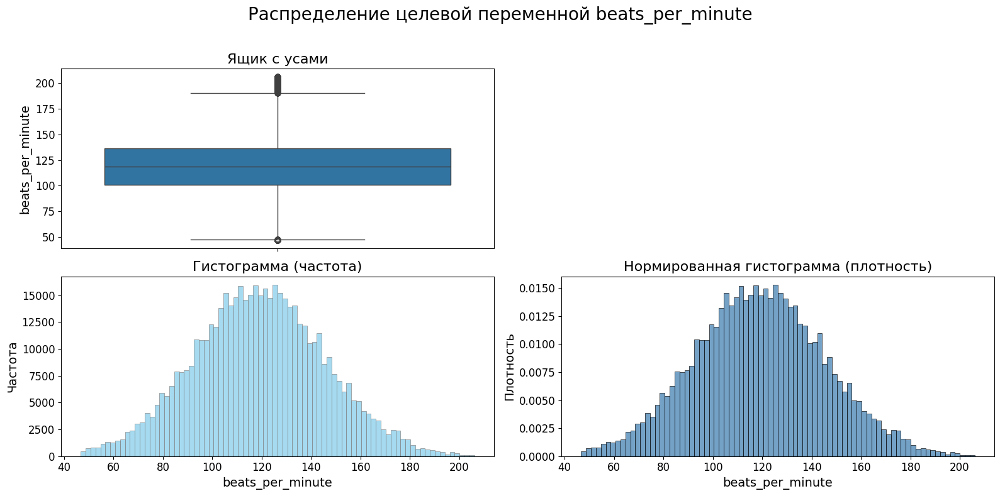

In [27]:
plot_box_and_hist_target(df_train, feature='beats_per_minute',
                            title='Распределение целевой переменной beats_per_minute')

Гистограмма и boxplot показали, что распределение целевой переменной практически является нормальным

Есть концентрация значений в диапазоне 90–150 BPM, что соответствует типичным темпам популярных жанров.

Среднее (119.035) ≈ Медиана (118.748) → распределение симметричное

__Диапазон значений:__
- Минимум: 46.72 BPM — очень медленные треки (медленные баллады, ambient)
- Максимум: 206.04 BPM — очень быстрые треки (drum & bass, hardcore)
- Типичный диапазон: 101-137 BPM (50% данных в IQR)

__Музыкальная интерпретация:__
- меньще 90 BPM: Медленные треки (баллады, downtempo, hip-hop)
- 90-120 BPM: Средний темп (pop, rock, reggae)
- 120-140 BPM: Танцевальная музыка (house, techno)
- большге 140 BPM: Быстрая музыка (drum & bass, hardstyle)

### Распределение количетсвенных признаков

In [28]:
df_train.describe().T

,count,mean,std,min,25%,50%,75%,max
id,524164.0,262081.500000,151313.257587,0.000000,131040.750000,262081.500000,393122.250000,524163.000000
rhythm_score,524164.0,0.632843,0.156899,0.076900,0.515850,0.634686,0.739179,0.975000
audio_loudness,524164.0,-8.379014,4.616221,-27.509725,-11.551933,-8.252499,-4.912298,-1.357000
vocal_content,524164.0,0.074443,0.049939,0.023500,0.023500,0.066425,0.107343,0.256401
acoustic_quality,524164.0,0.262913,0.223120,0.000005,0.069413,0.242502,0.396957,0.995000
instrumental_score,524164.0,0.117690,0.131845,0.000001,0.000001,0.074247,0.204065,0.869258
live_performance_likelihood,524164.0,0.178398,0.118186,0.024300,0.077637,0.166327,0.268946,0.599924
mood_score,524164.0,0.555843,0.225480,0.025600,0.403921,0.564817,0.716633,0.978000
track_duration_ms,524164.0,241903.692949,59326.601501,63973.000000,207099.876625,243684.058150,281851.658500,464723.228100
energy,524164.0,0.500923,0.289952,0.000067,0.254933,0.511800,0.746000,1.000000


In [29]:
df_test.describe().T

,count,mean,std,min,25%,50%,75%,max
id,174722.0,611524.500000,50438.041204,524164.000000,567844.250000,611524.500000,655204.750000,698885.000000
rhythm_score,174722.0,0.632591,0.157229,0.140859,0.514918,0.634556,0.739179,0.975000
audio_loudness,174722.0,-8.377495,4.622288,-27.442731,-11.550095,-8.253186,-4.903740,-1.357000
vocal_content,174722.0,0.074475,0.050024,0.023500,0.023500,0.066432,0.107302,0.258857
acoustic_quality,174722.0,0.262903,0.222899,0.000005,0.069448,0.242412,0.396870,0.995000
instrumental_score,174722.0,0.117407,0.131628,0.000001,0.000001,0.073968,0.202977,0.680914
live_performance_likelihood,174722.0,0.178317,0.118165,0.024300,0.077821,0.165956,0.268133,0.599544
mood_score,174722.0,0.555861,0.226218,0.025600,0.403788,0.566015,0.716694,0.978000
track_duration_ms,174722.0,241753.736419,59103.896616,63973.000000,207518.151300,243584.585400,281737.445300,449288.808400
energy,174722.0,0.500545,0.290550,0.000067,0.253817,0.511867,0.746133,0.999867


In [30]:
def compare_box_and_hist(df_train, df_test, feature='rhythm_score', title=None, bins=60):
    # Удаляем пропуски
    train_clean = df_train[[feature]].dropna()
    test_clean = df_test[[feature]].dropna()

    # Общая статистика
    print(f"\n📊 Статистика по признаку '{feature}':")
    print("Train:")
    print(train_clean[feature].describe())
    print("\nTest:")
    print(test_clean[feature].describe())

    # Заголовок графика
    if title is None:
        title = f'Сравнение распределения признака "{feature}" между train и test'

    # Создаём сетку 2 строки × 2 столбца
    fig, axes = plt.subplots(2, 2, figsize=(16, 8))
    fig.suptitle(title, fontsize=20)

    # Ящики с усами — первая строка
    sns.boxplot(data=pd.concat([
        train_clean.assign(dataset='train'),
        test_clean.assign(dataset='test')
    ]), x='dataset', y=feature, ax=axes[0, 0], palette='Set2')

    axes[0, 0].set_title('Ящики с усами (train vs test)', fontsize=16)
    axes[0, 0].set_xlabel('Датасет', fontsize=14)
    axes[0, 0].set_ylabel(feature, fontsize=14)
    axes[0, 0].tick_params(axis='x', labelsize=12)
    axes[0, 0].tick_params(axis='y', labelsize=12)

    # Отключаем вторую ячейку в первой строке
    axes[0, 1].axis('off')

    # Гистограмма частоты — вторая строка, слева
    sns.histplot(train_clean[feature], bins=bins, color='skyblue', label='train',
                 edgecolor='gray', ax=axes[1, 0], alpha=0.6)
    sns.histplot(test_clean[feature], bins=bins, color='salmon', label='test',
                 edgecolor='gray', ax=axes[1, 0], alpha=0.6)

    axes[1, 0].set_title('Гистограмма (частота)', fontsize=16)
    axes[1, 0].set_xlabel(feature, fontsize=14)
    axes[1, 0].set_ylabel('Частота', fontsize=14)
    axes[1, 0].tick_params(axis='x', labelsize=12)
    axes[1, 0].tick_params(axis='y', labelsize=12)
    axes[1, 0].legend()

    # Гистограмма плотности — вторая строка, справа
    sns.histplot(train_clean[feature], bins=bins, stat='density', color='steelblue',
                 label='train', ax=axes[1, 1], alpha=0.6)
    sns.histplot(test_clean[feature], bins=bins, stat='density', color='tomato',
                 label='test', ax=axes[1, 1], alpha=0.6)

    axes[1, 1].set_title('Нормированная гистограмма (плотность)', fontsize=16)
    axes[1, 1].set_xlabel(feature, fontsize=14)
    axes[1, 1].set_ylabel('Плотность', fontsize=14)
    axes[1, 1].tick_params(axis='x', labelsize=12)
    axes[1, 1].tick_params(axis='y', labelsize=12)
    axes[1, 1].legend()

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

#### rhythm_score


📊 Статистика по признаку 'rhythm_score':
Train:
count    524164.000000
mean          0.632843
std           0.156899
min           0.076900
25%           0.515850
50%           0.634686
75%           0.739179
max           0.975000
Name: rhythm_score, dtype: float64

Test:
count    174722.000000
mean          0.632591
std           0.157229
min           0.140859
25%           0.514918
50%           0.634556
75%           0.739179
max           0.975000
Name: rhythm_score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_26584\1661695163.py:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=pd.concat([


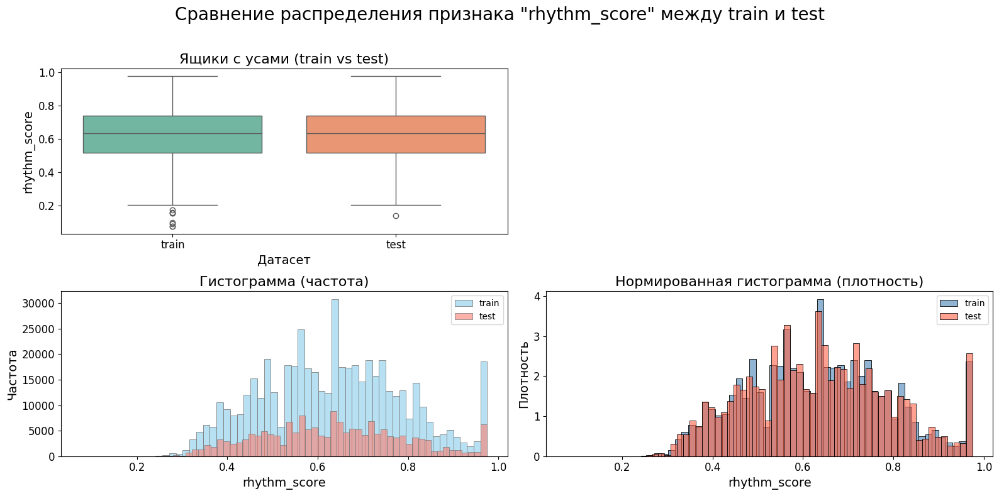

In [31]:
compare_box_and_hist(df_train, df_test, feature='rhythm_score')

In [32]:
df_train['rhythm_score'].value_counts()

0.975000    18049
0.738937      280
0.638250      279
0.638249      216
0.722651      204
            ...  
0.661617        1
0.590724        1
0.817306        1
0.531627        1
0.796831        1
Name: rhythm_score, Length: 322528, dtype: int64

In [33]:
top_value = df_train['rhythm_score'].value_counts().idxmax()
top_count = df_train['rhythm_score'].value_counts().max()
percentage = (top_count / len(df_train)) * 100

print(f"Значение {top_value} встречается {top_count} раз ({percentage:.2f}%) от всего датасета.")

Значение 0.975 встречается 18049 раз (3.44%) от всего датасета.


📊 rhythm_score (Ритмичность)
- Распределение: близко к нормальному, небольшая левосторонняя асимметрия
- Диапазон: 0.077 - 0.975
- Пик: около 0.63-0.64
- Интерпретация: большинство треков имеют среднюю или высокую ритмичность

#### mood_score


📊 Статистика по признаку 'mood_score':
Train:
count    524164.000000
mean          0.555843
std           0.225480
min           0.025600
25%           0.403921
50%           0.564817
75%           0.716633
max           0.978000
Name: mood_score, dtype: float64

Test:
count    174722.000000
mean          0.555861
std           0.226218
min           0.025600
25%           0.403788
50%           0.566015
75%           0.716694
max           0.978000
Name: mood_score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_26584\1661695163.py:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=pd.concat([


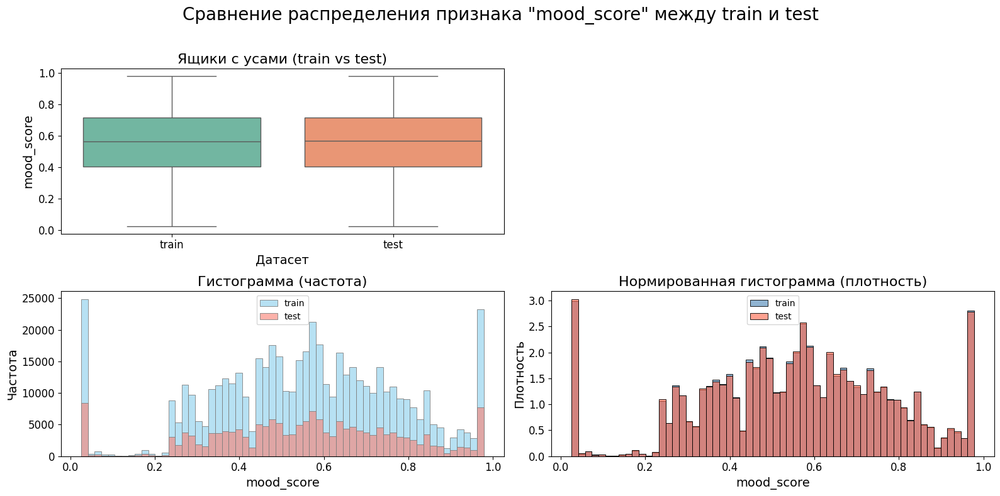

In [34]:
compare_box_and_hist(df_train, df_test, feature='mood_score')

In [35]:
df_train['mood_score'].value_counts()

0.025600    24356
0.978000    21776
0.844479      289
0.555920      205
0.633986      200
            ...  
0.688089        1
0.508846        1
0.416988        1
0.917087        1
0.586868        1
Name: mood_score, Length: 306504, dtype: int64

In [36]:
top2_values = df_train['mood_score'].value_counts().head(2).index.tolist()
print("Два самых частых значения:", top2_values)

Два самых частых значения: [0.0256, 0.978]


#### energy


📊 Статистика по признаку 'energy':
Train:
count    524164.000000
mean          0.500923
std           0.289952
min           0.000067
25%           0.254933
50%           0.511800
75%           0.746000
max           1.000000
Name: energy, dtype: float64

Test:
count    174722.000000
mean          0.500545
std           0.290550
min           0.000067
25%           0.253817
50%           0.511867
75%           0.746133
max           0.999867
Name: energy, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_26584\1661695163.py:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=pd.concat([


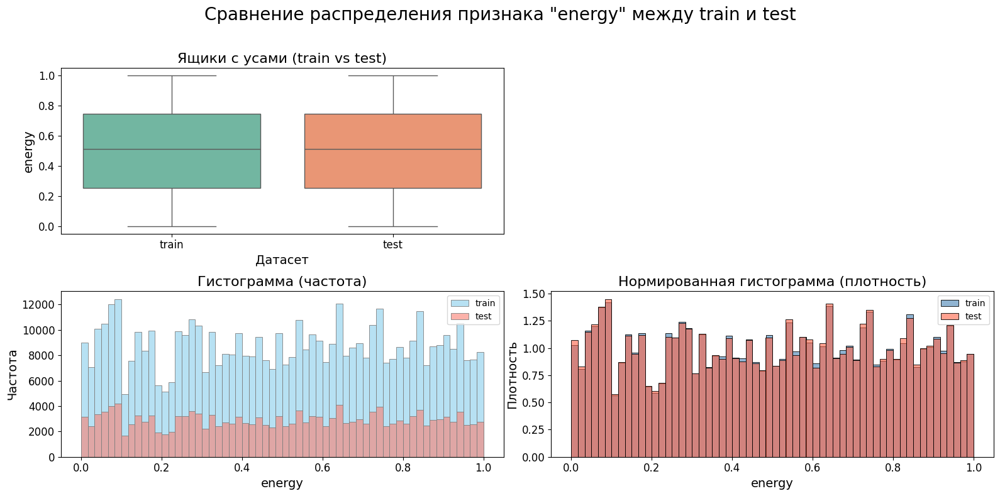

In [37]:
compare_box_and_hist(df_train, df_test, feature='energy')

In [38]:
df_train['energy'].value_counts()

0.515467    436
0.542133    371
0.547467    337
0.516467    327
0.908333    319
           ... 
0.744107      1
0.966987      1
0.431400      1
0.164133      1
0.446433      1
Name: energy, Length: 11606, dtype: int64

📊 energy (Энергичность)
- Распределение: близко к равномерному (uniform)
- Диапазон: 0.000067 - 1.0
- треки равномерно распределены по уровню энергичности

- rhythm_score, energy, mood_score — распределены в диапазоне [0,1], с пиками около 0 и 1 (характерно для синтетических данных).

#### audio_loudness


📊 Статистика по признаку 'audio_loudness':
Train:
count    524164.000000
mean         -8.379014
std           4.616221
min         -27.509725
25%         -11.551933
50%          -8.252499
75%          -4.912298
max          -1.357000
Name: audio_loudness, dtype: float64

Test:
count    174722.000000
mean         -8.377495
std           4.622288
min         -27.442731
25%         -11.550095
50%          -8.253186
75%          -4.903740
max          -1.357000
Name: audio_loudness, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_26584\1661695163.py:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=pd.concat([


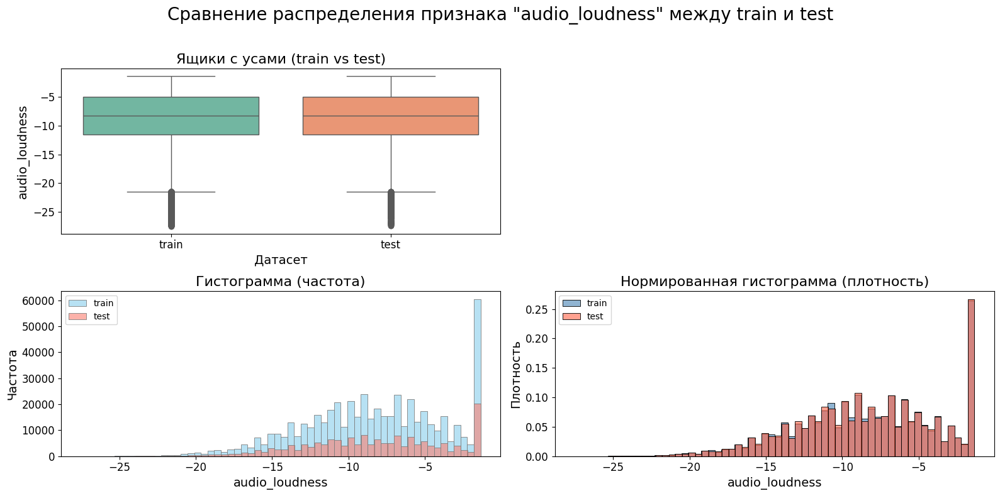

In [39]:
compare_box_and_hist(df_train, df_test, feature='audio_loudness')

In [40]:
df_train['audio_loudness'].value_counts()

-1.357000     57595
-8.914199       156
-8.846292       150
-10.670711      146
-11.878234      144
              ...  
-12.078783        1
-9.868259         1
-10.569142        1
-3.567731         1
-12.132914        1
Name: audio_loudness, Length: 310411, dtype: int64

In [41]:
top_value = df_train['audio_loudness'].value_counts().idxmax()
top_count = df_train['audio_loudness'].value_counts().max()
percentage = (top_count / len(df_train)) * 100

print(f"Значение {top_value} встречается {top_count} раз ({percentage:.2f}%) от всего датасета.")

Значение -1.357 встречается 57595 раз (10.99%) от всего датасета.


📊 audio_loudness (Громкость в dB)
- Диапазон: -27.5 до -1.357 dB
- ⚠️ Артефакт: максимальное значение -1.357 dB повторяется часто (видно на гистограмме резкий пик справа)
  - возможно это пороговое значение при генерации синтетических данных

- audio_loudness — отрицательные значения (в дБ), распределение смещено влево, есть выбросы ниже -20 дБ.

#### vocal_content


📊 Статистика по признаку 'vocal_content':
Train:
count    524164.000000
mean          0.074443
std           0.049939
min           0.023500
25%           0.023500
50%           0.066425
75%           0.107343
max           0.256401
Name: vocal_content, dtype: float64

Test:
count    174722.000000
mean          0.074475
std           0.050024
min           0.023500
25%           0.023500
50%           0.066432
75%           0.107302
max           0.258857
Name: vocal_content, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_26584\1661695163.py:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=pd.concat([


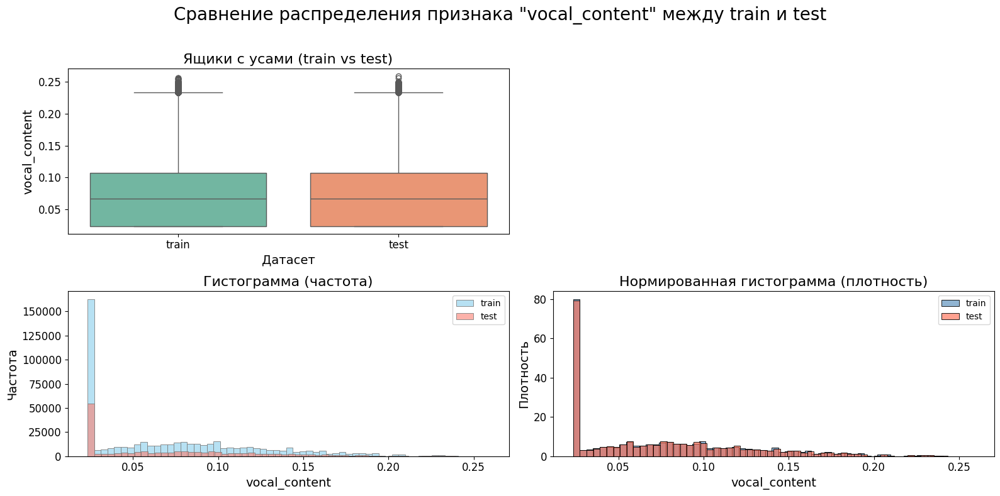

In [42]:
compare_box_and_hist(df_train, df_test, feature='vocal_content')

In [43]:
df_train['vocal_content'].value_counts()

0.023500    158867
0.098117       223
0.077498       198
0.078111       188
0.085194       183
             ...  
0.087048         1
0.103030         1
0.081798         1
0.065457         1
0.071390         1
Name: vocal_content, Length: 229305, dtype: int64

In [44]:
top_value = df_train['vocal_content'].value_counts().idxmax()
top_count = df_train['vocal_content'].value_counts().max()
percentage = (top_count / len(df_train)) * 100

print(f"Значение {top_value} встречается {top_count} раз ({percentage:.2f}%) от всего датасета.")

Значение 0.0235 встречается 158867 раз (30.31%) от всего датасета.


📊 vocal_content (Доля вокала)
- Распределение: сильно правоскошенное (right-skewed)
- Медиана: 0.0664
- ⚠️ Артефакт: огромный пик на 0.0235 (минимальное значение)
  - 25% квантиль = 0.0235 → четверть всех треков имеют минимальный вокальный контент
  - возможно много инструментальных/преимущественно инструментальных треков

#### acoustic_quality


📊 Статистика по признаку 'acoustic_quality':
Train:
count    524164.000000
mean          0.262913
std           0.223120
min           0.000005
25%           0.069413
50%           0.242502
75%           0.396957
max           0.995000
Name: acoustic_quality, dtype: float64

Test:
count    174722.000000
mean          0.262903
std           0.222899
min           0.000005
25%           0.069448
50%           0.242412
75%           0.396870
max           0.995000
Name: acoustic_quality, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_26584\1661695163.py:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=pd.concat([


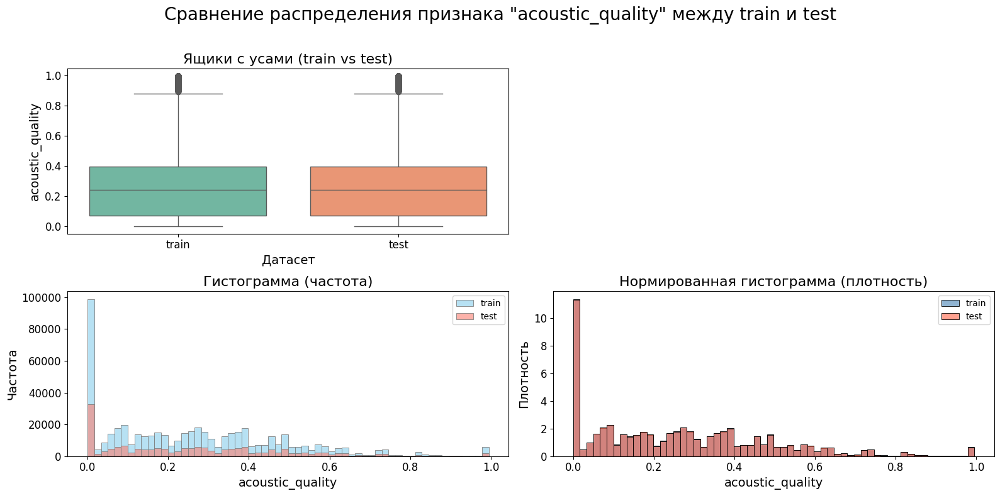

In [45]:
compare_box_and_hist(df_train, df_test, feature='acoustic_quality')

In [46]:
df_train['acoustic_quality'].value_counts()

0.000005    88718
0.995000     5609
0.738882      177
0.167737      169
0.079679      168
            ...  
0.484578        1
0.193093        1
0.676714        1
0.508851        1
0.168978        1
Name: acoustic_quality, Length: 270478, dtype: int64

In [47]:
top_value = df_train['acoustic_quality'].value_counts().idxmax()
top_count = df_train['acoustic_quality'].value_counts().max()
percentage = (top_count / len(df_train)) * 100

print(f"Значение {top_value} встречается {top_count} раз ({percentage:.2f}%) от всего датасета.")

Значение 5.36e-06 встречается 88718 раз (16.93%) от всего датасета.


📊 acoustic_quality (Акустичность)
- Распределение: правоскошенное, мультимодальное
- Диапазон: 0.000005 - 0.995
- ⚠️ Артефакт: минимум 0.000005 (замена нулей?)
  - большинство треков имеют низкую/среднюю акустичность (электронные инструменты)

#### instrumental_score


📊 Статистика по признаку 'instrumental_score':
Train:
count    524164.000000
mean          0.117690
std           0.131845
min           0.000001
25%           0.000001
50%           0.074247
75%           0.204065
max           0.869258
Name: instrumental_score, dtype: float64

Test:
count    174722.000000
mean          0.117407
std           0.131628
min           0.000001
25%           0.000001
50%           0.073968
75%           0.202977
max           0.680914
Name: instrumental_score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_26584\1661695163.py:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=pd.concat([


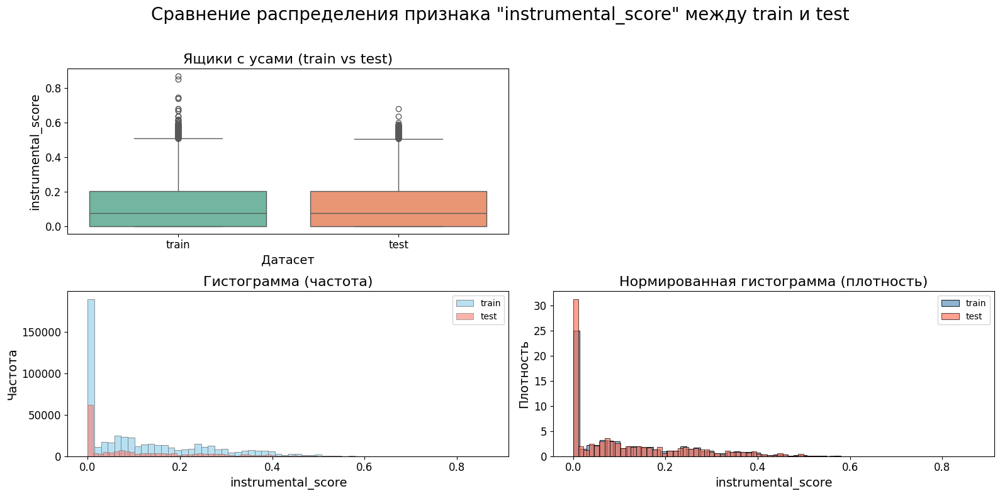

In [48]:
compare_box_and_hist(df_train, df_test, feature='instrumental_score')

In [49]:
df_train['instrumental_score'].value_counts()

0.000001    173669
0.098952       339
0.010720       308
0.064443       275
0.098952       196
             ...  
0.292656         1
0.262811         1
0.117826         1
0.246898         1
0.262320         1
Name: instrumental_score, Length: 218979, dtype: int64

In [50]:
top_value = df_train['instrumental_score'].value_counts().idxmax()
top_count = df_train['instrumental_score'].value_counts().max()
percentage = (top_count / len(df_train)) * 100

print(f"Значение {top_value} встречается {top_count} раз ({percentage:.2f}%) от всего датасета.")

Значение 1.07e-06 встречается 173669 раз (33.13%) от всего датасета.


📊 instrumental_score (Инструментальность)
- Распределение: экстремально правоскошенное
- ⚠️ Артефакт: огромный пик на 0.000001 (25% квантиль = 0.000001)
  - четверть треков классифицированы как "почти без инструментов" (вокальные треки)

- vocal_content, instrumental_score, acoustic_quality — большинство значений близки к 0, но есть отдельные пики.

#### live_performance_likelihood


📊 Статистика по признаку 'live_performance_likelihood':
Train:
count    524164.000000
mean          0.178398
std           0.118186
min           0.024300
25%           0.077637
50%           0.166327
75%           0.268946
max           0.599924
Name: live_performance_likelihood, dtype: float64

Test:
count    174722.000000
mean          0.178317
std           0.118165
min           0.024300
25%           0.077821
50%           0.165956
75%           0.268133
max           0.599544
Name: live_performance_likelihood, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_26584\1661695163.py:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=pd.concat([


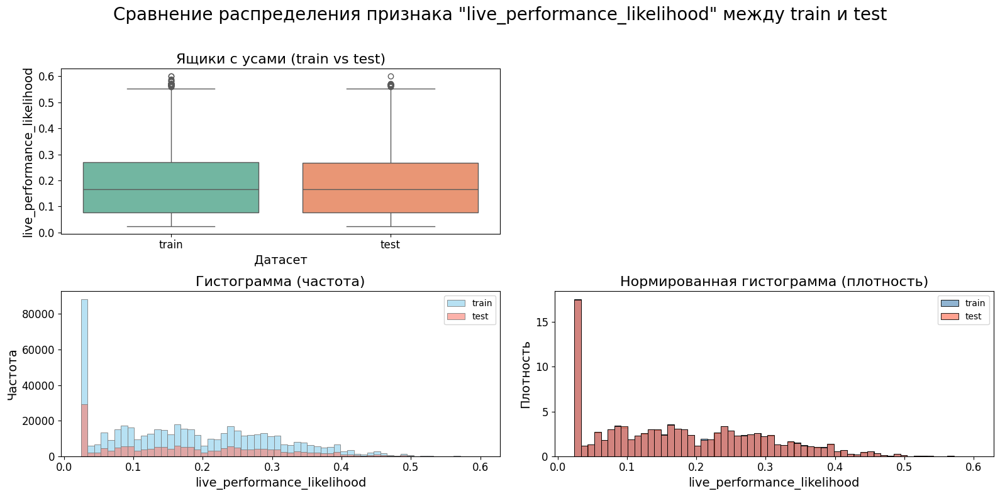

In [51]:
compare_box_and_hist(df_train, df_test, feature='live_performance_likelihood')

In [52]:
df_train['live_performance_likelihood'].value_counts()

0.024300    84241
0.292476      224
0.221400      200
0.085997      170
0.095679      163
            ...  
0.350032        1
0.240728        1
0.137095        1
0.185069        1
0.287963        1
Name: live_performance_likelihood, Length: 279591, dtype: int64

In [53]:
top_value = df_train['live_performance_likelihood'].value_counts().idxmax()
top_count = df_train['live_performance_likelihood'].value_counts().max()
percentage = (top_count / len(df_train)) * 100

print(f"Значение {top_value} встречается {top_count} раз ({percentage:.2f}%) от всего датасета.")

Значение 0.0243 встречается 84241 раз (16.07%) от всего датасета.


📊 live_performance_likelihood (Вероятность живой записи)
- Распределение: правоскошенное
- ⚠️ Артефакт: минимум 0.0243 повторяется часто
   - большинство треков — студийные записи

#### track_duration_ms


📊 Статистика по признаку 'track_duration_ms':
Train:
count    524164.000000
mean     241903.692949
std       59326.601501
min       63973.000000
25%      207099.876625
50%      243684.058150
75%      281851.658500
max      464723.228100
Name: track_duration_ms, dtype: float64

Test:
count    174722.000000
mean     241753.736419
std       59103.896616
min       63973.000000
25%      207518.151300
50%      243584.585400
75%      281737.445300
max      449288.808400
Name: track_duration_ms, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_26584\1661695163.py:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=pd.concat([


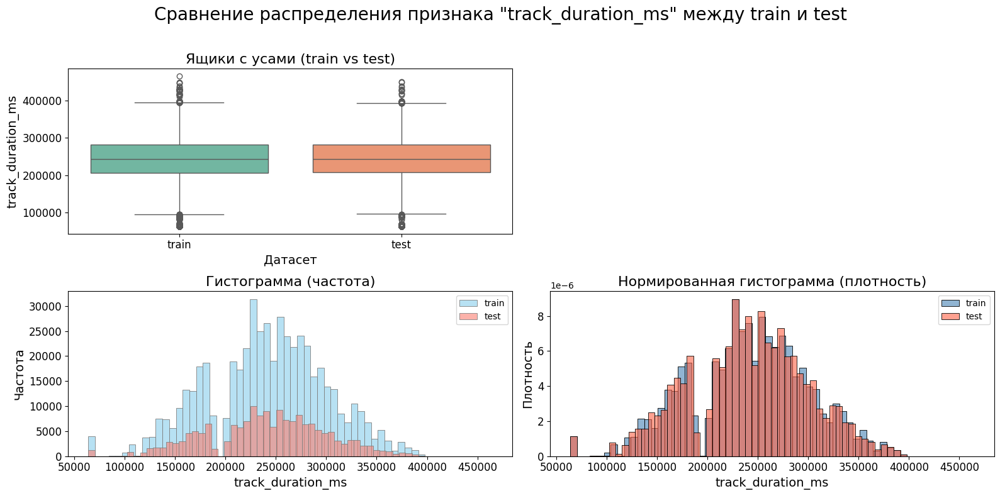

In [54]:
compare_box_and_hist(df_train, df_test, feature='track_duration_ms')

📊 track_duration_ms (Длительность трека)
- Среднее: 241,904 мс ≈ 4 минуты 2 секунды
- Диапазон: 64 сек - 7.7 мин
-  стандартная длительность поп-треков (3-5 минут)

- track_duration_ms — сильно варьируется (от ~60 тыс. до >350 тыс. мс, т.е. от 1 до 6 минут). Есть длинный хвост, что указывает на выбросы (очень длинные треки).

__Распределения train и test очень схожи - нет смещения данных__
- Train/test split выполнен корректно
- Нет систематических различий между выборками
- Модель, обученная на train, будет адекватно работать на test

### Анализ артефактов признаков

In [55]:
# Подсчет частоты артефактов
artifacts = {
    'audio_loudness == -1.357': (df_train['audio_loudness'] == -1.357).sum(),
    'vocal_content == 0.0235': (df_train['vocal_content'] == 0.0235).sum(),
    'instrumental_score == 0.000001': (df_train['instrumental_score'] == 0.000001).sum(),
    'acoustic_quality == 0.000005': (df_train['acoustic_quality'] == 0.000005).sum(),
    'live_performance_likelihood == 0.0243': (df_train['live_performance_likelihood'] == 0.0243).sum()
}

# Процентное соотношение
for artifact, count in artifacts.items():
    percentage = (count / len(df_train)) * 100
    print(f"{artifact}: {count:,} ({percentage:.2f}%)")

audio_loudness == -1.357: 57,595 (10.99%)
vocal_content == 0.0235: 158,867 (30.31%)
instrumental_score == 0.000001: 0 (0.00%)
acoustic_quality == 0.000005: 0 (0.00%)
live_performance_likelihood == 0.0243: 84,241 (16.07%)


In [56]:
# Анализ BPM для треков с артефактами
artifacts_analysis = {}
for artifact_condition in [
    df_train['audio_loudness'] == -1.357,
    df_train['vocal_content'] == 0.0235,
    df_train['live_performance_likelihood'] == 0.0243
]:
    artifact_bpm = df_train[artifact_condition]['beats_per_minute']
    artifacts_analysis[artifact_condition.name] = {
        'mean_bpm': artifact_bpm.mean(),
        'std_bpm': artifact_bpm.std(),
        'count': len(artifact_bpm)
    }

print("Анализ BPM для треков с артефактами:")
pd.DataFrame(artifacts_analysis).T

Анализ BPM для треков с артефактами:


,mean_bpm,std_bpm,count
audio_loudness,118.861311,26.441470,57595.0
vocal_content,119.013278,26.496388,158867.0
live_performance_likelihood,118.669427,26.586694,84241.0


In [57]:
# Треки с артефактом audio_loudness = -1.357
artifact_loudness = df_train[df_train['audio_loudness'] == -1.357]['beats_per_minute']
clean_loudness = df_train[df_train['audio_loudness'] != -1.357]['beats_per_minute']

print(f"\nAudio Loudness = -1.357:")
print(f"  С артефактом: mean={artifact_loudness.mean():.2f}, std={artifact_loudness.std():.2f}")
print(f"  Без артефакта: mean={clean_loudness.mean():.2f}, std={clean_loudness.std():.2f}")


# Аналогично для vocal_content = 0.0235
artifact_vocal = df_train[df_train['vocal_content'] == 0.0235]['beats_per_minute']
clean_vocal = df_train[df_train['vocal_content'] != 0.0235]['beats_per_minute']

print(f"\nVocal Content = 0.0235:")
print(f"  С артефактом: mean={artifact_vocal.mean():.2f}, std={artifact_vocal.std():.2f}")
print(f"  Без артефакта: mean={clean_vocal.mean():.2f}, std={clean_vocal.std():.2f}")

# Для live_performance_likelihood = 0.000001
artifact_lpl = df_train[df_train['live_performance_likelihood'] == 0.0243]['beats_per_minute']
clean_lpl = df_train[df_train['live_performance_likelihood'] != 0.0243]['beats_per_minute']

print(f"\nlive_performance_likelihood = 0.000001:")
print(f"  С артефактом: mean={artifact_lpl.mean():.2f}, std={artifact_lpl.std():.2f}")
print(f"  Без артефакта: mean={clean_lpl.mean():.2f}, std={clean_lpl.std():.2f}")


Audio Loudness = -1.357:
  С артефактом: mean=118.86, std=26.44
  Без артефакта: mean=119.06, std=26.47

Vocal Content = 0.0235:
  С артефактом: mean=119.01, std=26.50
  Без артефакта: mean=119.04, std=26.46

live_performance_likelihood = 0.000001:
  С артефактом: mean=118.67, std=26.59
  Без артефакта: mean=119.10, std=26.44


- Артефакты не влияют на BPM - средние значения BPM практически идентичны в обоих случаях

### Анализ возможных выбросов признаков

In [58]:
# Количественный анализ выбросов по IQR
def detect_outliers_iqr(df, feature):
    Q1 = df[feature].quantile(0.25)
    Q3 = df[feature].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = df[(df[feature] < lower_bound) | (df[feature] > upper_bound)]
    return len(outliers), lower_bound, upper_bound

# Анализ выбросов для всех признаков
features = df_train.columns.drop(['id', 'beats_per_minute'])
outlier_analysis = {}
for feature in features:
    n_outliers, lower, upper = detect_outliers_iqr(df_train, feature)
    outlier_analysis[feature] = {
        'n_outliers': n_outliers,
        'percentage': (n_outliers / len(df_train)) * 100,
        'bounds': (lower, upper)
    }

outlier_df = pd.DataFrame(outlier_analysis).T
print("Анализ выбросов по признакам:")
outlier_df.sort_values('percentage', ascending=False)

Анализ выбросов по признакам:


,n_outliers,percentage,bounds
acoustic_quality,6746,1.287002,"(-0.4219021464999999, 0.8882718334999999)"
track_duration_ms,4267,0.814058,"(94972.20381249998, 393979.33131250006)"
instrumental_score,2845,0.542769,"(-0.30609556450000003, 0.5101621275)"
audio_loudness,1770,0.337681,"(-21.51138563525, 5.04715399875)"
vocal_content,1245,0.237521,"(-0.102264298625, 0.23310716437499998)"
live_performance_likelihood,129,0.024611,"(-0.20932657187499998, 0.555909895125)"
rhythm_score,8,0.001526,"(0.18085502050000002, 1.0741737845000001)"
mood_score,0,0.0,"(-0.06514701687500013, 1.1857004021250002)"
energy,0,0.0,"(-0.4816666675, 1.4826000005)"


- Большинство признаков имеют <1% выбросов
- Но это теоретический подход к определению выбросов и не факт что они ими являются

### Анализ категоризированного BPM

- создадим категориальный признак для BPM


📊 Распределение категорий BPM:
Medium (90-120)     198857
Fast (120-140)      140224
Very Fast (>140)    112618
Slow (<90)           72465
Name: bpm_category, dtype: int64

📈 Процентное распределение:
Medium (90-120)     37.94
Fast (120-140)      26.75
Very Fast (>140)    21.49
Slow (<90)          13.82
Name: bpm_category, dtype: float64


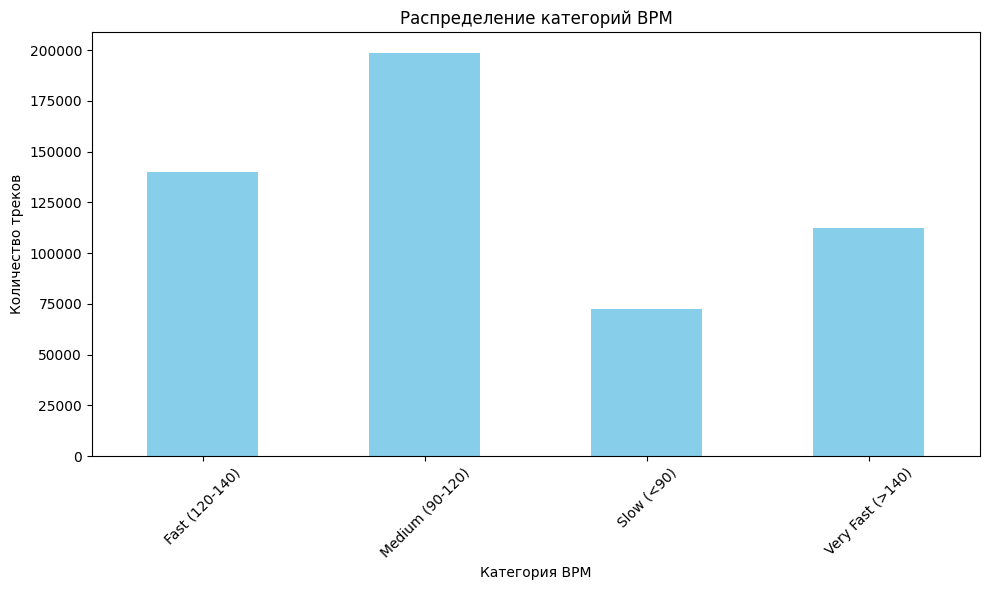


📌 Средние значения признаков по категориям BPM:


,energy,rhythm_score,audio_loudness,track_duration_ms,vocal_content,mood_score,acoustic_quality,instrumental_score,live_performance_likelihood
bpm_category,,,,,,,,,
Fast (120-140),0.5014,0.6339,-8.3648,242296.6670,0.0747,0.5577,0.2627,0.1186,0.1787
Medium (90-120),0.4982,0.6323,-8.3879,241895.7359,0.0743,0.5552,0.2640,0.1171,0.1784
Slow (<90),0.5078,0.6312,-8.3513,240681.7244,0.0740,0.5521,0.2615,0.1173,0.1773
Very Fast (>140),0.5007,0.6336,-8.3989,242214.7255,0.0746,0.5571,0.2622,0.1178,0.1788



📌 Медианные значения признаков по категориям BPM:


,energy,rhythm_score,audio_loudness,track_duration_ms,vocal_content,mood_score,acoustic_quality,instrumental_score,live_performance_likelihood
bpm_category,,,,,,,,,
Fast (120-140),0.5138,0.6362,-8.2437,244364.6337,0.0667,0.5662,0.2428,0.0749,0.1668
Medium (90-120),0.5062,0.6342,-8.2560,243623.1398,0.0661,0.5643,0.2430,0.0741,0.1659
Slow (<90),0.5179,0.6340,-8.2459,242461.8583,0.0658,0.5633,0.2416,0.0727,0.1655
Very Fast (>140),0.5098,0.6361,-8.2562,243929.4942,0.0670,0.5662,0.2417,0.0744,0.1667


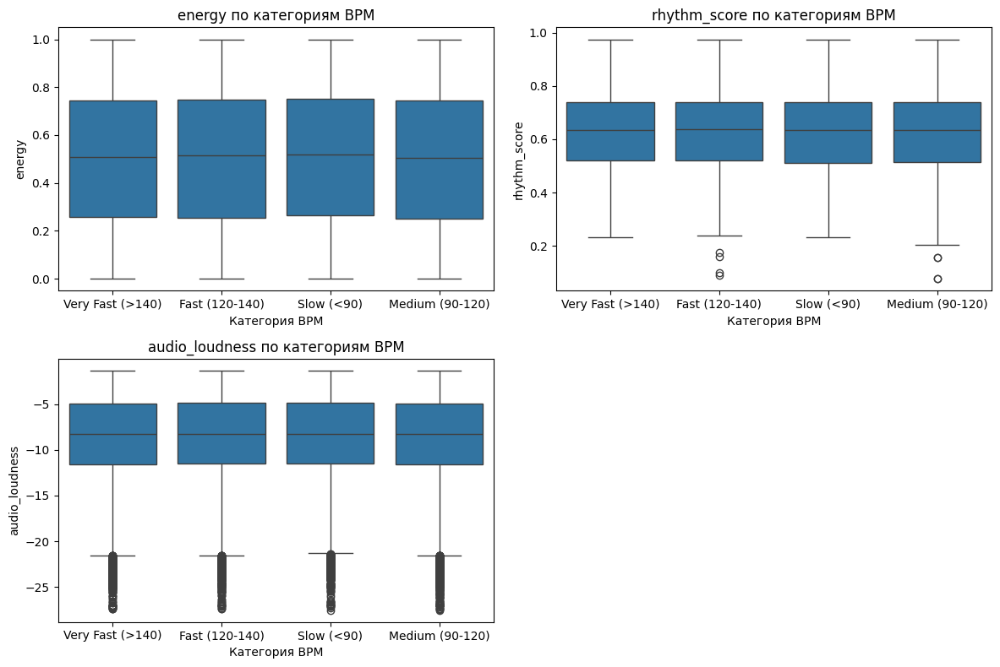

In [59]:
# Создание категорий BPM
def categorize_bpm(bpm):
    if bpm < 90:
        return 'Slow (<90)'
    elif bpm < 120:
        return 'Medium (90-120)'
    elif bpm < 140:
        return 'Fast (120-140)'
    else:
        return 'Very Fast (>140)'

# Применение категории
df_train['bpm_category'] = df_train['beats_per_minute'].apply(categorize_bpm)

# Распределение категорий
print("\n📊 Распределение категорий BPM:")
print(df_train['bpm_category'].value_counts())
print("\n📈 Процентное распределение:")
print(df_train['bpm_category'].value_counts(normalize=True).round(4) * 100)

# Barplot по категориям
plt.figure(figsize=(10, 6))
df_train['bpm_category'].value_counts().sort_index().plot(kind='bar', color='skyblue')
plt.title('Распределение категорий BPM')
plt.xlabel('Категория BPM')
plt.ylabel('Количество треков')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# 📌 Средние значения признаков по категориям BPM
mean_stats = df_train.groupby('bpm_category').agg({
    'energy': 'mean',
    'rhythm_score': 'mean',
    'audio_loudness': 'mean',
    'track_duration_ms': 'mean',
    'vocal_content': 'mean',
    'mood_score': 'mean',
    'acoustic_quality': 'mean',
    'instrumental_score': 'mean',
    'live_performance_likelihood': 'mean'
}).round(4)

print("\n📌 Средние значения признаков по категориям BPM:")
display(mean_stats)

# 📌 Медианные значения признаков по категориям BPM
median_stats = df_train.groupby('bpm_category').agg({
    'energy': 'median',
    'rhythm_score': 'median',
    'audio_loudness': 'median',
    'track_duration_ms': 'median',
    'vocal_content': 'median',
    'mood_score': 'median',
    'acoustic_quality': 'median',
    'instrumental_score': 'median',
    'live_performance_likelihood': 'median'
}).round(4)

print("\n📌 Медианные значения признаков по категориям BPM:")
display(median_stats)

# Boxplot по признакам
plt.figure(figsize=(12, 8))
for i, feature in enumerate(['energy', 'rhythm_score', 'audio_loudness']):
    plt.subplot(2, 2, i+1)
    sns.boxplot(data=df_train, x='bpm_category', y=feature)
    plt.title(f'{feature} по категориям BPM')
    plt.xlabel('Категория BPM')
    plt.ylabel(feature)
plt.tight_layout()
plt.show()

In [60]:
# 📌 Средние и дисперсии признаков по категориям BPM
mean_var_stats = df_train.groupby('bpm_category').agg({
    'energy': ['mean', 'var'],
    'rhythm_score': ['mean', 'var'],
    'audio_loudness': ['mean', 'var'],
    'track_duration_ms': ['mean', 'var'],
    'vocal_content': ['mean', 'var'],
    'mood_score': ['mean', 'var'],
    'acoustic_quality': ['mean', 'var'],
    'instrumental_score': ['mean', 'var'],
    'live_performance_likelihood': ['mean', 'var']
}).round(4)

# Переименование колонок для читаемости
mean_var_stats.columns = [f'{col}_{stat}' for col, stat in mean_var_stats.columns]

print("\n📌 Средние значения и дисперсии признаков по категориям BPM:")
display(mean_var_stats.iloc[:,:6])
display(mean_var_stats.iloc[:,6:12])
display(mean_var_stats.iloc[:,12:16])
display(mean_var_stats.iloc[:,16:19])


📌 Средние значения и дисперсии признаков по категориям BPM:


,energy_mean,energy_var,rhythm_score_mean,rhythm_score_var,audio_loudness_mean,audio_loudness_var
bpm_category,,,,,,
Fast (120-140),0.5014,0.0843,0.6339,0.0245,-8.3648,21.3312
Medium (90-120),0.4982,0.0843,0.6323,0.0247,-8.3879,21.3427
Slow (<90),0.5078,0.0834,0.6312,0.0248,-8.3513,21.1710
Very Fast (>140),0.5007,0.0836,0.6336,0.0246,-8.3989,21.3122


,track_duration_ms_mean,track_duration_ms_var,vocal_content_mean,vocal_content_var,mood_score_mean,mood_score_var
bpm_category,,,,,,
Fast (120-140),242296.6670,3.517444e+09,0.0747,0.0025,0.5577,0.0512
Medium (90-120),241895.7359,3.500268e+09,0.0743,0.0025,0.5552,0.0507
Slow (<90),240681.7244,3.567973e+09,0.0740,0.0025,0.5521,0.0504
Very Fast (>140),242214.7255,3.524350e+09,0.0746,0.0025,0.5571,0.0510


,acoustic_quality_mean,acoustic_quality_var,instrumental_score_mean,instrumental_score_var
bpm_category,,,,
Fast (120-140),0.2627,0.0497,0.1186,0.0175
Medium (90-120),0.2640,0.0499,0.1171,0.0173
Slow (<90),0.2615,0.0501,0.1173,0.0175
Very Fast (>140),0.2622,0.0494,0.1178,0.0174


,live_performance_likelihood_mean,live_performance_likelihood_var
bpm_category,,
Fast (120-140),0.1787,0.0139
Medium (90-120),0.1784,0.0140
Slow (<90),0.1773,0.0140
Very Fast (>140),0.1788,0.0139


In [61]:
# 📌 Гипотезы ANOVA
print("\n🧪 ANOVA-тест: проверка различий между группами bpm_category")
print("H₀ (нулевая гипотеза): средние значения признака одинаковы во всех группах BPM")
print("H₁ (альтернативная гипотеза): хотя бы одна группа BPM имеет среднее значение, отличающееся от других\n")

# Исключаем 'id' и 'beats_per_minute'
excluded = ['id', 'beats_per_minute']
features_to_test = [col for col in df_train.select_dtypes(include='number').columns if col not in excluded]

# Тест для energy отдельно
groups = [group['energy'].values for name, group in df_train.groupby('bpm_category')]
f_stat, p_value = stats.f_oneway(*groups)

print(f"🔍 ANOVA для признака 'energy':")
print(f"F-статистика: {f_stat:.4f}")
print(f"p-value: {p_value:.4e}")
if p_value < 0.05:
    print("✅ Результат: отвергаем H₀ — различия между группами BPM по energy **статистически значимы**")
else:
    print("❌ Результат: не отвергаем H₀ — различия НЕ статистически значимы")

# Тест для всех остальных признаков
print("\n" + "="*70)
print("📊 ANOVA-тест для всех числовых признаков (кроме id и beats_per_minute):")
print("H₀: средние значения признака одинаковы во всех группах BPM")
print("H₁: хотя бы одна группа отличается по среднему значению\n")
print("="*70)

for feature in features_to_test:
    groups = [group[feature].values for name, group in df_train.groupby('bpm_category')]
    f_stat, p_value = stats.f_oneway(*groups)
    significance = "**ЗНАЧИМО** (отвергаем H₀)" if p_value < 0.05 else "не значимо (не отвергаем H₀)"
    print(f"{feature:<30} | F={f_stat:>8.4f} | p={p_value:.4e} | {significance}")


🧪 ANOVA-тест: проверка различий между группами bpm_category
H₀ (нулевая гипотеза): средние значения признака одинаковы во всех группах BPM
H₁ (альтернативная гипотеза): хотя бы одна группа BPM имеет среднее значение, отличающееся от других

🔍 ANOVA для признака 'energy':
F-статистика: 19.2466
p-value: 1.7890e-12
✅ Результат: отвергаем H₀ — различия между группами BPM по energy **статистически значимы**

📊 ANOVA-тест для всех числовых признаков (кроме id и beats_per_minute):
H₀: средние значения признака одинаковы во всех группах BPM
H₁: хотя бы одна группа отличается по среднему значению

rhythm_score                   | F=  6.5064 | p=2.1351e-04 | **ЗНАЧИМО** (отвергаем H₀)
audio_loudness                 | F=  2.2586 | p=7.9397e-02 | не значимо (не отвергаем H₀)
vocal_content                  | F=  4.5326 | p=3.5075e-03 | **ЗНАЧИМО** (отвергаем H₀)
acoustic_quality               | F=  2.9058 | p=3.3297e-02 | **ЗНАЧИМО** (отвергаем H₀)
instrumental_score             | F=  3.6131 | p=1

### Анализ взаимосвязей признаков с BPM

In [62]:
# Анализ квантилей BPM
bpm_quantiles = df_train['beats_per_minute'].quantile([0.1, 0.25, 0.5, 0.75, 0.9])
print("Квантили BPM:")
display(bpm_quantiles)

# Анализ признаков в экстремальных значениях BPM
low_bpm = df_train[df_train['beats_per_minute'] < bpm_quantiles[0.1]]
high_bpm = df_train[df_train['beats_per_minute'] > bpm_quantiles[0.9]]

print("\nХарактеристики медленных треков (нижние 10%):")
display(low_bpm[['energy', 'rhythm_score', 'audio_loudness']].mean())

print("\nХарактеристики быстрых треков (верхние 10%):")
display(high_bpm[['energy', 'rhythm_score', 'audio_loudness']].mean())

Квантили BPM:


0.10     84.91029
0.25    101.07041
0.50    118.74766
0.75    136.68659
0.90    153.51909
Name: beats_per_minute, dtype: float64


Характеристики медленных треков (нижние 10%):


energy            0.509253
rhythm_score      0.631273
audio_loudness   -8.323413
dtype: float64


Характеристики быстрых треков (верхние 10%):


energy            0.502224
rhythm_score      0.634062
audio_loudness   -8.407450
dtype: float64

### Матрица корреляций(heatmap) для выявления зависимостей

#### Пирсона

In [63]:
def simple_correlation_analysis(df, target, df_name='DataFrame', pair_corr_threshold=0.8):
    # Удаляем колонку 'id', если она есть
    df = df.drop(columns=['id'], errors='ignore')

    # Корреляции с таргетом
    corr = df.corr(numeric_only=True)
    target_corr = corr[target].drop(target).sort_values(ascending=False)
    
    print(f"\n📊 Корреляция признаков датафрейма '{df_name}' с таргетом '{target}':")
    print(target_corr)

    # Матрица корреляции
    plt.figure(figsize=(10, 8))
    sns.heatmap(corr, annot=True, fmt=".2f", cmap='coolwarm', square=True)
    plt.title(f'Матрица корреляции признаков — {df_name}', fontsize=16)
    plt.tight_layout()
    plt.show()

    # Поиск пар признаков с высокой корреляцией по Пирсону
    mask = np.triu(np.abs(corr) > pair_corr_threshold, k=1)
    high_corr_pairs = corr.where(mask).stack().sort_values(ascending=False)

    print(f"\n🔍 Пары признаков с корреляцией по Пирсону > {pair_corr_threshold} в '{df_name}':")
    if high_corr_pairs.empty:
        print("Нет пар признаков с высокой корреляцией.")
    else:
        print(high_corr_pairs)


📊 Корреляция признаков датафрейма 'Train' с таргетом 'beats_per_minute':
mood_score                     0.007059
track_duration_ms              0.006637
rhythm_score                   0.005440
vocal_content                  0.004876
live_performance_likelihood    0.003471
instrumental_score             0.001900
acoustic_quality              -0.000820
audio_loudness                -0.003327
energy                        -0.004375
Name: beats_per_minute, dtype: float64


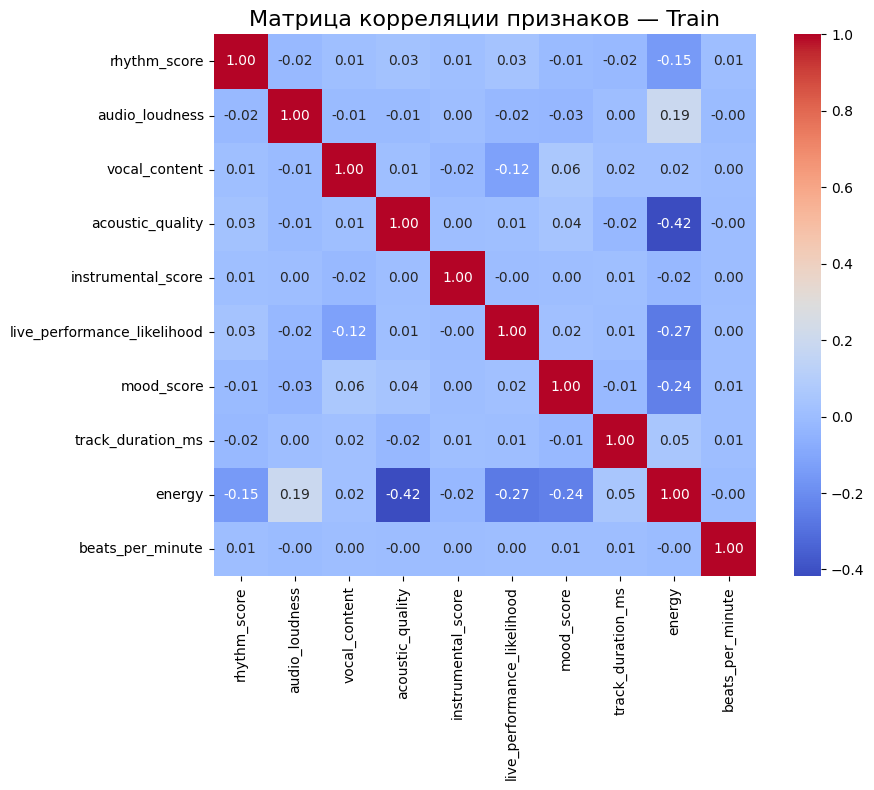


🔍 Пары признаков с корреляцией по Пирсону > 0.2 в 'Train':
mood_score                   energy   -0.241713
live_performance_likelihood  energy   -0.266256
acoustic_quality             energy   -0.418184
dtype: float64


In [64]:
simple_correlation_analysis(df_train, target='beats_per_minute', df_name='Train', pair_corr_threshold=0.2)

In [65]:
def correlation_analysis_no_target(df, df_name='DataFrame', pair_corr_threshold=0.8):
    # Удаляем колонку 'id', если она есть
    df = df.drop(columns=['id'], errors='ignore')

    # Матрица корреляции
    corr = df.corr(numeric_only=True)

    print(f"\n📊 Матрица корреляции признаков датафрейма '{df_name}':")
    plt.figure(figsize=(10, 8))
    sns.heatmap(corr, annot=True, fmt=".2f", cmap='coolwarm', square=True)
    plt.title(f'Матрица корреляции признаков — {df_name}', fontsize=16)
    plt.tight_layout()
    plt.show()

    # Поиск пар признаков с высокой корреляцией по Пирсону
    mask = np.triu(np.abs(corr) > pair_corr_threshold, k=1)
    high_corr_pairs = corr.where(mask).stack().sort_values(ascending=False)

    print(f"\n🔍 Пары признаков с корреляцией по Пирсону > {pair_corr_threshold} в '{df_name}':")
    if high_corr_pairs.empty:
        print("Нет пар признаков с высокой корреляцией.")
    else:
        print(high_corr_pairs)


📊 Матрица корреляции признаков датафрейма 'Test':


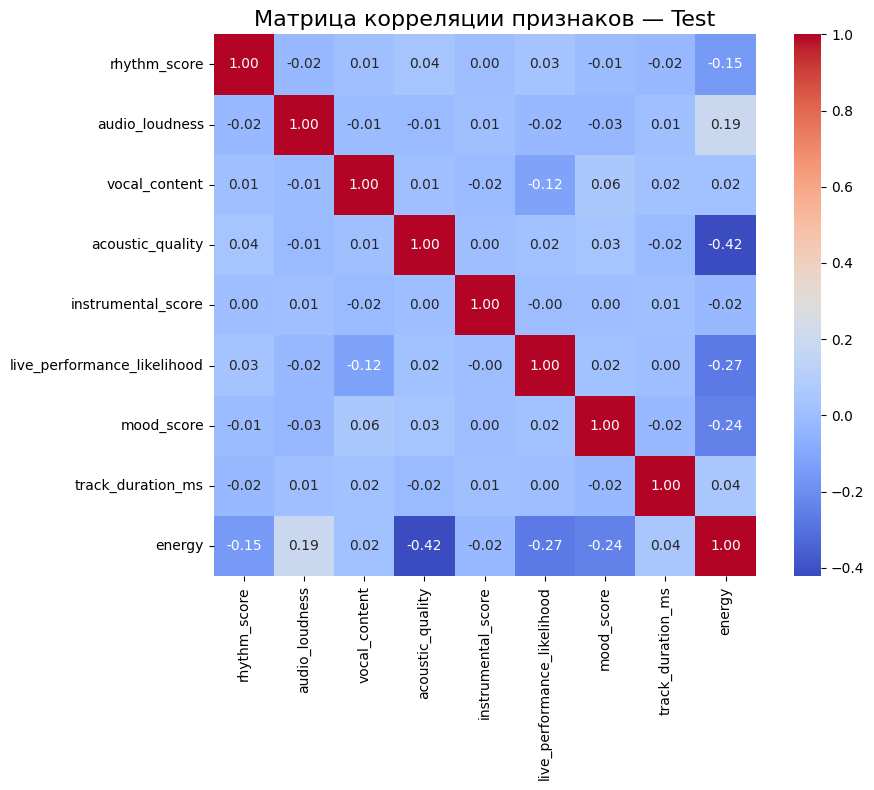


🔍 Пары признаков с корреляцией по Пирсону > 0.2 в 'Test':
mood_score                   energy   -0.240274
live_performance_likelihood  energy   -0.269108
acoustic_quality             energy   -0.422666
dtype: float64


In [66]:
correlation_analysis_no_target(df_test, df_name='Test', pair_corr_threshold=0.2)

Выявлены умеренные корреляции между признаками:
- acoustic_quality и energy (-0.42)
- live_performance_likelihood и energy (-0.27)
- mood_score и energy (-0.24)

Отсуствует линейная корреляции с целевой переменной (все < 0.01)

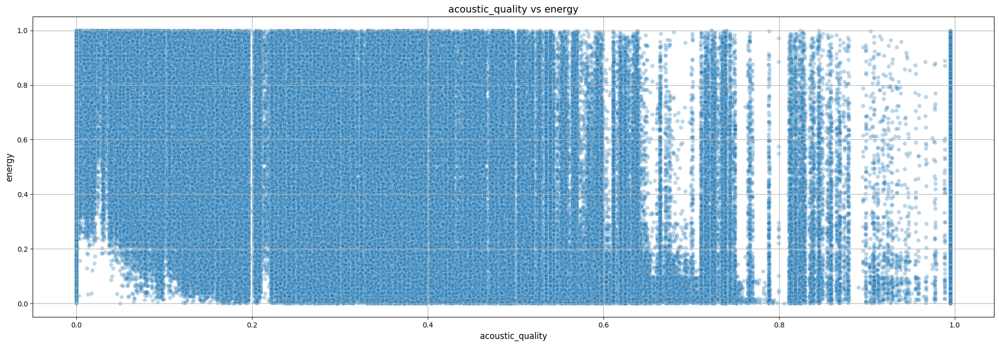

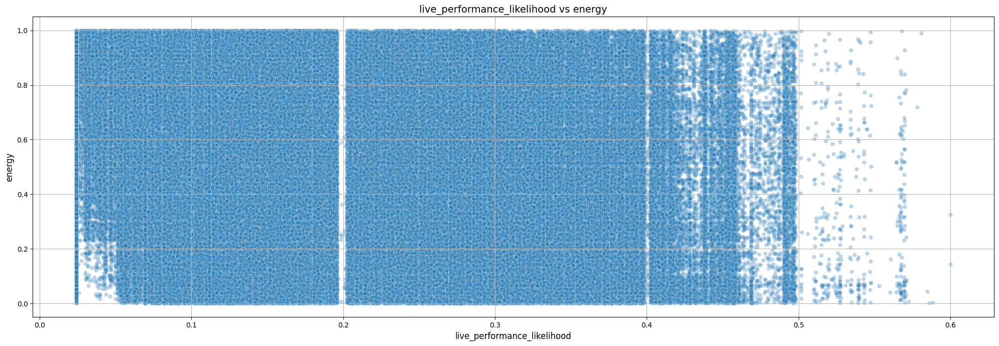

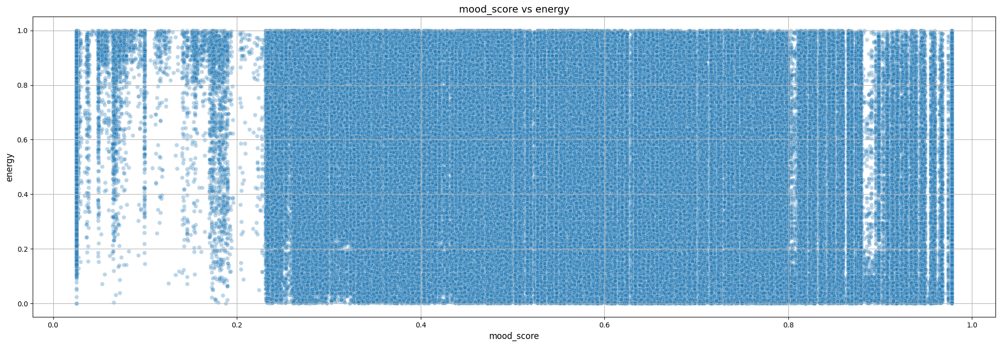

In [67]:
# Диаграммы рассеяния для пар с высокой корреляцией
high_corr_pairs = [
    ('acoustic_quality', 'energy'),
    ('live_performance_likelihood', 'energy'), 
    ('mood_score', 'energy')
]

for feat1, feat2 in high_corr_pairs:
    plt.figure(figsize=(20, 7))
    sns.scatterplot(data=df_train, x=feat1, y=feat2, alpha=0.3)
    plt.title(f'{feat1} vs {feat2}', fontsize=14)
    plt.xlabel(feat1, fontsize=12)
    plt.ylabel(feat2, fontsize=12)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

#### Phik 

interval columns not set, guessing: ['rhythm_score', 'audio_loudness', 'vocal_content', 'acoustic_quality', 'instrumental_score', 'live_performance_likelihood', 'mood_score', 'track_duration_ms', 'energy', 'beats_per_minute']
📊 Phik-корреляции с целевой переменной 'beats_per_minute':
bpm_category                   0.940307
energy                         0.016036
mood_score                     0.015360
track_duration_ms              0.012419
live_performance_likelihood    0.010107
rhythm_score                   0.008413
audio_loudness                 0.008221
acoustic_quality               0.007054
vocal_content                  0.005963
instrumental_score             0.000000
Name: beats_per_minute, dtype: float64

🔍 Пары признаков с Phik-корреляцией > 0.2 в 'Train':
beats_per_minute             bpm_category    0.940307
acoustic_quality             energy          0.485368
live_performance_likelihood  energy          0.342577
audio_loudness               energy          0.321063
mood_s

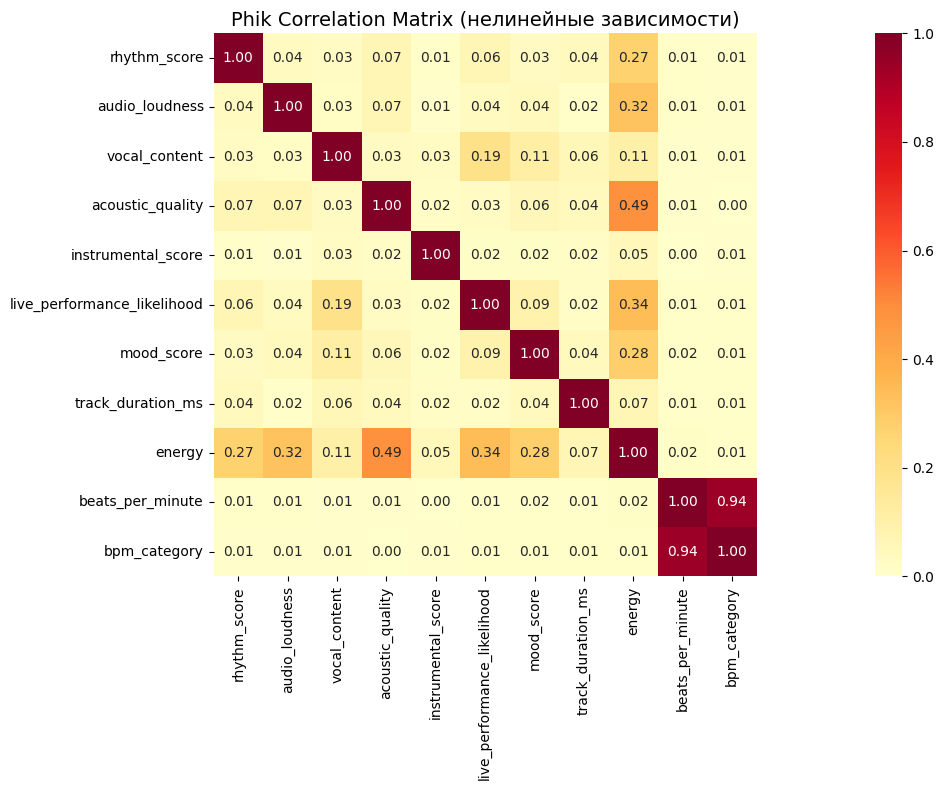

In [68]:
# Порог для сильной корреляции
pair_corr_threshold = 0.2

# Вычисление Phik-матрицы (исключаем 'id')
phik_corr = df_train.drop(columns=['id']).phik_matrix()

# 📊 Корреляции с целевой переменной BPM
bpm_phik = phik_corr['beats_per_minute'].drop('beats_per_minute').sort_values(ascending=False)
print("📊 Phik-корреляции с целевой переменной 'beats_per_minute':")
print(bpm_phik)

# 🔗 Пары признаков с Phik > threshold
mask = np.triu(phik_corr.values > pair_corr_threshold, k=1)
high_corr_pairs = pd.DataFrame(phik_corr.values, index=phik_corr.index, columns=phik_corr.columns).where(mask).stack().sort_values(ascending=False)

print(f"\n🔍 Пары признаков с Phik-корреляцией > {pair_corr_threshold} в 'Train':")
if high_corr_pairs.empty:
    print("Нет пар признаков с высокой корреляцией.")
else:
    print(high_corr_pairs)

# 🔥 Визуализация полной Phik-матрицы
plt.figure(figsize=(24, 8))
sns.heatmap(phik_corr, annot=True, fmt=".2f", cmap='YlOrRd', square=True)
plt.title('Phik Correlation Matrix (нелинейные зависимости)', fontsize=14)
plt.tight_layout()
plt.show()

### Pairplot

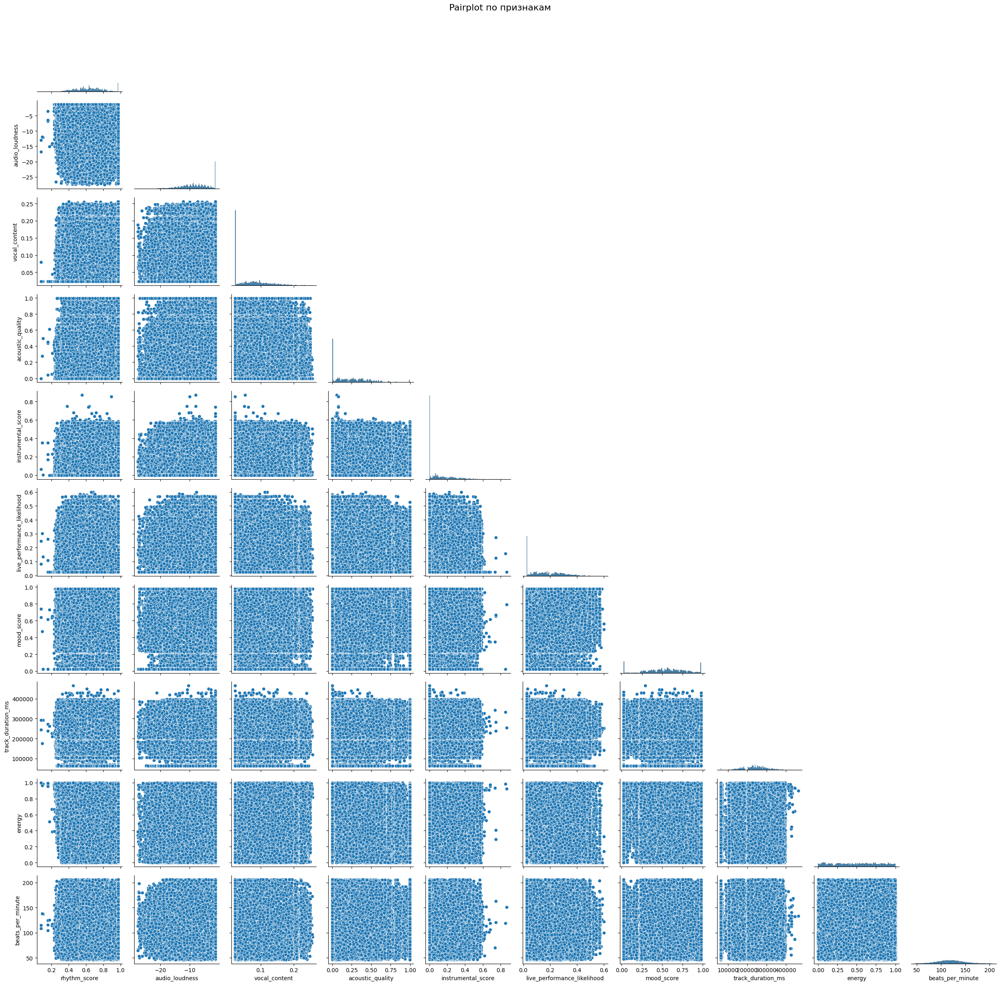

In [69]:
# Удалим колонку 'id', если она есть
df_plot = df_train.drop(columns=['id'], errors='ignore')

# Построим pairplot для всех числовых признаков
sns.pairplot(df_plot, corner=True)
plt.suptitle("Pairplot по признакам", fontsize=16)
plt.tight_layout()
plt.show()

- признаки показывают облако точек без четкого паттерна

### Диаграммы рассеяния (scatter plots)

- с таргетом

In [70]:
def plot_target_vs_features(df, target, figsize=(20, 6)):
    # Удаляем колонку 'id', если она есть
    df = df.drop(columns=['id'], errors='ignore')

    # Выбираем числовые признаки, исключая таргет
    numeric_features = df.select_dtypes(include='number').columns.drop(target, errors='ignore')

    for feature in numeric_features:
        plt.figure(figsize=figsize)
        sns.scatterplot(data=df, x=feature, y=target)
        plt.title(f"Зависимость '{target}' от '{feature}' в датасете df_train", fontsize=14)
        plt.xlabel(feature)
        plt.ylabel(target)
        plt.grid(True)
        plt.tight_layout()
        plt.show()

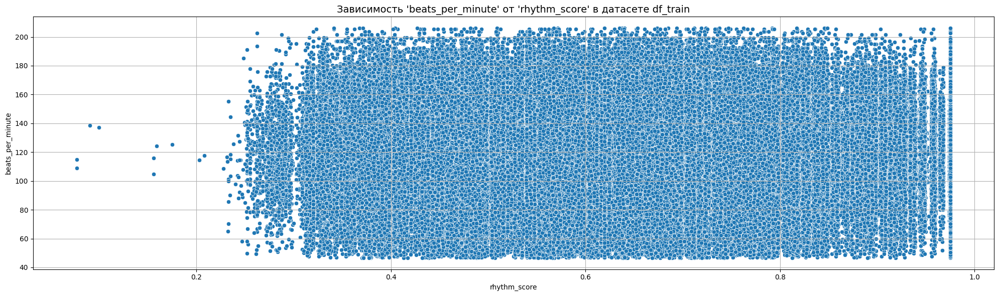

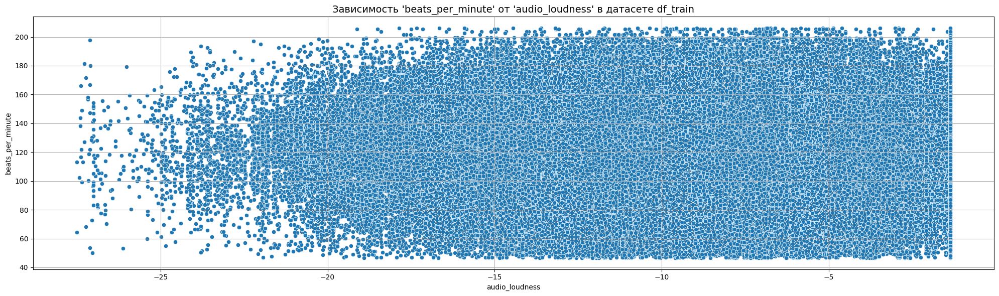

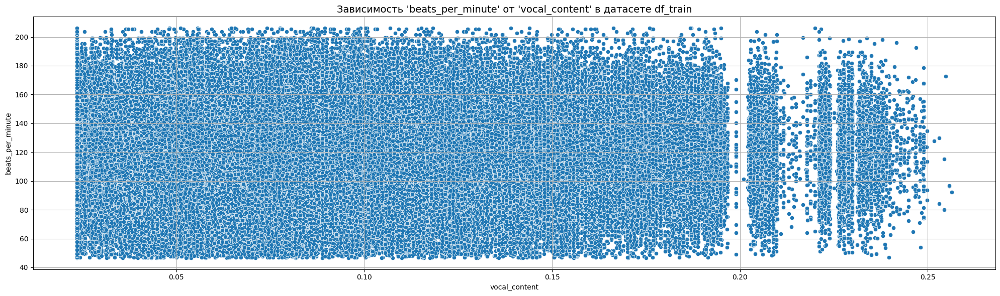

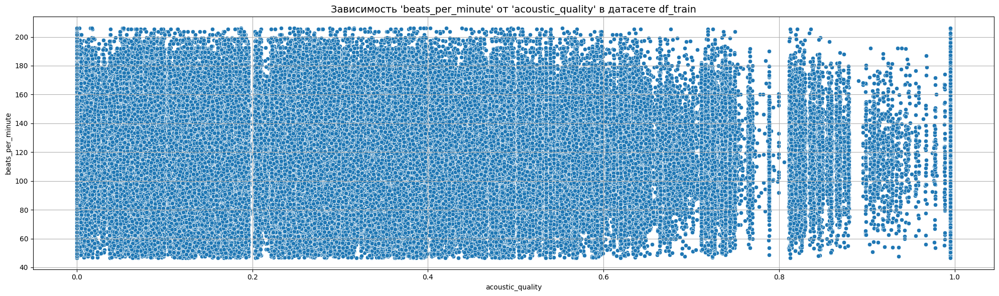

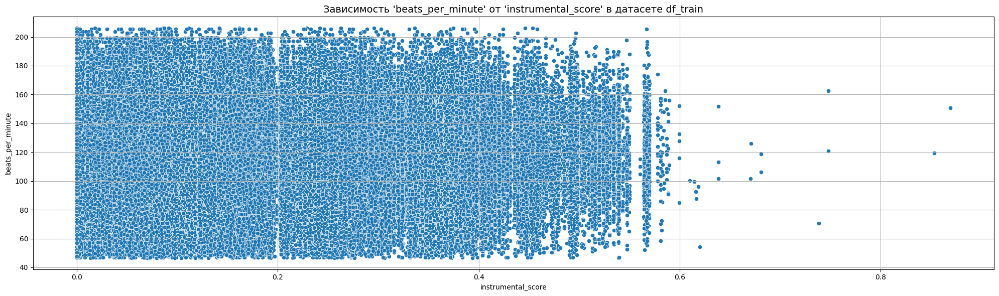

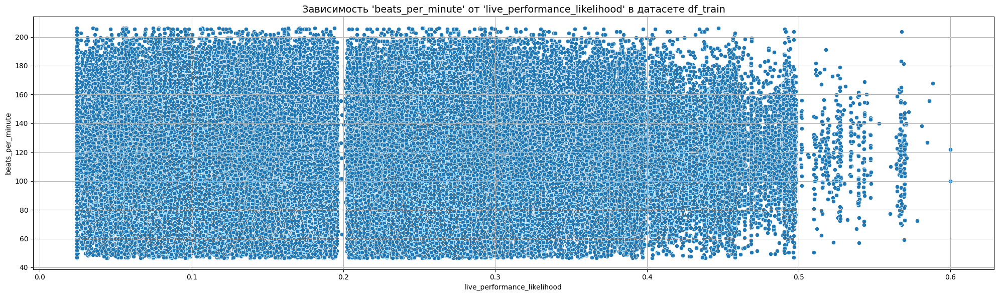

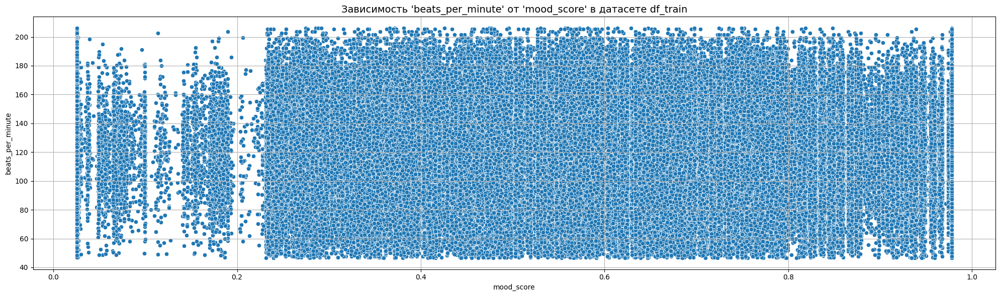

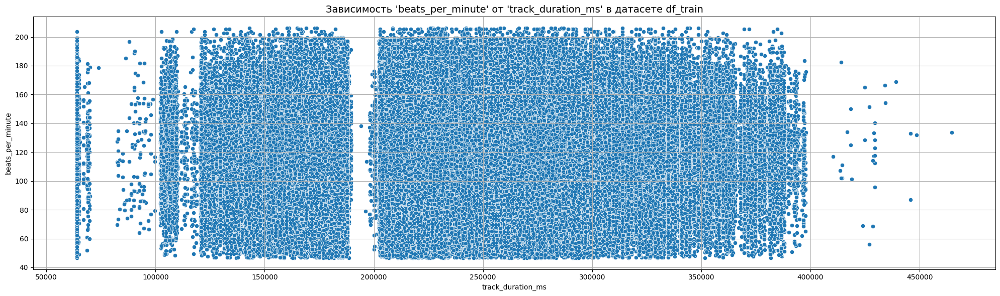

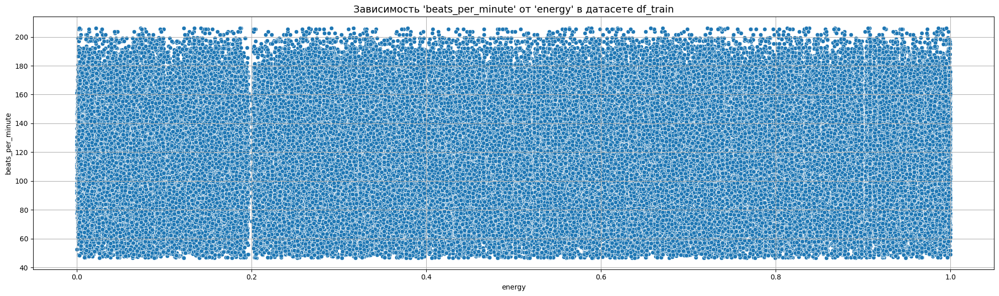

In [71]:
plot_target_vs_features(df_train, target='beats_per_minute')

<div style="border:solid green 4px; padding: 5px">

__Выводы по шагу 3__
- Анализ целевой переменной — нормальное распределение
- Сравнение train/test — идентичные распределения
- Анализ всех признаков — выявлены артефакты синтетических данных:
  - audio_loudness == -1.357 (10.99%):11% треков имеют максимальную громкость (-1.357 dB)
  - vocal_content == 0.0235 (30.31%): 30% треков имеют минимальный вокальный контент
  - live_performance_likelihood == 0.0243 (16.07%): 16% треков имеют минимальную вероятность живого исполнения   
- Различия между категориями минимальны (часто  меньше  0.5% от среднего значения).
    - ANOVA показывает статистическую значимость благодаря огромному размеру выборки (524K записей)     
    
- Слабые линейные связи - традиционные линейные модели могут показать плохие результаты
- Необходимость нелинейных моделей - деревья и градиентный бустинг могут выявить сложные зависимости
- Feature engineering критически важен - нужно создавать взаимодействия и полиномиальные признаки
- Выбросы не требуют обработки - распределения достаточно стабильные
- Масштабирование обязательно - признаки в разных диапазонах значений

</div>

<div class="alert alert-info">
  <b> * <a href="#ch2_1">к содержанию</a> </b> 
</div>

---

## Шаг 4: Подготовка к обучению моделей <a class="anchor" id="ch2_1_4"></a>

### Feature Engineering (создание новых признаков)

In [72]:
# Копируем датафреймы, чтобы не портить исходные
train = df_train.copy()


# --- 1. TrackDuration в минутах и секундах ---
train['track_duration_min'] = train['track_duration_ms'] / 60000
train['track_duration_sec'] = train['track_duration_ms'] / 1000


# --- 2. Логарифм длительности трека ---
train['log_track_duration'] = np.log1p(train['track_duration_ms'])

train['sqrt_rhythm'] = np.sqrt(train['rhythm_score'])
train['log_audio_loudness'] = np.log1p(-train['audio_loudness'])


# --- 3. Создайте признаки высшего порядка
train['energy_cubed'] = train['energy'] ** 3

train['rhythm_energy_complex'] = train['rhythm_score'] * np.exp(train['energy'])

# --- 4. Взаимодействия двух признаков ---
train['energy_rhythm'] = train['energy'] * train['rhythm_score']
train['vocal_instrumental'] = train['vocal_content'] * train['instrumental_score']
train['mood_energy'] = train['mood_score'] * train['energy']
train['loudness_duration'] = train['audio_loudness'] * train['track_duration_ms']

# --- 5. Взаимодействия трех признаков
train['energy_rhythm_mood'] = train['energy'] * train['rhythm_score'] * train['mood_score']
train['energy_mood_ratio'] = train['energy'] * train['mood_score'] / (train['rhythm_score'] + 1e-6)

# --- 6. Соотношения двух признаков ---
train['energy_to_rhythm'] = train['energy'] / (train['rhythm_score'] + 1e-6)
train['vocal_to_instrumental'] = train['vocal_content'] / (train['instrumental_score'] + 1e-6)
train['vocal_acoustic_balance'] = train['vocal_content'] / (train['acoustic_quality'] + 1e-6)

# --- 7. Полиномиальные признаки (квадраты ключевых параметров) ---
for col in ['rhythm_score', 'energy', 'audio_loudness']:
    train[f'{col}_squared'] = train[col] ** 2
    

    
# --- 8. Категории длительности трека ---
def categorize_duration(x):
    if x < 180000:   # < 3 минут
        return 'short'
    elif x < 300000: # 3-5 минут
        return 'medium'
    else:            # > 5 минут
        return 'long'

train['duration_category'] = train['track_duration_ms'].apply(categorize_duration)

__Feature Engineering (создание новых признаков)__
- Длительность трека преобразована в минуты и секунды (track_duration_min, track_duration_sec), а также добавлен её логарифм (log_track_duration)
- Взаимодействия признаков:
  - energy * rhythm_score → отражает сочетание энергетичности и ритмичности, напрямую связанное с BPM.
  - vocal_content * instrumental_score → баланс вокала и инструментала.
  - mood_score * energy → эмоциональная окраска в сочетании с энергией.
  - audio_loudness * track_duration_ms → громкость в зависимости от длины трека.
- Соотношения признаков:
  - energy / rhythm_score → относительная «энергия на ритм».
  - vocal_content / instrumental_score → баланс вокала и инструментала.
- Полиномиальные признаки (квадраты): rhythm_score², energy², audio_loudness².
- Категории длительности трека: short (<3 мин), medium (3–5 мин), long (>5 мин).

👉 Это расширяет пространство признаков и позволяет моделям уловить нелинейные зависимости.

### Матрица корреляций(heatmap) для выявления зависимостей

#### Пирсона

In [73]:
def simple_correlation_analysis_v2(df, target, df_name='DataFrame', pair_corr_threshold=0.8):
    # Удаляем колонку 'id', если она есть
    df = df.drop(columns=['id'], errors='ignore')

    # Корреляции с таргетом
    corr = df.corr(numeric_only=True)
    target_corr = corr[target].drop(target).sort_values(ascending=False)
    
    print(f"\n📊 Корреляция признаков датафрейма '{df_name}' с таргетом '{target}':")
    print(target_corr)

    # Матрица корреляции
    plt.figure(figsize=(20, 12))
    sns.heatmap(corr, annot=True, fmt=".2f", cmap='coolwarm', square=True)
    plt.title(f'Матрица корреляции признаков — {df_name}', fontsize=16)
    plt.tight_layout()
    plt.show()

    # Поиск пар признаков с высокой корреляцией по Пирсону
    mask = np.triu(np.abs(corr) > pair_corr_threshold, k=1)
    high_corr_pairs = corr.where(mask).stack().sort_values(ascending=False)

    print(f"\n🔍 Пары признаков с корреляцией по Пирсону > {pair_corr_threshold} в '{df_name}':")
    if high_corr_pairs.empty:
        print("Нет пар признаков с высокой корреляцией.")
    else:
        print(high_corr_pairs)


📊 Корреляция признаков датафрейма 'Train' с таргетом 'beats_per_minute':
mood_score                     0.007059
track_duration_ms              0.006637
track_duration_sec             0.006637
track_duration_min             0.006637
log_track_duration             0.006302
sqrt_rhythm                    0.005698
rhythm_score                   0.005440
vocal_content                  0.004876
rhythm_score_squared           0.004853
vocal_instrumental             0.004453
log_audio_loudness             0.003474
live_performance_likelihood    0.003471
audio_loudness_squared         0.003067
instrumental_score             0.001900
energy_rhythm_mood             0.001715
rhythm_energy_complex          0.000612
vocal_to_instrumental         -0.000740
mood_energy                   -0.000767
acoustic_quality              -0.000820
energy_rhythm                 -0.001630
vocal_acoustic_balance        -0.002025
audio_loudness                -0.003327
energy_mood_ratio             -0.003398
energy

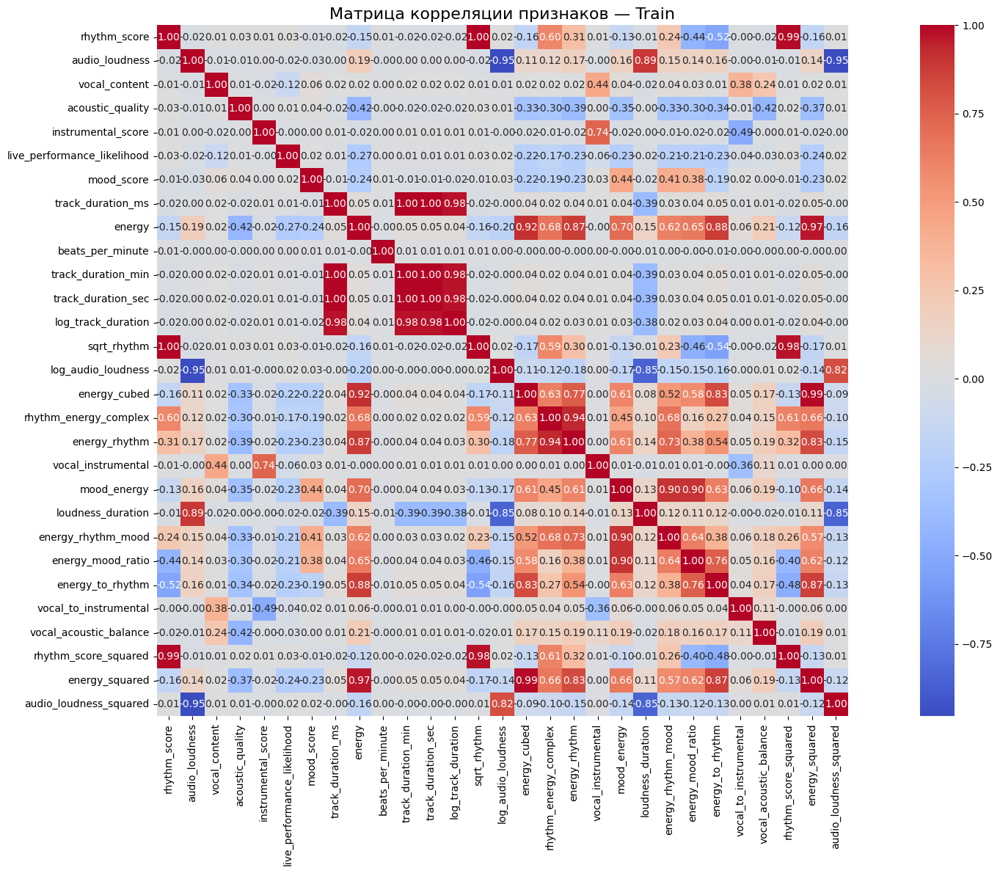


🔍 Пары признаков с корреляцией по Пирсону > 0.2 в 'Train':
track_duration_min  track_duration_sec        1.000000
track_duration_ms   track_duration_sec        1.000000
                    track_duration_min        1.000000
rhythm_score        sqrt_rhythm               0.997062
                    rhythm_score_squared      0.989514
                                                ...   
sqrt_rhythm         energy_to_rhythm         -0.543766
log_audio_loudness  loudness_duration        -0.847988
loudness_duration   audio_loudness_squared   -0.851957
audio_loudness      log_audio_loudness       -0.951403
                    audio_loudness_squared   -0.954441
Length: 101, dtype: float64


In [74]:
simple_correlation_analysis_v2(train, target='beats_per_minute', df_name='Train', pair_corr_threshold=0.2)

#### Phik 

interval columns not set, guessing: ['rhythm_score', 'audio_loudness', 'vocal_content', 'acoustic_quality', 'instrumental_score', 'live_performance_likelihood', 'mood_score', 'track_duration_ms', 'energy', 'beats_per_minute', 'track_duration_min', 'track_duration_sec', 'log_track_duration', 'sqrt_rhythm', 'log_audio_loudness', 'energy_cubed', 'rhythm_energy_complex', 'energy_rhythm', 'vocal_instrumental', 'mood_energy', 'loudness_duration', 'energy_rhythm_mood', 'energy_mood_ratio', 'energy_to_rhythm', 'vocal_to_instrumental', 'vocal_acoustic_balance', 'rhythm_score_squared', 'energy_squared', 'audio_loudness_squared']
📊 Phik-корреляции с целевой переменной 'beats_per_minute':
bpm_category                   0.940307
energy                         0.016036
mood_score                     0.015360
energy_rhythm                  0.014991
energy_squared                 0.013918
energy_rhythm_mood             0.013336
log_track_duration             0.013233
mood_energy                    0.0

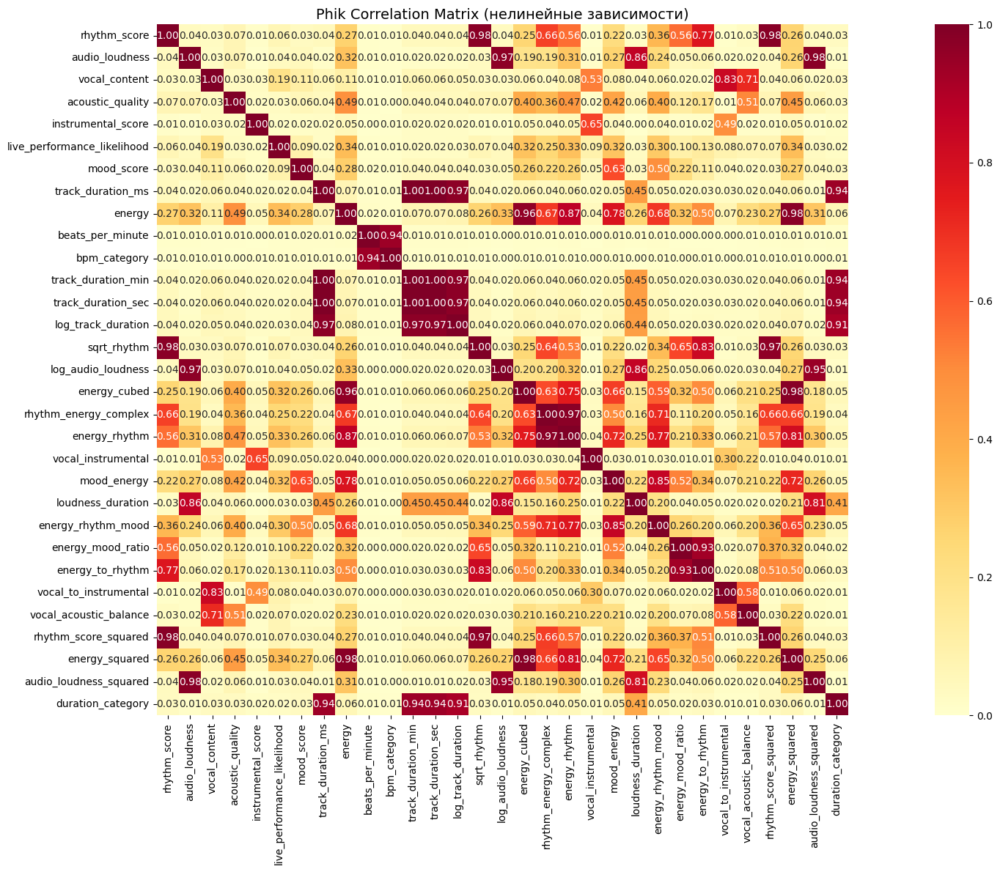

In [75]:
# Порог для сильной корреляции
pair_corr_threshold = 0.2

# Вычисление Phik-матрицы (исключаем 'id')
phik_corr = train.drop(columns=['id']).phik_matrix()

# 📊 Корреляции с целевой переменной BPM
bpm_phik = phik_corr['beats_per_minute'].drop('beats_per_minute').sort_values(ascending=False)
print("📊 Phik-корреляции с целевой переменной 'beats_per_minute':")
print(bpm_phik)

# 🔗 Пары признаков с Phik > threshold
mask = np.triu(phik_corr.values > pair_corr_threshold, k=1)
high_corr_pairs = pd.DataFrame(phik_corr.values, index=phik_corr.index, columns=phik_corr.columns).where(mask).stack().sort_values(ascending=False)

print(f"\n🔍 Пары признаков с Phik-корреляцией > {pair_corr_threshold} в 'Train':")
if high_corr_pairs.empty:
    print("Нет пар признаков с высокой корреляцией.")
else:
    print(high_corr_pairs)

# 🔥 Визуализация полной Phik-матрицы
plt.figure(figsize=(24, 12))
sns.heatmap(phik_corr, annot=True, fmt=".2f", cmap='YlOrRd', square=True)
plt.title('Phik Correlation Matrix (нелинейные зависимости)', fontsize=14)
plt.tight_layout()
plt.show()

### Разделение признаков и целевой переменной для обучающей выборки на train/valid

In [76]:
# Целевая переменная
y_train = train['beats_per_minute']

# Убираем id, целевую переменную и производный признак bpm_category
X_train = train.drop(columns=['id', 'beats_per_minute', 'bpm_category'], errors='ignore')

In [77]:
print(y_train.describe())
print(f"Mean: {y_train.mean()}, Std: {y_train.std()}")

count    524164.000000
mean        119.034899
std          26.468077
min          46.718000
25%         101.070410
50%         118.747660
75%         136.686590
max         206.037000
Name: beats_per_minute, dtype: float64
Mean: 119.03489938795875, Std: 26.468077212186284


In [78]:
X_train_split, X_valid_split, y_train_split, y_valid_split = train_test_split(
    X_train, y_train, test_size=0.2, random_state=42
)

очистим y_train_split от выбросов

In [79]:
y_capped = np.clip(y_train_split, y_train_split.quantile(0.01), y_train_split.quantile(0.99))
print(y_capped.describe())
print(f"Mean: {y_capped.mean()}, Std: {y_capped.std()}")

count    419331.000000
mean        119.019886
std          26.137278
min          58.521310
25%         101.086660
50%         118.735320
75%         136.700920
max         180.816720
Name: beats_per_minute, dtype: float64
Mean: 119.01988621864352, Std: 26.137278345840013


In [80]:
changed_mask = y_train_split != y_capped
changed_ratio = changed_mask.mean()
changed_count = changed_mask.sum()

print(f"🔢 Изменено значений: {changed_count} из {len(y_train_split)} ({changed_ratio:.2%})")

🔢 Изменено значений: 8359 из 419331 (1.99%)


In [81]:
print("📉 Минимальное изменённое значение:", y_train_split[changed_mask].min())
print("📈 Максимальное изменённое значение:", y_train_split[changed_mask].max())

📉 Минимальное изменённое значение: 46.718
📈 Максимальное изменённое значение: 206.037


In [82]:
diff = (y_train_split - y_capped).abs()
print(f"📏 Средняя разница: {diff.mean():.4f}")
print(f"📏 Максимальная разница: {diff.max():.4f}")

📏 Средняя разница: 0.1325
📏 Максимальная разница: 25.2203


In [83]:
print(f"🔣 Уникальных значений до: {y_train_split.nunique()}, после: {y_capped.nunique()}")

🔣 Уникальных значений до: 14622, после: 14324


In [84]:
# Для линейных моделей
X_lin, X_valid_lin = X_train_split, X_valid_split
y_lin, y_valid_lin = y_capped, y_valid_split

# Для ансамблей (те же данные, т.к. random_state одинаковый)
X_ens, X_valid_ens = X_train_split, X_valid_split
y_ens, y_valid_ens = y_capped, y_valid_split

### Предобработка данных: масштабирование и кодирование

Предобработка данных
- One-Hot Encoding для категориальных признаков
- StandardScaler для всех числовых признаков

для линейных моделей

In [85]:
def prepare_data(X_train, X_test):
    # 📋 1. Определение категориальных и числовых признаков
    cat_col_names = X_train.select_dtypes(exclude='number').columns.tolist()  # категориальные
    num_col_names = X_train.select_dtypes(include='number').columns.tolist()  # числовые

    # 🧠 2. Инициализация OneHotEncoder
    ohe = OneHotEncoder(
        sparse_output=False,    
        drop='first',           
        handle_unknown="ignore" 
    )

    # 🔁 3. Кодирование категориальных признаков
    X_train_ohe = ohe.fit_transform(X_train[cat_col_names])  
    X_test_ohe = ohe.transform(X_test[cat_col_names])        

    # 📏 4. Масштабирование числовых признаков
    scaler = StandardScaler()
    X_train[num_col_names] = scaler.fit_transform(X_train[num_col_names])
    X_test[num_col_names] = scaler.transform(X_test[num_col_names])

    # 🏷️ 5. Получение имён новых бинарных признаков
    encoder_col_names = ohe.get_feature_names_out(cat_col_names)

    # 🔄 6. Преобразование закодированных массивов в DataFrame
    X_train_ohe = pd.DataFrame(X_train_ohe, columns=encoder_col_names)
    X_test_ohe = pd.DataFrame(X_test_ohe, columns=encoder_col_names)

    # 🧬 7. Обнуление индексов
    X_train = X_train.reset_index(drop=True)
    X_test = X_test.reset_index(drop=True)
    X_train_ohe = X_train_ohe.reset_index(drop=True)
    X_test_ohe = X_test_ohe.reset_index(drop=True)

    # 🔗 8. Объединение числовых и категориальных признаков
    X_train = pd.concat((X_train[num_col_names], X_train_ohe), axis=1)
    X_test = pd.concat((X_test[num_col_names], X_test_ohe), axis=1)

    return X_train, X_test


In [86]:
# --- Подготовка данных для линейных моделей ---
X_lin_prepared, X_valid_lin_prepared = prepare_data(X_lin, X_valid_lin)

print("Форма X_train_prepared:", X_lin_prepared.shape)
print("Форма X_test_prepared:", X_valid_lin_prepared .shape)
print("Форма y_lin:", y_lin.shape)
print("Форма y_valid_lin:", y_valid_lin.shape)

Форма X_train_prepared: (419331, 30)
Форма X_test_prepared: (104833, 30)
Форма y_lin: (419331,)
Форма y_valid_lin: (104833,)


In [87]:
X_lin_prepared.columns.equals(X_valid_lin_prepared.columns)

True

In [88]:
X_lin_prepared.isnull().sum().sum()

0

In [89]:
X_valid_lin_prepared.isnull().sum().sum()

0

- Сохранение согласованности между train и test
- Обработка пропусков - данные чистые

In [90]:
X_lin_prepared.describe().T

,count,mean,std,min,25%,50%,75%,max
rhythm_score,419331.0,1.440094e-15,1.000001,-3.457330,-0.745777,0.011714,0.678008,2.181618
audio_loudness,419331.0,3.123835e-16,1.000001,-4.126324,-0.686466,0.027310,0.750861,1.520959
vocal_content,419331.0,-2.664042e-16,1.000001,-1.020450,-1.020450,-0.160352,0.660578,3.645599
acoustic_quality,419331.0,-2.478328e-16,1.000001,-1.177737,-0.867041,-0.091211,0.601565,3.282090
instrumental_score,419331.0,-2.102834e-16,1.000001,-0.892238,-0.892238,-0.329478,0.655362,5.577956
live_performance_likelihood,419331.0,-6.984171e-17,1.000001,-1.304330,-0.852992,-0.101403,0.765740,3.566304
mood_score,419331.0,5.967237e-16,1.000001,-2.350377,-0.673496,0.039994,0.713384,1.872129
track_duration_ms,419331.0,-9.834689e-17,1.000001,-2.996275,-0.585856,0.029591,0.673704,3.753847
energy,419331.0,4.402735e-16,1.000001,-1.727836,-0.848905,0.037153,0.845042,1.720525
track_duration_min,419331.0,1.819519e-16,1.000001,-2.996275,-0.585856,0.029591,0.673704,3.753847


In [91]:
X_valid_lin_prepared.describe().T

,count,mean,std,min,25%,50%,75%,max
rhythm_score,104833.0,0.000012,1.001999,-3.544730,-0.746672,0.012343,0.678066,2.181618
audio_loudness,104833.0,-0.000248,0.999501,-4.143872,-0.690530,0.027858,0.750862,1.520959
vocal_content,104833.0,0.000827,1.002460,-1.020450,-1.020450,-0.162946,0.651600,3.605755
acoustic_quality,104833.0,0.003411,1.000412,-1.177737,-0.865734,-0.088453,0.601305,3.282090
instrumental_score,104833.0,0.001756,0.999743,-0.892238,-0.892238,-0.326648,0.657999,5.700462
live_performance_likelihood,104833.0,-0.002146,1.000127,-1.304330,-0.853934,-0.107085,0.765992,3.320735
mood_score,104833.0,0.002394,0.998377,-2.350377,-0.670321,0.045565,0.712646,1.872129
track_duration_ms,104833.0,0.003693,0.996391,-2.996275,-0.576787,0.034172,0.672929,3.160031
energy,104833.0,-0.002945,0.999630,-1.727836,-0.848905,0.027497,0.840444,1.720525
track_duration_min,104833.0,0.003693,0.996391,-2.996275,-0.576787,0.034172,0.672929,3.160031


для ансамблей

In [92]:
def prepare_data_cat(X_train, X_test):
    # 📋 1. Определение категориальных и числовых признаков
    cat_col_names = X_train.select_dtypes(exclude='number').columns.tolist()
    num_col_names = X_train.select_dtypes(include='number').columns.tolist()

    # 🧠 2. Инициализация OneHotEncoder
    ohe = OneHotEncoder(
        sparse_output=False,    
        drop='first',           
        handle_unknown="ignore" 
    )

    # 🔁 3. Кодирование категориальных признаков
    X_train_ohe = ohe.fit_transform(X_train[cat_col_names])  
    X_test_ohe = ohe.transform(X_test[cat_col_names])        

    # 🏷️ 4. Получение имён новых бинарных признаков
    encoder_col_names = ohe.get_feature_names_out(cat_col_names)

    # 🔄 5. Преобразование закодированных массивов в DataFrame
    X_train_ohe = pd.DataFrame(X_train_ohe, columns=encoder_col_names)
    X_test_ohe = pd.DataFrame(X_test_ohe, columns=encoder_col_names)

    # 🧬 6. Обнуление индексов
    X_train = X_train.reset_index(drop=True)
    X_test = X_test.reset_index(drop=True)
    X_train_ohe = X_train_ohe.reset_index(drop=True)
    X_test_ohe = X_test_ohe.reset_index(drop=True)

    # 🔗 7. Объединение числовых и категориальных признаков
    X_train = pd.concat([X_train[num_col_names], X_train_ohe], axis=1)
    X_test = pd.concat([X_test[num_col_names], X_test_ohe], axis=1)

    return X_train, X_test

In [93]:
# --- Подготовка данных для линейных моделей ---
X_ens_prepared, X_valid_ens_prepared = prepare_data_cat(X_ens, X_valid_ens)

print("Форма X_ens_prepared:", X_ens_prepared.shape)
print("Форма X_valid_ens_prepared:", X_valid_ens_prepared .shape)
print("Форма y_ens:", y_ens.shape)
print("Форма y_valid_ens:", y_valid_ens.shape)

Форма X_ens_prepared: (419331, 30)
Форма X_valid_ens_prepared: (104833, 30)
Форма y_ens: (419331,)
Форма y_valid_ens: (104833,)


In [94]:
X_ens_prepared.columns.equals(X_valid_ens_prepared.columns)

True

In [95]:
X_ens_prepared.isnull().sum().sum()

0

In [96]:
X_valid_ens_prepared.isnull().sum().sum()

0

### Выбор признаков

📊 Логика отбора для нелинейных моделей
- Удаляем дубликаты длительности
  - track_duration_ms, track_duration_sec, track_duration_min — это одно и то же. 👉 Оставляем log_track_duration (лучше справляется с длинным хвостом).
- Удаляем квадраты признаков
  - rhythm_score_squared, energy_squared, audio_loudness_squared — деревья и так моделируют нелинейности.
- Удаляем избыточные взаимодействия
  - loudness_duration сильно коррелирует с audio_loudness и длительностью.
  - vocal_instrumental дублирует vocal_content и instrumental_score.
- Оставляем полезные взаимодействия и соотношения
  -  energy_rhythm
  -  mood_energy
  -  energy_to_rhythm
  -  vocal_to_instrumental
- Оставляем категориальный признак
  -  duration_category (short/medium/long → one-hot encoding).

Что важно для линейных моделей: линейные модели сами по себе не видят нелинейностей, поэтому им полезны квадраты и взаимодействия.

In [97]:
features_for_linear = [
    'rhythm_score', 'vocal_content', 'acoustic_quality',
    'instrumental_score', 'live_performance_likelihood', 'mood_score', 'energy',
    'log_track_duration', 'log_audio_loudness', 'duration_category_medium', 'duration_category_short'
]


X_train_lin = X_lin_prepared[features_for_linear]
X_valid_lin = X_valid_lin_prepared[features_for_linear]

In [98]:
X_train_lin.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 419331 entries, 0 to 419330
Data columns (total 11 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   rhythm_score                 419331 non-null  float64
 1   vocal_content                419331 non-null  float64
 2   acoustic_quality             419331 non-null  float64
 3   instrumental_score           419331 non-null  float64
 4   live_performance_likelihood  419331 non-null  float64
 5   mood_score                   419331 non-null  float64
 6   energy                       419331 non-null  float64
 7   log_track_duration           419331 non-null  float64
 8   log_audio_loudness           419331 non-null  float64
 9   duration_category_medium     419331 non-null  float64
 10  duration_category_short      419331 non-null  float64
dtypes: float64(11)
memory usage: 35.2 MB


In [99]:
X_valid_lin.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 104833 entries, 0 to 104832
Data columns (total 11 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   rhythm_score                 104833 non-null  float64
 1   vocal_content                104833 non-null  float64
 2   acoustic_quality             104833 non-null  float64
 3   instrumental_score           104833 non-null  float64
 4   live_performance_likelihood  104833 non-null  float64
 5   mood_score                   104833 non-null  float64
 6   energy                       104833 non-null  float64
 7   log_track_duration           104833 non-null  float64
 8   log_audio_loudness           104833 non-null  float64
 9   duration_category_medium     104833 non-null  float64
 10  duration_category_short      104833 non-null  float64
dtypes: float64(11)
memory usage: 8.8 MB


Что важно для бустинга:  умеют строить нелинейности и не страдают от мультиколлинеарности, но избыточные признаки замедляют обучение и могут «размывать» важность.

In [100]:
features_for_ensembles = [
    'rhythm_score','vocal_content','acoustic_quality',
    'instrumental_score','live_performance_likelihood','mood_score','energy',
    'log_track_duration', 'log_audio_loudness','energy_rhythm','mood_energy','energy_to_rhythm',
    'vocal_to_instrumental','duration_category_medium','duration_category_short'
]


X_ens=X_ens_prepared[features_for_ensembles]
X_valid_ens=X_valid_ens_prepared[features_for_ensembles]

In [101]:
X_ens.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 419331 entries, 0 to 419330
Data columns (total 15 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   rhythm_score                 419331 non-null  float64
 1   vocal_content                419331 non-null  float64
 2   acoustic_quality             419331 non-null  float64
 3   instrumental_score           419331 non-null  float64
 4   live_performance_likelihood  419331 non-null  float64
 5   mood_score                   419331 non-null  float64
 6   energy                       419331 non-null  float64
 7   log_track_duration           419331 non-null  float64
 8   log_audio_loudness           419331 non-null  float64
 9   energy_rhythm                419331 non-null  float64
 10  mood_energy                  419331 non-null  float64
 11  energy_to_rhythm             419331 non-null  float64
 12  vocal_to_instrumental        419331 non-null  float64
 13 

In [102]:
X_valid_ens.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 104833 entries, 0 to 104832
Data columns (total 15 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   rhythm_score                 104833 non-null  float64
 1   vocal_content                104833 non-null  float64
 2   acoustic_quality             104833 non-null  float64
 3   instrumental_score           104833 non-null  float64
 4   live_performance_likelihood  104833 non-null  float64
 5   mood_score                   104833 non-null  float64
 6   energy                       104833 non-null  float64
 7   log_track_duration           104833 non-null  float64
 8   log_audio_loudness           104833 non-null  float64
 9   energy_rhythm                104833 non-null  float64
 10  mood_energy                  104833 non-null  float64
 11  energy_to_rhythm             104833 non-null  float64
 12  vocal_to_instrumental        104833 non-null  float64
 13 

<div style="border:solid green 4px; padding: 5px">

__Выводы по шагу 4__

- Feature Engineering: добавлены логарифмы, взаимодействия, соотношения и категории
   - Это расширяет пространство признаков и даёт шанс моделям уловить скрытые зависимости.
- Корреляции с целевой переменной низкие → простые линейные модели будут слабыми, лучше использовать деревья и бустинг (Random Forest, XGBoost, LightGBM, CatBoost)
- Мультиколлинеарность высокая среди производных признаков → для линейных моделей нужно будет отобрать подмножество признаков или применить регуляризацию
- Категориальные признаки (например, duration_category) добавляют интерпретируемость и могут быть полезны для деревьев
- Все преобразования проведены без ошибок, структура train/test согласована, признаки масштабированы
- Модель готова к обучению
  - Данные стандартизированы, а целевая переменная (beats_per_minute) подготовлена для регрессии.    
</div>

<div class="alert alert-info">
  <b> * <a href="#ch2_1">к содержанию</a> </b> 
</div>

---

## Шаг 5: Обучение моделей <a class="anchor" id="ch2_1_5"></a>

### Метрика RMSE

In [103]:
def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))  # без squared=False

scorer = make_scorer(rmse, greater_is_better=False)

датасеты для линейных моделей:X_train_lin,X_valid_lin,y_lin, y_valid_lin

### Базовая модель (DummyRegressor)

In [104]:
# --- DummyRegressor ---
start = time.time()
dummy = DummyRegressor(strategy="mean")

# 1️⃣ Кросс-валидация
scores_rmse = cross_val_score(dummy, X_train_lin, y_lin, cv=5, scoring=scorer)
rmse_scores = -scores_rmse
print("RMSE на каждом фолде (DummyRegressor):")
for i, score in enumerate(rmse_scores, 1):
    print(f"  Fold {i}: {score:.4f}")
print(f"📊 Средний RMSE (CV) DummyRegressor: {rmse_scores.mean():.3f}")

# 2️⃣ Финальная оценка
dummy.fit(X_train_lin, y_lin)
y_valid_pred = dummy.predict(X_valid_lin)
rmse_valid = rmse(y_valid_lin, y_valid_pred)
print(f"📏 RMSE на валидации DummyRegressor: {rmse_valid:.3f}")
print(f"⏱️ Время выполнения: {time.time() - start:.2f} сек\n")

RMSE на каждом фолде (DummyRegressor):
  Fold 1: 26.1488
  Fold 2: 26.2144
  Fold 3: 26.1018
  Fold 4: 26.1373
  Fold 5: 26.0840
📊 Средний RMSE (CV) DummyRegressor: 26.137
📏 RMSE на валидации DummyRegressor: 26.445
⏱️ Время выполнения: 0.13 сек



### Linear Regression

In [105]:
# --- LinearRegression ---
start = time.time()
lr = LinearRegression()

# 1️⃣ Кросс-валидация
scores_rmse = cross_val_score(lr, X_train_lin, y_lin, cv=5, scoring=scorer)
rmse_scores = -scores_rmse
print("RMSE на каждом фолде (LinearRegression):")
for i, score in enumerate(rmse_scores, 1):
    print(f"  Fold {i}: {score:.4f}")
print(f"📊 Средний RMSE (CV) LinearRegression: {rmse_scores.mean():.3f}")

# 2️⃣ Финальная оценка
lr.fit(X_train_lin, y_lin)
y_valid_pred = lr.predict(X_valid_lin)
rmse_valid = rmse(y_valid_lin, y_valid_pred)
print(f"📏 RMSE на валидации LinearRegression: {rmse_valid:.3f}")
print(f"⏱️ Время выполнения: {time.time() - start:.2f} сек\n")

RMSE на каждом фолде (LinearRegression):
  Fold 1: 26.1460
  Fold 2: 26.2156
  Fold 3: 26.0990
  Fold 4: 26.1337
  Fold 5: 26.0830
📊 Средний RMSE (CV) LinearRegression: 26.135
📏 RMSE на валидации LinearRegression: 26.444
⏱️ Время выполнения: 0.65 сек



### Ridge

In [106]:
# --- Ridge
start = time.time()
ridge_params = {'alpha': [0.01, 0.1, 1.0, 10.0, 100.0], 'solver': ['auto', 'svd', 'lsqr']}
ridge = GridSearchCV(Ridge(random_state=42), ridge_params, cv=5, scoring=scorer, return_train_score=True)
ridge.fit(X_train_lin, y_lin)

print("\n📋 RMSE по каждой конфигурации:")
for mean_score, params in zip(ridge.cv_results_['mean_test_score'], ridge.cv_results_['params']):
    print(f"{-mean_score:.4f} for {params}")
print(f"🔍 Ridge best params: {ridge.best_params_}")
print(f"📊 Средний RMSE (CV) Ridge: {-ridge.best_score_:.3f}")

y_valid_pred = ridge.best_estimator_.predict(X_valid_lin)
rmse_val = rmse(y_valid_lin, y_valid_pred)
print(f"📏 RMSE на валидации Ridge: {rmse_val:.4f}")
print(f"⏱️ Время выполнения: {time.time() - start:.2f} сек\n")


📋 RMSE по каждой конфигурации:
26.1354 for {'alpha': 0.01, 'solver': 'auto'}
26.1354 for {'alpha': 0.01, 'solver': 'svd'}
26.1355 for {'alpha': 0.01, 'solver': 'lsqr'}
26.1354 for {'alpha': 0.1, 'solver': 'auto'}
26.1354 for {'alpha': 0.1, 'solver': 'svd'}
26.1355 for {'alpha': 0.1, 'solver': 'lsqr'}
26.1354 for {'alpha': 1.0, 'solver': 'auto'}
26.1354 for {'alpha': 1.0, 'solver': 'svd'}
26.1355 for {'alpha': 1.0, 'solver': 'lsqr'}
26.1354 for {'alpha': 10.0, 'solver': 'auto'}
26.1354 for {'alpha': 10.0, 'solver': 'svd'}
26.1355 for {'alpha': 10.0, 'solver': 'lsqr'}
26.1354 for {'alpha': 100.0, 'solver': 'auto'}
26.1354 for {'alpha': 100.0, 'solver': 'svd'}
26.1355 for {'alpha': 100.0, 'solver': 'lsqr'}
🔍 Ridge best params: {'alpha': 100.0, 'solver': 'auto'}
📊 Средний RMSE (CV) Ridge: 26.135
📏 RMSE на валидации Ridge: 26.4444
⏱️ Время выполнения: 8.19 сек



### Lasso

In [107]:
# --- Lasso
start = time.time()
lasso_params = {'alpha': [0.001, 0.01, 0.1, 1.0], 'selection': ['cyclic', 'random']}
lasso = GridSearchCV(Lasso(max_iter=5000, random_state=42), lasso_params, cv=5, scoring=scorer, return_train_score=True)
lasso.fit(X_train_lin, y_lin)

print("\n📋 RMSE по каждой конфигурации:")
for mean_score, params in zip(lasso.cv_results_['mean_test_score'], lasso.cv_results_['params']):
    print(f"{-mean_score:.4f} for {params}")
print(f"🔍 Lasso best params: {lasso.best_params_}")
print(f"📊 Средний RMSE (CV) Lasso: {-lasso.best_score_:.3f}")

y_valid_pred = lasso.best_estimator_.predict(X_valid_lin)
rmse_val = rmse(y_valid_lin, y_valid_pred)
print(f"📏 RMSE на валидации Lasso: {rmse_val:.4f}")
print(f"⏱️ Время выполнения: {time.time() - start:.2f} сек\n")


📋 RMSE по каждой конфигурации:
26.1354 for {'alpha': 0.001, 'selection': 'cyclic'}
26.1354 for {'alpha': 0.001, 'selection': 'random'}
26.1354 for {'alpha': 0.01, 'selection': 'cyclic'}
26.1354 for {'alpha': 0.01, 'selection': 'random'}
26.1361 for {'alpha': 0.1, 'selection': 'cyclic'}
26.1361 for {'alpha': 0.1, 'selection': 'random'}
26.1372 for {'alpha': 1.0, 'selection': 'cyclic'}
26.1372 for {'alpha': 1.0, 'selection': 'random'}
🔍 Lasso best params: {'alpha': 0.01, 'selection': 'random'}
📊 Средний RMSE (CV) Lasso: 26.135
📏 RMSE на валидации Lasso: 26.4442
⏱️ Время выполнения: 8.24 сек



__датасеты для дерево решений и ансамблей:X_ens,X_valid_ens,y_ens, y_valid_ens__


### Decision Tree

In [108]:
# --- Decision Tree 
start = time.time()
dt_params = {
    'max_depth': [5],
    'min_samples_split': [5, 10],
    'min_samples_leaf': [2, 4]
}

dt = GridSearchCV(
    DecisionTreeRegressor(random_state=42),
    dt_params,
    cv=5,
    scoring=scorer,
    return_train_score=True
)
dt.fit(X_ens, y_ens)

print("\n📋 RMSE по каждой конфигурации:")
for mean_score, params in zip(dt.cv_results_['mean_test_score'], dt.cv_results_['params']):
    print(f"{-mean_score:.4f} for {params}")
print(f"🔍 DecisionTree best params: {dt.best_params_}")
print(f"📊 Средний RMSE (CV) DecisionTree: {-dt.best_score_:.3f}")

# Финальная оценка
y_valid_pred = dt.best_estimator_.predict(X_valid_ens)
rmse_val = rmse(y_valid_ens, y_valid_pred)
print(f"📏 RMSE на валидации DecisionTree: {rmse_val:.3f}")
print(f"⏱️ Время выполнения: {time.time() - start:.2f} сек\n")


📋 RMSE по каждой конфигурации:
26.1392 for {'max_depth': 5, 'min_samples_leaf': 2, 'min_samples_split': 5}
26.1392 for {'max_depth': 5, 'min_samples_leaf': 2, 'min_samples_split': 10}
26.1398 for {'max_depth': 5, 'min_samples_leaf': 4, 'min_samples_split': 5}
26.1400 for {'max_depth': 5, 'min_samples_leaf': 4, 'min_samples_split': 10}
🔍 DecisionTree best params: {'max_depth': 5, 'min_samples_leaf': 2, 'min_samples_split': 5}
📊 Средний RMSE (CV) DecisionTree: 26.139
📏 RMSE на валидации DecisionTree: 26.446
⏱️ Время выполнения: 68.32 сек



### XGBoost

In [109]:
# --- XGBoost 
start = time.time()
xgb_params = {
    'n_estimators': [50, 100],
    'max_depth': [5, 10],
    'learning_rate': [0.001, 0.01]
}
xgb = GridSearchCV(
    XGBRegressor(random_state=42, n_jobs=-1),
    xgb_params,
    cv=5,
    scoring=scorer,
    return_train_score=True
)
xgb.fit(X_ens, y_ens)

print("\n📋 RMSE по каждой конфигурации:")
for mean_score, params in zip(xgb.cv_results_['mean_test_score'], xgb.cv_results_['params']):
    print(f"{-mean_score:.4f} for {params}")
print(f"🔍 XGBoost best params: {xgb.best_params_}")
print(f"📊 Средний RMSE (CV) XGBoost: {-xgb.best_score_:.3f}")

y_valid_pred = xgb.best_estimator_.predict(X_valid_ens)
rmse_val = rmse(y_valid_ens, y_valid_pred)
print(f"📏 RMSE на валидации XGBoost: {rmse_val:.3f}")
print(f"⏱️ Время выполнения: {time.time() - start:.2f} сек\n")


📋 RMSE по каждой конфигурации:
26.1365 for {'learning_rate': 0.001, 'max_depth': 5, 'n_estimators': 50}
26.1358 for {'learning_rate': 0.001, 'max_depth': 5, 'n_estimators': 100}
26.1365 for {'learning_rate': 0.001, 'max_depth': 10, 'n_estimators': 50}
26.1360 for {'learning_rate': 0.001, 'max_depth': 10, 'n_estimators': 100}
26.1326 for {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 50}
26.1312 for {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
26.1364 for {'learning_rate': 0.01, 'max_depth': 10, 'n_estimators': 50}
26.1402 for {'learning_rate': 0.01, 'max_depth': 10, 'n_estimators': 100}
🔍 XGBoost best params: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
📊 Средний RMSE (CV) XGBoost: 26.131
📏 RMSE на валидации XGBoost: 26.440
⏱️ Время выполнения: 64.17 сек



### LightGBM

In [110]:
# --- LightGBM ---
start = time.time()
lgbm_params = {
    'n_estimators': [200, 300],
    'num_leaves': [10, 20],
    'learning_rate': [0.01],
    'max_depth': [5],
}
lgbm = GridSearchCV(
    LGBMRegressor(random_state=42, verbose=-1),
    lgbm_params,
    cv=5,
    scoring=scorer,
    return_train_score=True
)
lgbm.fit(X_ens, y_ens)

print("\n📋 RMSE по каждой конфигурации:")
for mean_score, params in zip(lgbm.cv_results_['mean_test_score'], lgbm.cv_results_['params']):
    print(f"{-mean_score:.4f} for {params}")
print(f"🔍 LightGBM best params: {lgbm.best_params_}")
print(f"📊 Средний RMSE (CV) LightGBM: {-lgbm.best_score_:.3f}")

y_valid_pred = lgbm.best_estimator_.predict(X_valid_ens)
rmse_val = rmse(y_valid_ens, y_valid_pred)
print(f"📏 RMSE на валидации LightGBM: {rmse_val:.3f}")
print(f"⏱️ Время выполнения: {time.time() - start:.2f} сек\n")


📋 RMSE по каждой конфигурации:
26.1292 for {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 200, 'num_leaves': 10}
26.1293 for {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 200, 'num_leaves': 20}
26.1293 for {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 300, 'num_leaves': 10}
26.1295 for {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 300, 'num_leaves': 20}
🔍 LightGBM best params: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 200, 'num_leaves': 10}
📊 Средний RMSE (CV) LightGBM: 26.129
📏 RMSE на валидации LightGBM: 26.438
⏱️ Время выполнения: 50.82 сек



### CatBoost

In [111]:
# --- CatBoost ---
start = time.time()
cb_params = {
    'iterations': [50, 100],
    'depth': [6, 8],
    'learning_rate': [0.01, 0.05]
}
cb = GridSearchCV(
    CatBoostRegressor(random_state=42, verbose=0),
    cb_params,
    cv=5,
    scoring=scorer,
    return_train_score=True
)
cb.fit(X_ens, y_ens)

print("\n📋 RMSE по каждой конфигурации:")
for mean_score, params in zip(cb.cv_results_['mean_test_score'], cb.cv_results_['params']):
    print(f"{-mean_score:.4f} for {params}")
print(f"🔍 CatBoost best params: {cb.best_params_}")
print(f"📊 Средний RMSE (CV) CatBoost: {-cb.best_score_:.3f}")

y_valid_pred = cb.best_estimator_.predict(X_valid_ens)
rmse_val = rmse(y_valid_ens, y_valid_pred)
print(f"📏 RMSE на валидации CatBoost: {rmse_val:.3f}")
print(f"⏱️ Время выполнения: {time.time() - start:.2f} сек\n")


📋 RMSE по каждой конфигурации:
26.1327 for {'depth': 6, 'iterations': 50, 'learning_rate': 0.01}
26.1299 for {'depth': 6, 'iterations': 50, 'learning_rate': 0.05}
26.1308 for {'depth': 6, 'iterations': 100, 'learning_rate': 0.01}
26.1301 for {'depth': 6, 'iterations': 100, 'learning_rate': 0.05}
26.1322 for {'depth': 8, 'iterations': 50, 'learning_rate': 0.01}
26.1303 for {'depth': 8, 'iterations': 50, 'learning_rate': 0.05}
26.1304 for {'depth': 8, 'iterations': 100, 'learning_rate': 0.01}
26.1315 for {'depth': 8, 'iterations': 100, 'learning_rate': 0.05}
🔍 CatBoost best params: {'depth': 6, 'iterations': 50, 'learning_rate': 0.05}
📊 Средний RMSE (CV) CatBoost: 26.130
📏 RMSE на валидации CatBoost: 26.440
⏱️ Время выполнения: 95.42 сек



### Простой блендинг

In [112]:
start = time.time()

models = {
    'LightGBM': lgbm.best_estimator_,
    'CatBoost': cb.best_estimator_,
    'XGBoost': xgb.best_estimator_
}

kf = KFold(n_splits=5, shuffle=True, random_state=42)

# --- Кросс-валидация ---
cv_rmse_scores = []
for train_idx, val_idx in kf.split(X_ens):
    X_tr, X_val = X_ens.iloc[train_idx], X_ens.iloc[val_idx]
    y_tr, y_val = y_ens.iloc[train_idx], y_ens.iloc[val_idx]

    blend_pred = np.mean(
        [model.fit(X_tr, y_tr).predict(X_val) for model in models.values()],
        axis=0
    )
    cv_rmse_scores.append(rmse(y_val, blend_pred))

print(f"\n📊 Blending средний RMSE (CV): {np.mean(cv_rmse_scores):.4f}")

# --- Оценка на валидационной части ---
blend_preds_valid = np.mean(
    [m.predict(X_valid_ens) for m in models.values()],
    axis=0
)
print(f"📏 Blending RMSE на валидации: {rmse(y_valid_ens, blend_preds_valid):.4f}")
print(f"⏱️ Время выполнения: {time.time() - start:.2f} сек\n")


📊 Blending средний RMSE (CV): 26.1293
📏 Blending RMSE на валидации: 26.4397
⏱️ Время выполнения: 21.72 сек



### Взвешенный блендинг

In [113]:
start = time.time()

models = {
    'LightGBM': lgbm.best_estimator_,
    'CatBoost': cb.best_estimator_,
    'XGBoost': xgb.best_estimator_
}

kf = KFold(n_splits=5, shuffle=True, random_state=42)

# --- OOF-предсказания ---
oof_preds = {name: np.zeros(len(X_ens)) for name in models}
oof_y = np.zeros(len(X_ens))

for train_idx, val_idx in kf.split(X_ens):
    X_tr, X_val = X_ens.iloc[train_idx], X_ens.iloc[val_idx]
    y_tr, y_val = y_ens.iloc[train_idx], y_ens.iloc[val_idx]

    for name, model in models.items():
        oof_preds[name][val_idx] = model.fit(X_tr, y_tr).predict(X_val)

    oof_y[val_idx] = y_val

# --- Оптимизация весов ---
def objective(weights):
    weights = np.clip(weights, 0, None)  # гарантируем неотрицательность
    weights /= weights.sum()
    blend = sum(w * oof_preds[name] for w, name in zip(weights, models))
    return rmse(oof_y, blend)

init_weights = np.full(len(models), 1/len(models))
bounds = [(0, 1)] * len(models)
constraints = {'type': 'eq', 'fun': lambda w: np.sum(w) - 1}

result = minimize(objective, init_weights, method='SLSQP',
                  bounds=bounds, constraints=constraints)

best_weights = result.x / result.x.sum()
print("⚖️ Оптимальные веса:", dict(zip(models, best_weights)))
print(f"📊 OOF RMSE: {objective(best_weights):.4f}")

# --- Проверка на валидации ---
blend_valid = sum(w * m.predict(X_valid_ens) 
                  for w, m in zip(best_weights, models.values()))
print(f"📏 Weighted Blending RMSE на валидации: {rmse(y_valid_ens, blend_valid):.4f}")
print(f"⏱️ Время выполнения: {time.time() - start:.2f} сек\n")

⚖️ Оптимальные веса: {'LightGBM': 0.5603574663976455, 'CatBoost': 0.43964253360235445, 'XGBoost': 0.0}
📊 OOF RMSE: 26.1291
📏 Weighted Blending RMSE на валидации: 26.4391
⏱️ Время выполнения: 21.63 сек



### Стэкинг

In [114]:
start = time.time()

stack_model = StackingRegressor(
    estimators=[
        ('lgbm', lgbm.best_estimator_),
        ('cat', cb.best_estimator_),
        ('xgb', xgb.best_estimator_)
    ],
    final_estimator=Ridge(alpha=1.0),
    cv=5,
    n_jobs=-1
)

# --- Кросс-валидация ---
scores = cross_val_score(stack_model, X_ens, y_ens, cv=5, scoring=scorer)
print(f"\n📊 Stacking средний RMSE (CV): {-scores.mean():.4f}")

# --- Оценка на валидации ---
stack_model.fit(X_ens, y_ens)
rmse_valid_stack = rmse(y_valid_ens, stack_model.predict(X_valid_ens))
print(f"📏 Stacking RMSE на валидации: {rmse_valid_stack:.4f}")
print(f"⏱️ Время выполнения: {time.time() - start:.2f} сек\n")


📊 Stacking средний RMSE (CV): 26.1287
📏 Stacking RMSE на валидации: 26.4379
⏱️ Время выполнения: 118.49 сек



### Анализ ошибок обучающей выборки

In [115]:
# --- 1. Словарь с объектами GridSearchCV ---
search_objects = {
    "DecisionTree": dt,
    "XGBoost": xgb,
    "LightGBM": lgbm,
    "CatBoost": cb
}

# --- 2. Собираем метрики ---
results = []

for name, grid_search in search_objects.items():
    # CV RMSE (из GridSearchCV)
    cv_rmse = -grid_search.best_score_
    
    # Hold-out RMSE (на отложенной выборке)
    y_valid_pred = grid_search.best_estimator_.predict(X_valid_ens)
    holdout_rmse = rmse(y_valid_ens, y_valid_pred)
    
    # Лучшие параметры
    best_params = grid_search.best_params_
    
    results.append({
        'Model': name,
        'CV_RMSE': cv_rmse,
        'Holdout_RMSE': holdout_rmse,
        'Difference': holdout_rmse - cv_rmse,
        'Best_Params': str(best_params)
    })

# --- 3. Создаём DataFrame ---
results_df = pd.DataFrame(results)
results_df = results_df.sort_values('CV_RMSE')  # ← Сортируем по CV!

print("\n📋 Сравнительная таблица моделей:")
display(results_df[['Model', 'CV_RMSE', 'Holdout_RMSE', 'Difference']].style.format({
    'CV_RMSE': '{:.4f}',
    'Holdout_RMSE': '{:.4f}',
    'Difference': '{:.4f}'
}))


📋 Сравнительная таблица моделей:


,Model,CV_RMSE,Holdout_RMSE,Difference
2,LightGBM,26.1292,26.4391,0.3099
3,CatBoost,26.1299,26.4398,0.3099
1,XGBoost,26.1312,26.4415,0.3103
0,DecisionTree,26.1392,26.4463,0.3071


- лучшую модель выбираем по RMSE на кросс-валидации

In [116]:
# --- 4. ВЫБОР ЛУЧШЕЙ МОДЕЛИ ПО CV ---
best_model_name = results_df.iloc[0]['Model']
best_cv_rmse = results_df.iloc[0]['CV_RMSE']
best_holdout_rmse = results_df.iloc[0]['Holdout_RMSE']

print(f"\n🏆 ЛУЧШАЯ МОДЕЛЬ (по CV RMSE): {best_model_name}")
print(f"   📊 CV RMSE:       {best_cv_rmse:.4f}")
print(f"   📏 Hold-out RMSE: {best_holdout_rmse:.4f}")
print(f"   📉 Разница:       {best_holdout_rmse - best_cv_rmse:+.4f}")


🏆 ЛУЧШАЯ МОДЕЛЬ (по CV RMSE): LightGBM
   📊 CV RMSE:       26.1292
   📏 Hold-out RMSE: 26.4391
   📉 Разница:       +0.3099


In [117]:
# --- 5. Получаем лучшую модель ---
best_model = search_objects[best_model_name].best_estimator_
best_params = search_objects[best_model_name].best_params_

print(f"\n🔧 Лучшие гиперпараметры ({best_model_name}):")
for param, value in best_params.items():
    print(f"   • {param}: {value}")


🔧 Лучшие гиперпараметры (LightGBM):
   • learning_rate: 0.01
   • max_depth: 5
   • n_estimators: 200
   • num_leaves: 10



📏 RMSE  (LightGBM): 26.438


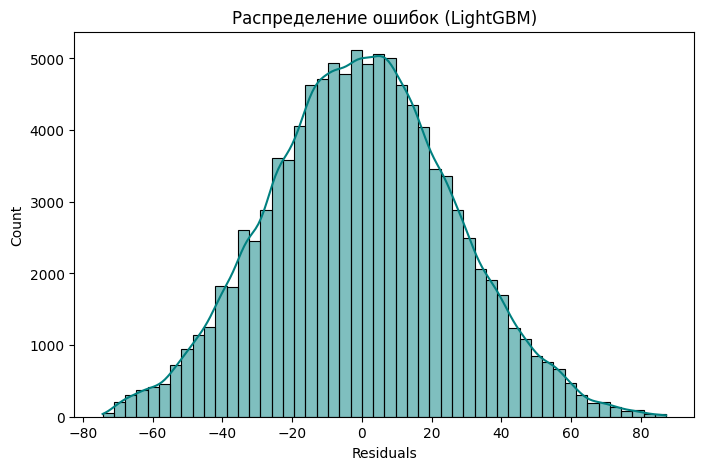

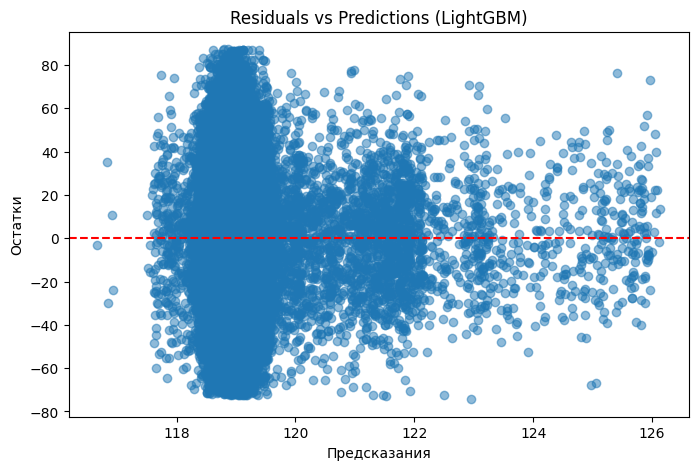

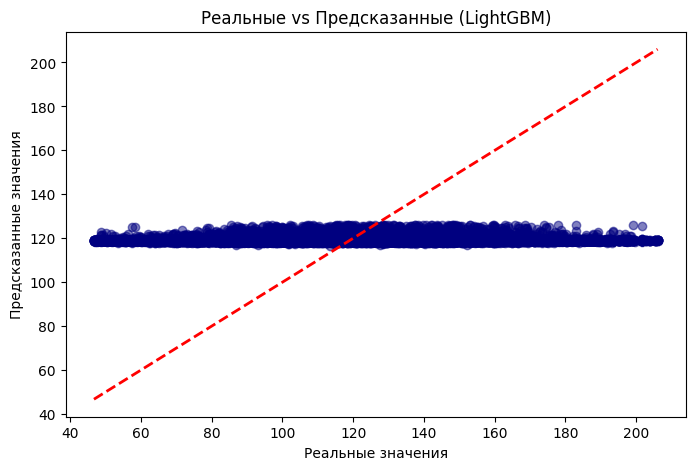

In [118]:
best_model.fit(X_ens, y_ens)
y_pred = best_model.predict(X_valid_ens)
rmse_train = rmse(y_valid_ens, y_pred)
print(f"\n📏 RMSE  ({best_model_name}): {rmse_train:.3f}")

# 🔹 Остатки
residuals = y_valid_ens - y_pred

# 1️⃣ Гистограмма ошибок
plt.figure(figsize=(8,5))
sns.histplot(residuals, bins=50, kde=True, color='teal')
plt.title(f"Распределение ошибок ({best_model_name})")
plt.xlabel("Residuals")
plt.show()

# 2️⃣ Остатки vs Предсказания
plt.figure(figsize=(8,5))
plt.scatter(y_pred, residuals, alpha=0.5)
plt.axhline(0, color='red', linestyle='--')
plt.xlabel("Предсказания")
plt.ylabel("Остатки")
plt.title(f"Residuals vs Predictions ({best_model_name})")
plt.show()

# 3️⃣ Реальные vs Предсказанные
plt.figure(figsize=(8,5))
plt.scatter(y_valid_ens, y_pred, alpha=0.5, color="navy")
plt.plot([y_valid_ens.min(), y_valid_ens.max()],
         [y_valid_ens.min(), y_valid_ens.max()],
         color="red", linestyle="--", linewidth=2)
plt.xlabel("Реальные значения")
plt.ylabel("Предсказанные значения")
plt.title(f"Реальные vs Предсказанные ({best_model_name})")
plt.show()

### Важность признаков

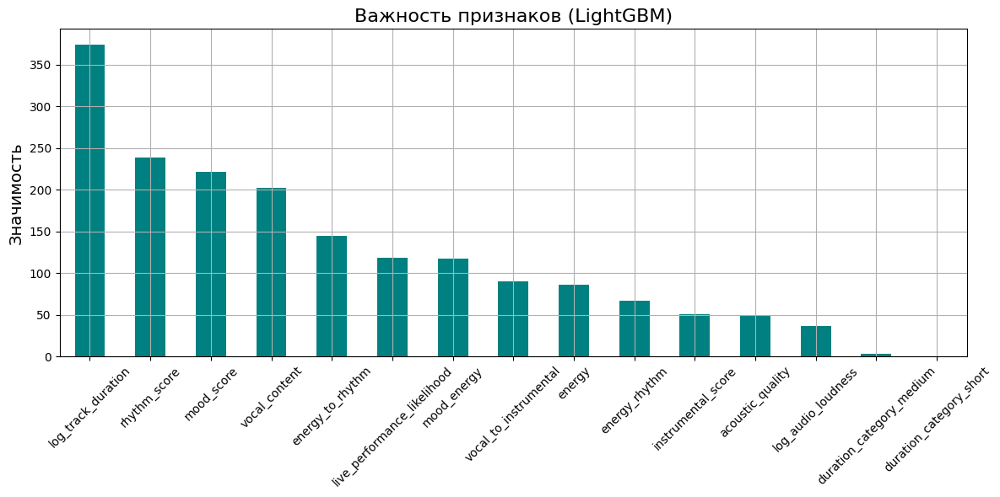

ТОП-5 признаков по важности:


,Значимость
log_track_duration,374
rhythm_score,239
mood_score,221
vocal_content,202
energy_to_rhythm,145


In [119]:
# --- Интерпретация важности признаков ---
try:
    importances = pd.Series(best_model.feature_importances_, index=X_ens.columns)
    importances_sorted = importances.sort_values(ascending=False)

    plt.figure(figsize=(12, 6))
    importances_sorted.plot(kind='bar', color='teal')
    plt.title(f'Важность признаков ({best_model_name})', fontsize=16)
    plt.ylabel('Значимость', fontsize=14)
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # --- ТОП-5 признаков ---
    top5_features = importances_sorted.head(5)
    print("ТОП-5 признаков по важности:")
    display(top5_features.to_frame(name="Значимость"))

except AttributeError:
    print(f"\n⚠️ Модель {best_model_name} не поддерживает feature_importances_.")

<div style="border:solid green 4px; padding: 5px">

__Выводы по шагу 5__

__Признаки имеют нелинейные зависимости с целевой переменной__
- информации в текущем наборе признаков недостаточно
    
__Модели:__
- Базовая модель (DummyRegressor)
  - Это задал базовый уровень ошибки, ниже которого должны опуститься все остальные модели
- Линейные модели (Linear, Ridge, Lasso)
  - Linear Regression показала RMSE значительно выше целевого уровня → линейная зависимость между признаками и BPM практически отсутствует
  - Ridge и Lasso немного улучшили результат за счёт регуляризации, но принципиального скачка качества не дали
- Деревья решений и бустинг
  - Decision Tree улучшил RMSE по сравнению с линейными моделями, но склонен к переобучению
  - Бутснг (XGBoost, LightGBM, CatBoost) показали чуть лучшие результаты, но разница в тысячных

__Все RMSE различаются в пределах ±0.01, что подтверждает:__
- слабую связь между признаками и целевой переменной
- синтетическую природу данных (как указано ранее)  

__R² близок к нулю (например, у XGBoost ≈ 0.0005)__
- модели не объясняют дисперсию целевой переменной
    
__Анализ ошибок__
- Ошибки распределены нормально, без выраженного смещения
  - распределение остатков симметрично относительно нуля, но имеет широкий разброс
- Диаграмма Residuals vs Predictions не показывает трендов → отсутствует систематическая ошибка
  - Residuals vs Predictions показывает случайное облако точек
- График Real vs Predicted демонстрирует отсуствие зависимость (точки близки к диагонали, но с высокой дисперсией)
  - график "Реальные vs Предсказанные" показывает горизонтальную линию вокруг среднего значения — модель предсказывает константу
- Анализ остатков показал высокую случайную ошибуа (шум), что опять-таки указывает на отсутствие сигнала в данных.
  - при наличии других данных помог бы  дополнительный feature engineering или сегментация данных

__Ключевые наблюдения__
- Синтетические данные сгенерированы некорректно:
  - датасет был создан с помощью глубокого обучения на основе оригинального "BPM Prediction Challenge"
  - при генерации связь между признаками и BPM была потеряна или не воспроизведена
  - возможно распределения признаков близки к оригинальным (уточнить в Шаге 7), но зависимости нет    
    
- Синтетические данные не содержат реальных зависимостей между признаками и BPM
  - корреляции по Пирсону и Phik крайне низкие (меньше 0.02)
  - отсутствие сигнала в данных
- Все модели “застряли” на RMSE ≈ 26.46, равном стандартному отклонению целевой переменной
- Feature Engineering (создание взаимодействий, логарифмов и категорий) не изменил картину, что связано с  искусственным характером датасета

__Вывод:__ модели предсказывают средние значения BPM, не улавливая индивидуальных закономерностей 
    
</div>

<div class="alert alert-info">
  <b> * <a href="#ch2_1">к содержанию</a> </b> 
</div>

---

## Шаг 6: Формирование submission <a class="anchor" id="ch2_1_6"></a>

### Предсказание BPM для тестовой выборки с помощью лучшей модели

In [120]:
print("Лучшая модель:", best_model_name)
print("Лучшие параметры:", search_objects[best_model_name].best_params_)
print(best_model)

Лучшая модель: LightGBM
Лучшие параметры: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 200, 'num_leaves': 10}
LGBMRegressor(learning_rate=0.01, max_depth=5, n_estimators=200, num_leaves=10,
              random_state=42, verbose=-1)


In [121]:
# 1. Применить Feature Engineering к test
test = df_test.copy()
test['track_duration_min'] = test['track_duration_ms'] / 60000
test['log_track_duration'] = np.log1p(test['track_duration_ms'])
test['log_audio_loudness'] = np.log1p(-test['audio_loudness'])
test['energy_rhythm'] = test['energy'] * test['rhythm_score']
test['mood_energy'] = test['mood_score'] * test['energy']
test['energy_to_rhythm'] = test['energy'] / (test['rhythm_score'] + 1e-6)
test['vocal_to_instrumental'] = test['vocal_content'] / (test['instrumental_score'] + 1e-6)

def categorize_duration(x):
    if x < 180000: return 'short'
    elif x < 300000: return 'medium'
    else: return 'long'
test['duration_category'] = test['track_duration_ms'].apply(categorize_duration)

In [122]:
# 2. Предобработка
test_prepared, _ = prepare_data_cat(test, test)

In [123]:
# 3. Выбор признаков (как для ансамблей)
features_for_ensembles = [
    'rhythm_score','vocal_content','acoustic_quality',
    'instrumental_score','live_performance_likelihood','mood_score','energy',
    'log_track_duration', 'log_audio_loudness','energy_rhythm','mood_energy','energy_to_rhythm',
    'vocal_to_instrumental','duration_category_medium','duration_category_short'
]


X_test_final = test_prepared[features_for_ensembles]

In [124]:
# 🔹 Совпадают ли имена и порядок столбцов
if list(X_ens.columns) == list(X_test_final.columns):
    print("✅ Имена и порядок столбцов совпадают.")
else:
    print("❌ Столбцы отличаются по именам или порядку.")

✅ Имена и порядок столбцов совпадают.


In [125]:
# 4. Предсказание
y_pred_test = best_model.predict(X_test_final)

In [126]:
# --- Статистический обзор предсказаний ---
y_pred_series = pd.Series(y_pred_test, name="BeatsPerMinute")
print("\n📊 Статистический обзор предсказанных BPM:")
display(y_pred_series.describe().to_frame())


📊 Статистический обзор предсказанных BPM:


,BeatsPerMinute
count,174722.000000
mean,118.998626
std,0.176095
min,118.548934
25%,119.075309
50%,119.084764
75%,119.084764
max,119.084764


### Сохранение итоговых предсказаний в формате

In [127]:
# 5. Submission
submission = pd.DataFrame({
    'id': df_test['id'],
    'BeatsPerMinute': y_pred_test
})
submission.head(10)

,id,BeatsPerMinute
0,524164,118.986509
1,524165,118.647190
2,524166,119.075309
3,524167,119.084764
4,524168,119.084764
5,524169,119.075309
6,524170,119.084764
7,524171,118.986509
8,524172,119.084764
9,524173,119.075309


<div style="border:solid green 4px; padding: 5px">

__Выводы по шагу 6__
- На шаге 6 завершён полный цикл: от выбора лучшей модели до генерации финального submission‑файла
- Модель LightGBM показала наилучший баланс качества и скорости
- Submission сформирован корректно и соответствует требованиям соревнования
    
Критическая проблема данных
- Предсказания практически константны - все значения сосредоточены вокруг среднего
- Отсутствие вариативности в предсказаниях свидетельствует о том, что модель не находит реальных закономерностей
- Модель предсказывает среднее значение, а не индивидуальные BPM для каждого трека    
</div>

<div class="alert alert-info">
  <b> * <a href="#ch2_1">к содержанию</a> </b> 
</div>

---

## Шаг 7: Исследование синтетической природы данных <a class="anchor" id="ch2_1_7"></a>

### Загрузка оригинального датасета

In [128]:
def fetch_kaggle_dataset(dataset_slug, data_dir):
    os.makedirs(data_dir, exist_ok=True)
    api = KaggleApi()
    api.authenticate()

    print(f"📥 Скачиваем датасет '{dataset_slug}'...")
    api.dataset_download_files(dataset_slug, path=data_dir, unzip=True)

    print("✅ Датасет успешно скачан и распакован.")
    print("📂 Содержимое папки:", os.listdir(data_dir))

In [129]:
data_dir_real = r"C:\Users\HP\my_data\kaggle_datasets\02_Kaggle_Playground_S5E9\BPM_Original"
dataset_slug = "gauravduttakiit/bpm-prediction-challenge"

# Скачиваем и распаковываем весь датасет
fetch_kaggle_dataset(dataset_slug, data_dir_real)

📥 Скачиваем датасет 'gauravduttakiit/bpm-prediction-challenge'...
Dataset URL: https://www.kaggle.com/datasets/gauravduttakiit/bpm-prediction-challenge
✅ Датасет успешно скачан и распакован.
📂 Содержимое папки: ['Submission.csv', 'Test.csv', 'Train.csv']


In [130]:
# Загружаем оригинальные данные BPM Prediction Challenge
original_train = process_dataframe("Train.csv", data_dir_real)
original_test = process_dataframe("Test.csv", data_dir_real)
original_sample = process_dataframe("Submission.csv", data_dir_real)

📂 Загружаем файл: Train.csv
🔍 Определена кодировка: ascii
📁 Абсолютный путь к файлу: C:\Users\HP\my_data\kaggle_datasets\02_Kaggle_Playground_S5E9\BPM_Original\Train.csv

🔎 Первые 5 строк:


,RhythmScore,AudioLoudness,VocalContent,AcousticQuality,InstrumentalScore,LivePerformanceLikelihood,MoodScore,TrackDurationMs,Energy,BeatsPerMinute
0,0.513080,-7.811659,0.071013,0.064564,0.109495,0.316042,0.736929,328639.3188,0.556200,117.092439
1,0.775393,-6.819409,0.023500,0.510599,0.187498,0.024361,0.259488,271967.9826,0.410533,122.002279
2,0.636408,-19.782248,0.063451,0.427861,0.002226,0.024300,0.054848,186147.0029,0.533333,149.130616
3,0.232190,-14.957299,0.023500,0.076268,0.000001,0.228454,0.744650,321734.9723,0.658533,95.832178
4,0.758564,-4.715966,0.023500,0.263551,0.414794,0.197167,0.966592,179973.3982,0.230467,125.696263



🎲 Случайные 5 строк:


,RhythmScore,AudioLoudness,VocalContent,AcousticQuality,InstrumentalScore,LivePerformanceLikelihood,MoodScore,TrackDurationMs,Energy,BeatsPerMinute
11194,0.684074,-1.357000,0.098395,0.017416,0.071587,0.342313,0.504099,204272.9985,0.132267,106.012174
14629,0.267248,-8.657102,0.023500,0.218652,0.161223,0.287364,0.763650,135276.0877,0.148467,132.107938
14484,0.661920,-8.987083,0.023500,0.000005,0.072722,0.198416,0.266698,301031.6589,0.865867,142.882649
6843,0.413174,-5.852338,0.237149,0.152493,0.236064,0.401917,0.289575,316430.2497,0.843267,128.873309
7650,0.860475,-1.787649,0.078874,0.197509,0.000001,0.395983,0.104136,191298.9327,0.450867,116.933369



📉 Последние 5 строк:


,RhythmScore,AudioLoudness,VocalContent,AcousticQuality,InstrumentalScore,LivePerformanceLikelihood,MoodScore,TrackDurationMs,Energy,BeatsPerMinute
14628,0.769195,-13.608768,0.041826,0.551064,0.127238,0.024300,0.508722,223465.5814,0.473600,82.317428
14629,0.267248,-8.657102,0.023500,0.218652,0.161223,0.287364,0.763650,135276.0877,0.148467,132.107938
14630,0.469302,-1.961814,0.023500,0.912164,0.152560,0.227046,0.619231,134735.8587,0.423133,83.344250
14631,0.588335,-9.766187,0.023500,0.000005,0.050234,0.340709,0.177841,187951.2290,0.340000,121.297185
14632,0.949208,-1.357000,0.059920,0.519587,0.000001,0.346817,0.865321,103318.7671,0.938067,128.250900



🧠 Информация о датафрейме:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14633 entries, 0 to 14632
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   RhythmScore                14633 non-null  float64
 1   AudioLoudness              14633 non-null  float64
 2   VocalContent               14633 non-null  float64
 3   AcousticQuality            14633 non-null  float64
 4   InstrumentalScore          14633 non-null  float64
 5   LivePerformanceLikelihood  14633 non-null  float64
 6   MoodScore                  14633 non-null  float64
 7   TrackDurationMs            14633 non-null  float64
 8   Energy                     14633 non-null  float64
 9   BeatsPerMinute             14633 non-null  float64
dtypes: float64(10)
memory usage: 1.1 MB

📐 Размер датафрейма:
(14633, 10)

🏷️ Названия столбцов:
Index(['RhythmScore', 'AudioLoudness', 'VocalContent', 'AcousticQuality',
       'Instrumenta

,RhythmScore,AudioLoudness,VocalContent,AcousticQuality,InstrumentalScore,LivePerformanceLikelihood,MoodScore,TrackDurationMs,Energy,BeatsPerMinute
0,0.773949,-6.377051,0.066823,0.000005,0.063230,0.200380,0.442238,194124.24330,0.205267,NaN
1,0.517672,-13.491908,0.148546,0.000005,0.341291,0.242906,0.714116,243899.92570,0.839800,NaN
2,0.707310,-11.806614,0.076194,0.496764,0.230045,0.076176,0.600724,220769.05740,0.014267,NaN
3,0.735896,-8.554334,0.023500,0.133002,0.000001,0.412421,0.437760,91735.48906,0.250200,NaN
4,0.479114,-11.522295,0.043153,0.000005,0.000001,0.336359,0.443450,240778.00310,0.575800,NaN



🎲 Случайные 5 строк:


,RhythmScore,AudioLoudness,VocalContent,AcousticQuality,InstrumentalScore,LivePerformanceLikelihood,MoodScore,TrackDurationMs,Energy,BeatsPerMinute
229,0.734641,-7.624958,0.023500,0.088521,0.000001,0.024300,0.543996,190575.4277,0.715533,NaN
76,0.455861,-17.351929,0.180341,0.543340,0.089891,0.024300,0.550871,271152.9760,0.883867,NaN
176,0.637041,-2.356906,0.023500,0.615088,0.000001,0.343800,0.417330,261393.4974,0.419533,NaN
275,0.649436,-8.637753,0.158610,0.478021,0.063405,0.357435,0.796599,279538.0125,0.120200,NaN
69,0.503385,-6.559832,0.056933,0.000005,0.110081,0.161346,0.404464,246519.7562,0.547000,NaN



📉 Последние 5 строк:


,RhythmScore,AudioLoudness,VocalContent,AcousticQuality,InstrumentalScore,LivePerformanceLikelihood,MoodScore,TrackDurationMs,Energy,BeatsPerMinute
295,0.663226,-6.007744,0.130280,0.253588,0.732283,0.351675,0.580555,217523.9333,0.342867,NaN
296,0.641252,-6.896111,0.023500,0.239343,0.381767,0.024300,0.600416,319369.4953,0.423200,NaN
297,0.592423,-11.605669,0.145087,0.476253,0.122598,0.227633,0.566085,117676.5841,0.205600,NaN
298,0.700223,-11.502847,0.048377,0.532664,0.000001,0.107045,0.978000,265804.6312,0.004333,NaN
299,0.482714,-18.210782,0.023500,0.345813,0.229967,0.358615,0.276236,189990.0995,0.177933,NaN



🧠 Информация о датафрейме:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 300 entries, 0 to 299
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   RhythmScore                300 non-null    float64
 1   AudioLoudness              300 non-null    float64
 2   VocalContent               300 non-null    float64
 3   AcousticQuality            300 non-null    float64
 4   InstrumentalScore          300 non-null    float64
 5   LivePerformanceLikelihood  300 non-null    float64
 6   MoodScore                  300 non-null    float64
 7   TrackDurationMs            300 non-null    float64
 8   Energy                     300 non-null    float64
 9   BeatsPerMinute             0 non-null      float64
dtypes: float64(10)
memory usage: 23.6 KB

📐 Размер датафрейма:
(300, 10)

🏷️ Названия столбцов:
Index(['RhythmScore', 'AudioLoudness', 'VocalContent', 'AcousticQuality',
       'InstrumentalScor

,BeatsPerMinute
0,0.0
1,0.0
2,0.0
3,0.0
4,0.0



🎲 Случайные 5 строк:


,BeatsPerMinute
25,0.0
0,0.0
176,0.0
245,0.0
275,0.0



📉 Последние 5 строк:


,BeatsPerMinute
295,0.0
296,0.0
297,0.0
298,0.0
299,0.0



🧠 Информация о датафрейме:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 300 entries, 0 to 299
Data columns (total 1 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   BeatsPerMinute  300 non-null    float64
dtypes: float64(1)
memory usage: 2.5 KB

📐 Размер датафрейма:
(300, 1)

🏷️ Названия столбцов:
Index(['BeatsPerMinute'], dtype='object')


In [131]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 524164 entries, 0 to 524163
Data columns (total 12 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   id                           524164 non-null  int64  
 1   rhythm_score                 524164 non-null  float64
 2   audio_loudness               524164 non-null  float64
 3   vocal_content                524164 non-null  float64
 4   acoustic_quality             524164 non-null  float64
 5   instrumental_score           524164 non-null  float64
 6   live_performance_likelihood  524164 non-null  float64
 7   mood_score                   524164 non-null  float64
 8   track_duration_ms            524164 non-null  float64
 9   energy                       524164 non-null  float64
 10  beats_per_minute             524164 non-null  float64
 11  bpm_category                 524164 non-null  object 
dtypes: float64(10), int64(1), object(1)
memory usage: 48.0+ MB

In [132]:
original_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14633 entries, 0 to 14632
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   RhythmScore                14633 non-null  float64
 1   AudioLoudness              14633 non-null  float64
 2   VocalContent               14633 non-null  float64
 3   AcousticQuality            14633 non-null  float64
 4   InstrumentalScore          14633 non-null  float64
 5   LivePerformanceLikelihood  14633 non-null  float64
 6   MoodScore                  14633 non-null  float64
 7   TrackDurationMs            14633 non-null  float64
 8   Energy                     14633 non-null  float64
 9   BeatsPerMinute             14633 non-null  float64
dtypes: float64(10)
memory usage: 1.1 MB


In [133]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 174722 entries, 0 to 174721
Data columns (total 10 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   id                           174722 non-null  int64  
 1   rhythm_score                 174722 non-null  float64
 2   audio_loudness               174722 non-null  float64
 3   vocal_content                174722 non-null  float64
 4   acoustic_quality             174722 non-null  float64
 5   instrumental_score           174722 non-null  float64
 6   live_performance_likelihood  174722 non-null  float64
 7   mood_score                   174722 non-null  float64
 8   track_duration_ms            174722 non-null  float64
 9   energy                       174722 non-null  float64
dtypes: float64(9), int64(1)
memory usage: 13.3 MB


In [134]:
original_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 300 entries, 0 to 299
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   RhythmScore                300 non-null    float64
 1   AudioLoudness              300 non-null    float64
 2   VocalContent               300 non-null    float64
 3   AcousticQuality            300 non-null    float64
 4   InstrumentalScore          300 non-null    float64
 5   LivePerformanceLikelihood  300 non-null    float64
 6   MoodScore                  300 non-null    float64
 7   TrackDurationMs            300 non-null    float64
 8   Energy                     300 non-null    float64
 9   BeatsPerMinute             0 non-null      float64
dtypes: float64(10)
memory usage: 23.6 KB


### Сравнение распределений признаков в синтетических и оригинальныхъ датсетах

In [135]:
def to_snake_case(col_name):
    # Вставляем нижнее подчёркивание между словами, если они слеплены в CamelCase или PascalCase
    col_name = re.sub(r'(?<=[a-z])(?=[A-Z])', '_', col_name)
    col_name = re.sub(r'(?<=[A-Z])(?=[A-Z][a-z])', '_', col_name)
    return col_name.strip().lower()

# Применяем к каждому датафрейму
original_train.columns = [to_snake_case(col) for col in original_train.columns]
original_test.columns = [to_snake_case(col) for col in original_test.columns]
original_sample.columns = [to_snake_case(col) for col in original_sample.columns]

print("Train columns:", original_train.columns.tolist())
print("Test columns:", original_test.columns.tolist())
print("Sample columns:", original_sample.columns.tolist())

Train columns: ['rhythm_score', 'audio_loudness', 'vocal_content', 'acoustic_quality', 'instrumental_score', 'live_performance_likelihood', 'mood_score', 'track_duration_ms', 'energy', 'beats_per_minute']
Test columns: ['rhythm_score', 'audio_loudness', 'vocal_content', 'acoustic_quality', 'instrumental_score', 'live_performance_likelihood', 'mood_score', 'track_duration_ms', 'energy', 'beats_per_minute']
Sample columns: ['beats_per_minute']


In [136]:
# Преобразуем в множества
set1 = set(original_train.columns)
set2 = set(original_test.columns)

# Найдём различия
only_in_df1 = sorted(set1 - set2)
only_in_df2 = sorted(set2 - set1)

# Выводим результат
print("📘 Колонки только в df1:", only_in_df1)
print("📗 Колонки только в df2:", only_in_df2)

📘 Колонки только в df1: []
📗 Колонки только в df2: []


In [137]:
# Преобразуем в множества
set1 = set(original_train.columns)
set2 = set(df_train.columns)

# Найдём различия
only_in_df1 = sorted(set1 - set2)
only_in_df2 = sorted(set2 - set1)

# Выводим результат
print("📘 Колонки только в df1:", only_in_df1)
print("📗 Колонки только в df2:", only_in_df2)

📘 Колонки только в df1: []
📗 Колонки только в df2: ['bpm_category', 'id']


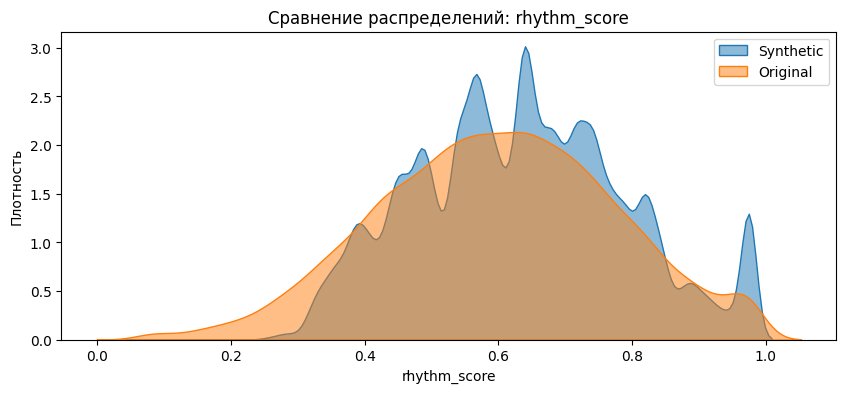

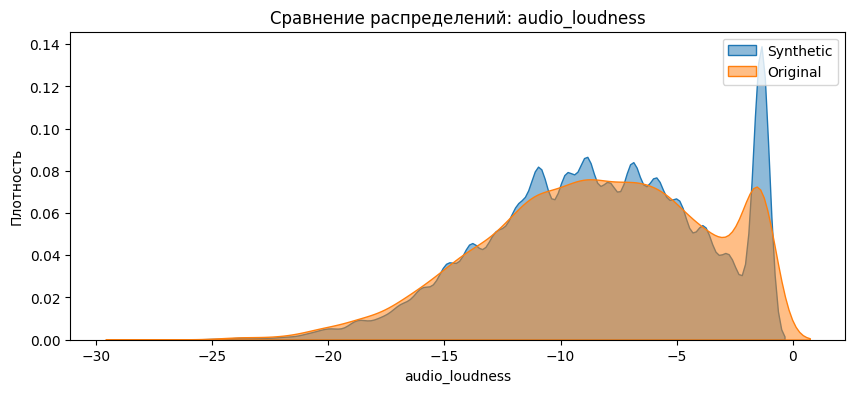

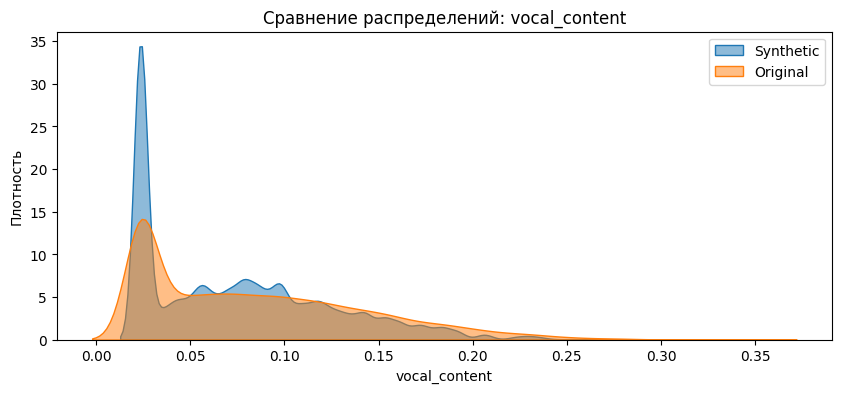

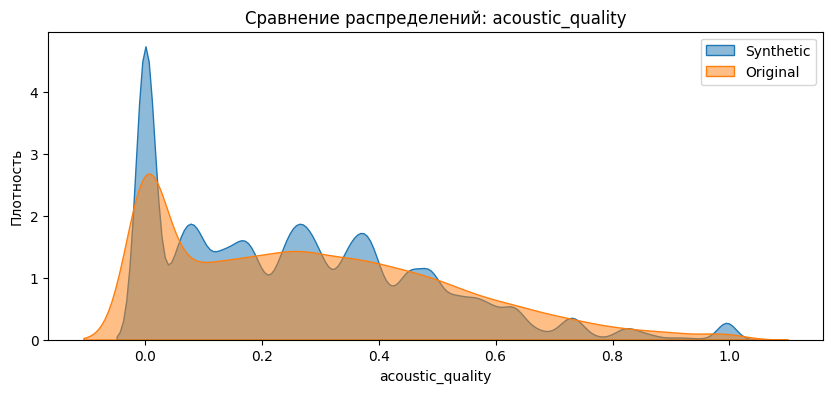

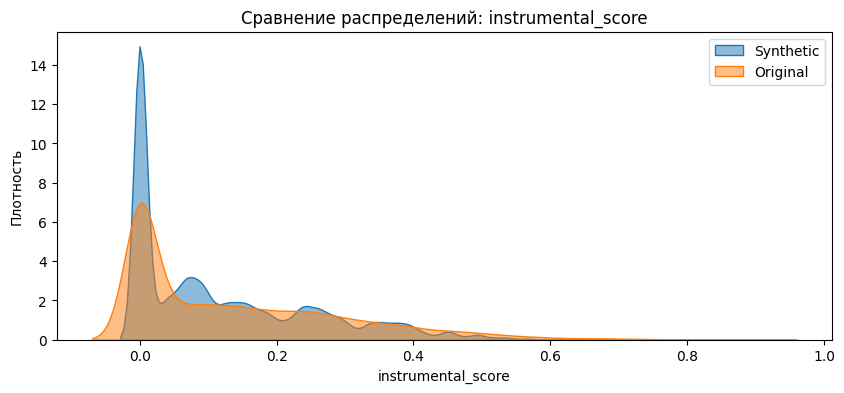

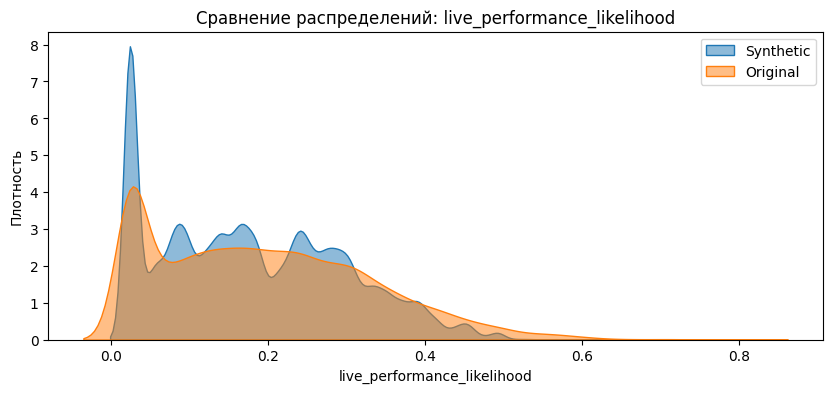

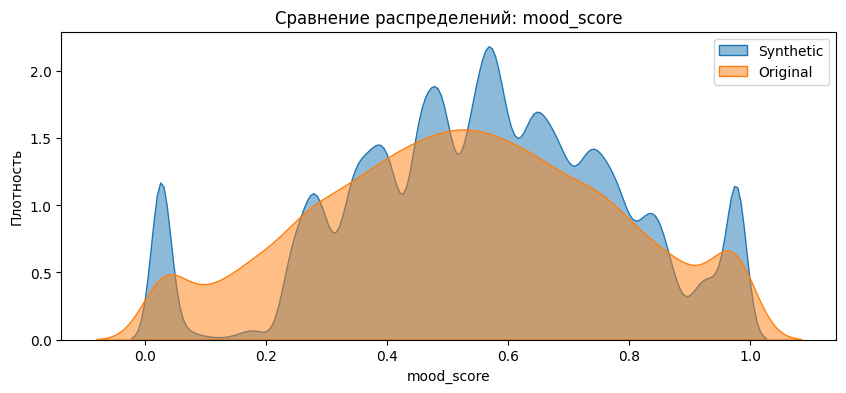

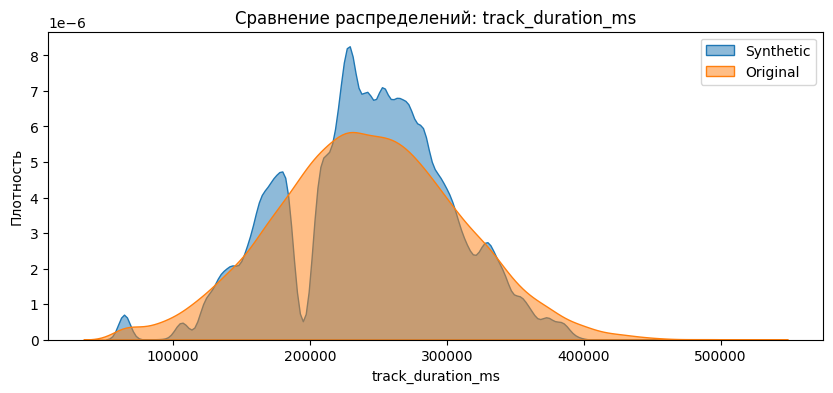

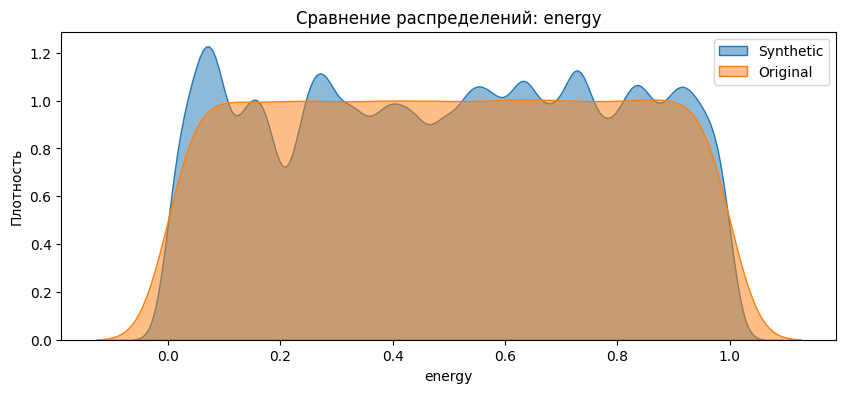

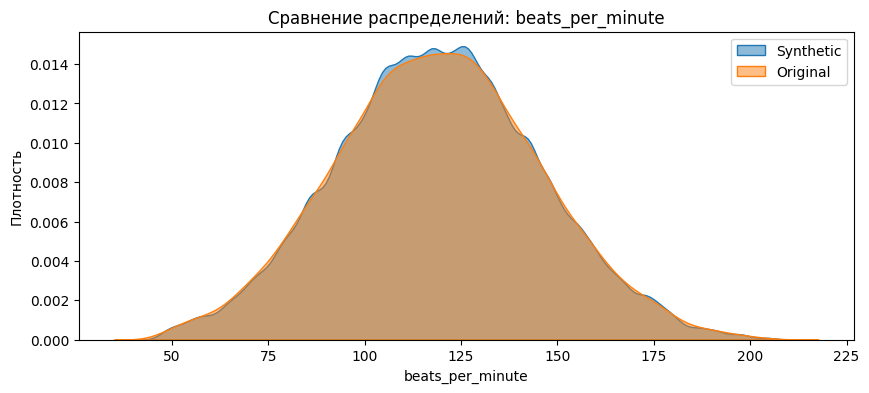

In [138]:
# --- Сравнение распределений признаков ---
for col in df_train.columns:
    if col in original_train.columns and col not in ["id", "bpm_category"]:
        plt.figure(figsize=(10, 4))
        sns.kdeplot(df_train[col], label="Synthetic", fill=True, alpha=0.5)
        sns.kdeplot(original_train[col], label="Original", fill=True, alpha=0.5)
        plt.title(f"Сравнение распределений: {col}")
        plt.xlabel(col)
        plt.ylabel("Плотность")
        plt.legend()
        plt.show()

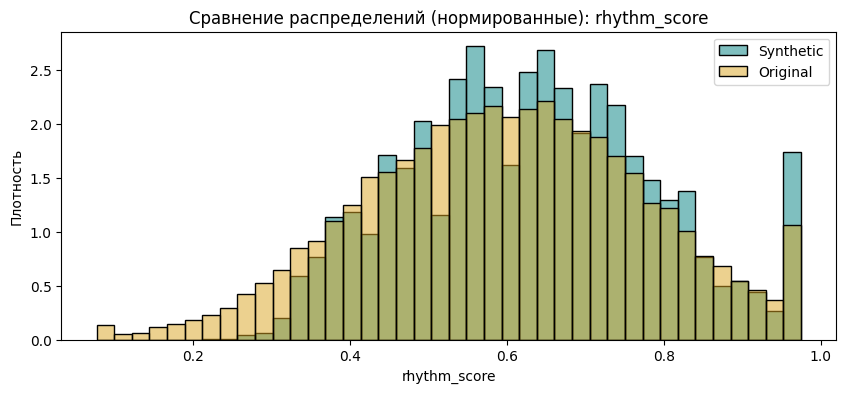


📊 Статистики для признака: rhythm_score


,Synthetic,Original
count,524164.000000,14633.000000
mean,0.632843,0.597370
std,0.156899,0.176921
min,0.076900,0.076900
25%,0.515850,0.474349
50%,0.634686,0.600233
75%,0.739179,0.720912
max,0.975000,0.975000
median,0.634686,0.600233


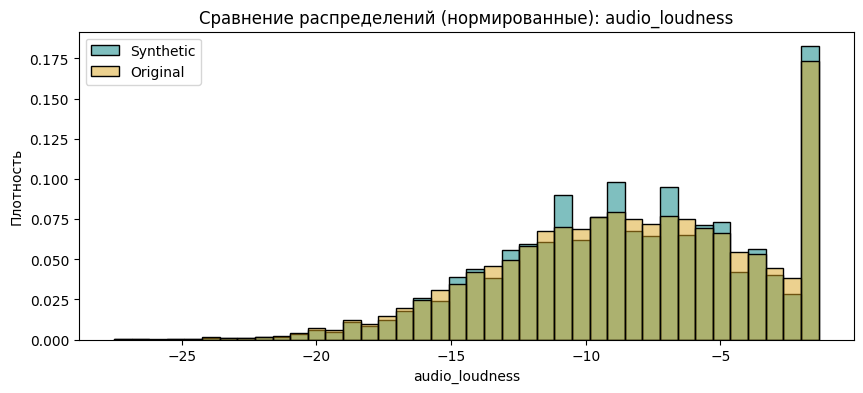


📊 Статистики для признака: audio_loudness


,Synthetic,Original
count,524164.000000,14633.000000
mean,-8.379014,-8.441599
std,4.616221,4.727868
min,-27.509725,-27.509725
25%,-11.551933,-11.659427
50%,-8.252499,-8.236074
75%,-4.912298,-4.829767
max,-1.357000,-1.357000
median,-8.252499,-8.236074


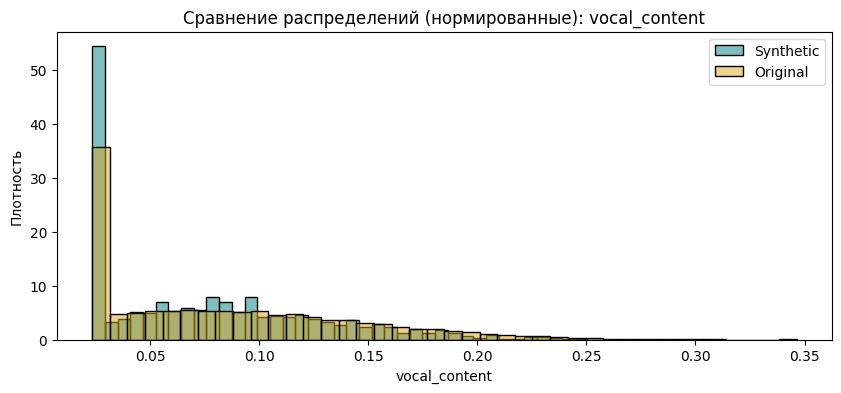


📊 Статистики для признака: vocal_content


,Synthetic,Original
count,524164.000000,14633.000000
mean,0.074443,0.083957
std,0.049939,0.058226
min,0.023500,0.023500
25%,0.023500,0.023500
50%,0.066425,0.072629
75%,0.107343,0.122715
max,0.256401,0.346387
median,0.066425,0.072629


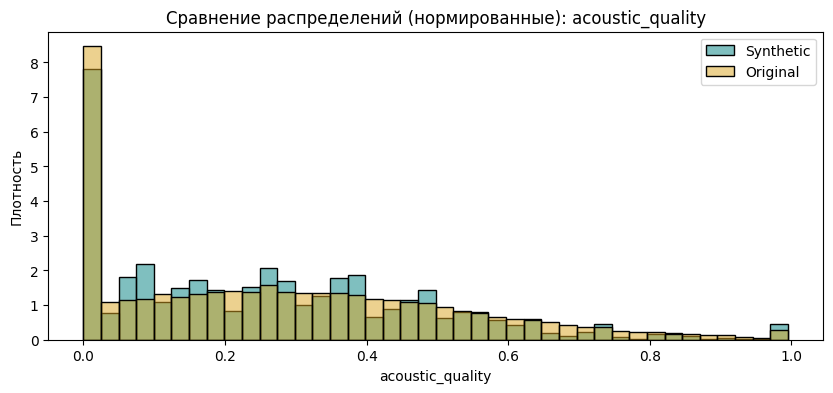


📊 Статистики для признака: acoustic_quality


,Synthetic,Original
count,524164.000000,14633.000000
mean,0.262913,0.280623
std,0.223120,0.238181
min,0.000005,0.000005
25%,0.069413,0.061750
50%,0.242502,0.252848
75%,0.396957,0.441652
max,0.995000,0.995000
median,0.242502,0.252848


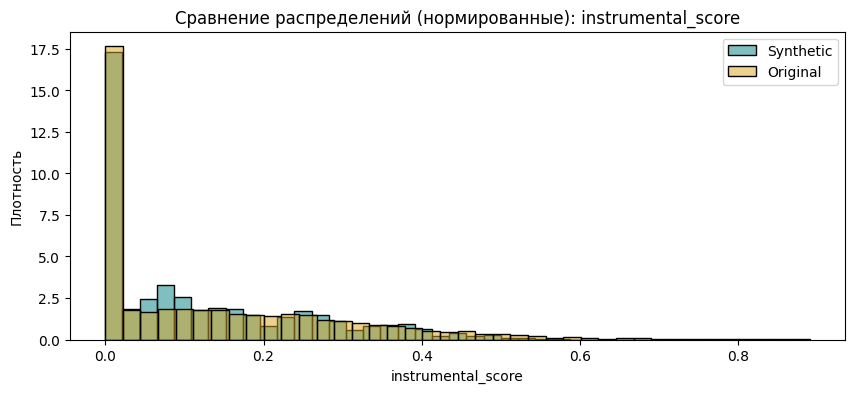


📊 Статистики для признака: instrumental_score


,Synthetic,Original
count,524164.000000,14633.000000
mean,0.117690,0.136972
std,0.131845,0.158300
min,0.000001,0.000001
25%,0.000001,0.000001
50%,0.074247,0.082805
75%,0.204065,0.236554
max,0.869258,0.890385
median,0.074247,0.082805


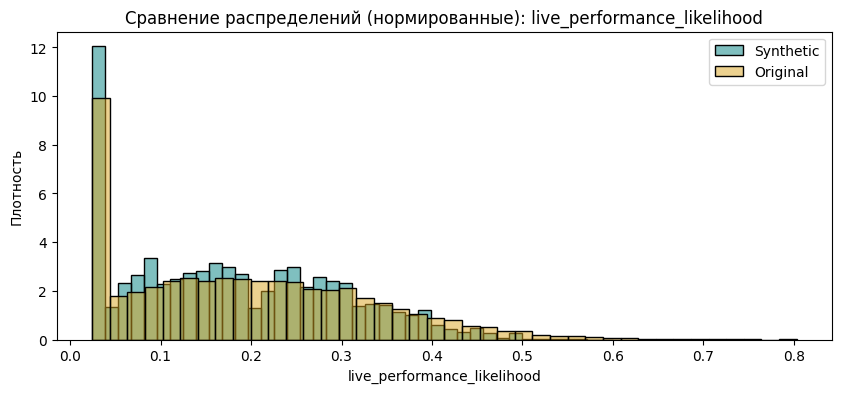


📊 Статистики для признака: live_performance_likelihood


,Synthetic,Original
count,524164.000000,14633.000000
mean,0.178398,0.193121
std,0.118186,0.135068
min,0.024300,0.024300
25%,0.077637,0.075404
50%,0.166327,0.180057
75%,0.268946,0.287646
max,0.599924,0.803157
median,0.166327,0.180057


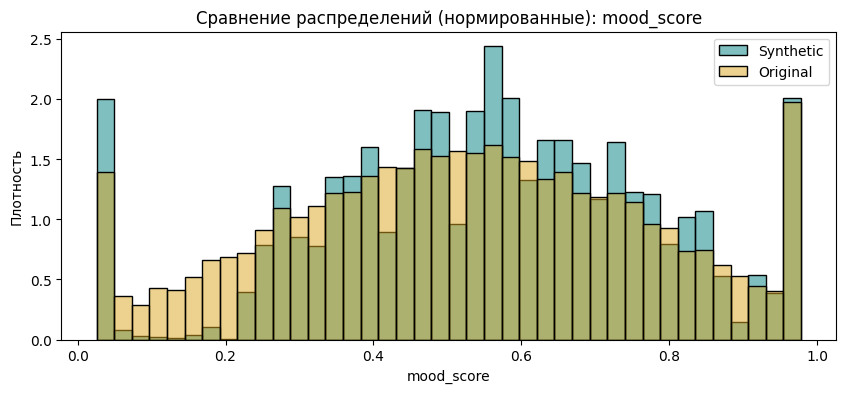


📊 Статистики для признака: mood_score


,Synthetic,Original
count,524164.000000,14633.000000
mean,0.555843,0.523717
std,0.225480,0.241670
min,0.025600,0.025600
25%,0.403921,0.351998
50%,0.564817,0.525871
75%,0.716633,0.699439
max,0.978000,0.978000
median,0.564817,0.525871


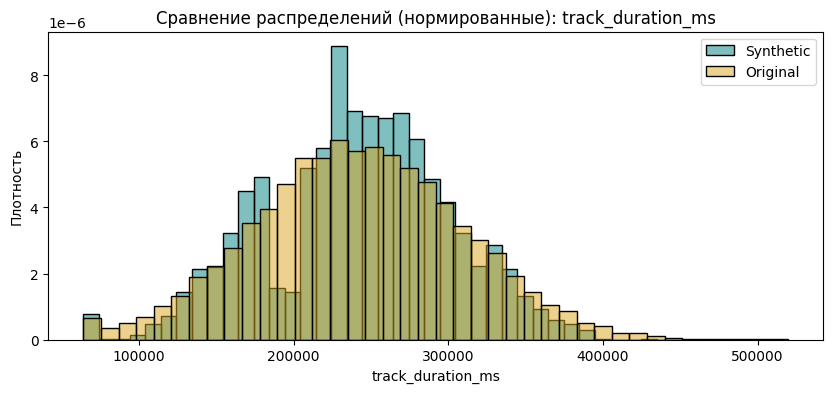


📊 Статистики для признака: track_duration_ms


,Synthetic,Original
count,524164.000000,14633.000000
mean,241903.692949,241743.824913
std,59326.601501,67216.815488
min,63973.000000,63973.000000
25%,207099.876625,196588.623600
50%,243684.058150,241235.859000
75%,281851.658500,286987.805700
max,464723.228100,519650.691100
median,243684.058150,241235.859000


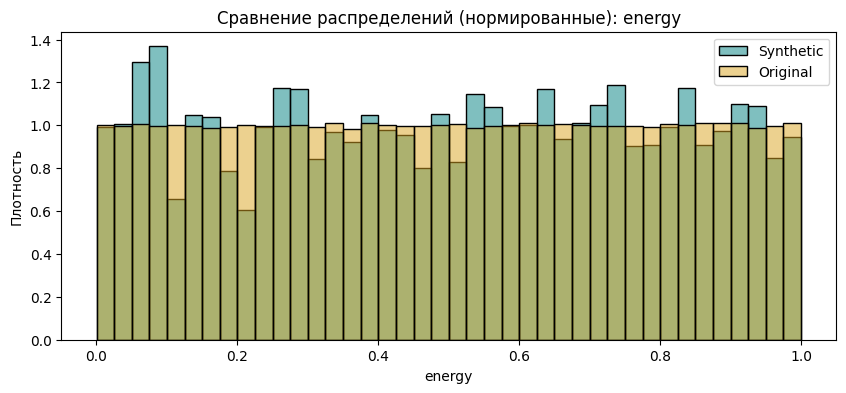


📊 Статистики для признака: energy


,Synthetic,Original
count,524164.000000,14633.000000
mean,0.500923,0.500550
std,0.289952,0.288769
min,0.000067,0.000067
25%,0.254933,0.250600
50%,0.511800,0.500800
75%,0.746000,0.750600
max,1.000000,1.000000
median,0.511800,0.500800


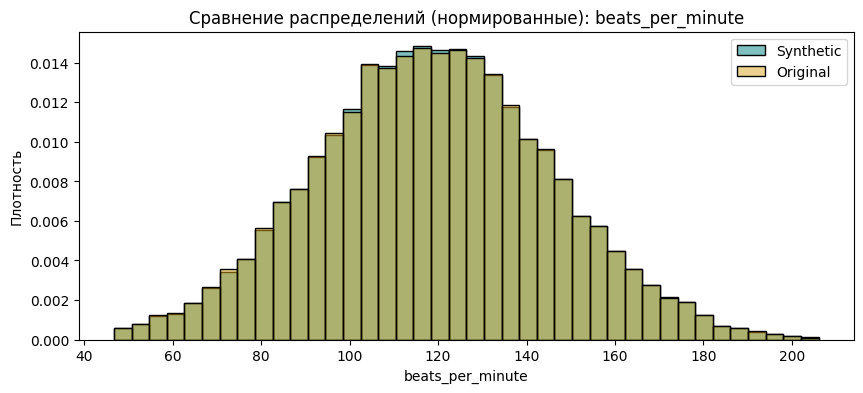


📊 Статистики для признака: beats_per_minute


,Synthetic,Original
count,524164.000000,14633.000000
mean,119.034899,118.968750
std,26.468077,26.566071
min,46.718000,46.718000
25%,101.070410,100.888445
50%,118.747660,118.733631
75%,136.686590,136.728906
max,206.037000,206.037000
median,118.747660,118.733631


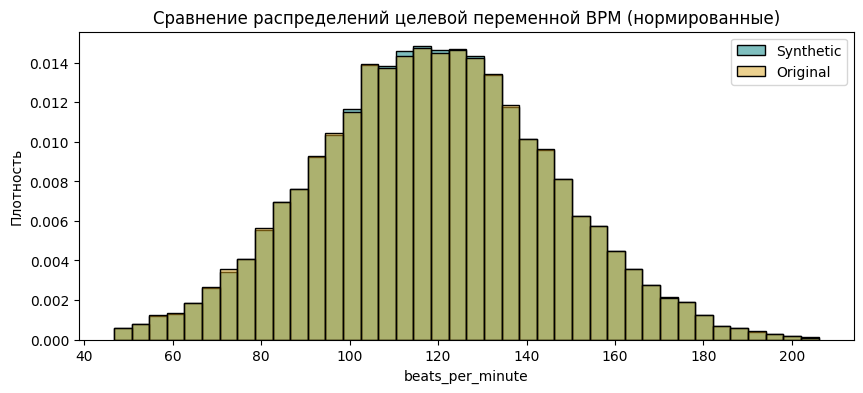


📊 Статистики для целевой переменной BeatsPerMinute


,Synthetic,Original
count,524164.000000,14633.000000
mean,119.034899,118.968750
std,26.468077,26.566071
min,46.718000,46.718000
25%,101.070410,100.888445
50%,118.747660,118.733631
75%,136.686590,136.728906
max,206.037000,206.037000
median,118.747660,118.733631


In [139]:
# --- Сравнение признаков ---
for col in df_train.columns:
    if col in original_train.columns and col not in ["id", "bpm_category"]:
        # 1. Нормированные гистограммы
        plt.figure(figsize=(10, 4))
        sns.histplot(df_train[col], label="Synthetic", color="teal",
                     bins=40, stat="density", alpha=0.5)
        sns.histplot(original_train[col], label="Original", color="goldenrod",
                     bins=40, stat="density", alpha=0.5)
        plt.title(f"Сравнение распределений (нормированные): {col}")
        plt.xlabel(col)
        plt.ylabel("Плотность")
        plt.legend()
        plt.show()

        # 2. Таблица describe
        desc_synth = df_train[col].describe().to_frame(name="Synthetic")
        desc_orig = original_train[col].describe().to_frame(name="Original")

        # Добавим медиану
        desc_synth.loc["median"] = df_train[col].median()
        desc_orig.loc["median"] = original_train[col].median()

        comparison = pd.concat([desc_synth, desc_orig], axis=1)
        print(f"\n📊 Статистики для признака: {col}")
        display(comparison)

# --- Сравнение целевой переменной ---
target_col = "beats_per_minute"

plt.figure(figsize=(10, 4))
sns.histplot(df_train[target_col], label="Synthetic", color="teal",
             bins=40, stat="density", alpha=0.5)
sns.histplot(original_train[target_col], label="Original", color="goldenrod",
             bins=40, stat="density", alpha=0.5)
plt.title("Сравнение распределений целевой переменной BPM (нормированные)")
plt.xlabel(target_col)
plt.ylabel("Плотность")
plt.legend()
plt.show()

desc_synth = df_train[target_col].describe().to_frame(name="Synthetic")
desc_orig = original_train[target_col].describe().to_frame(name="Original")

desc_synth.loc["median"] = df_train[target_col].median()
desc_orig.loc["median"] = original_train[target_col].median()

comparison = pd.concat([desc_synth, desc_orig], axis=1)
print("\n📊 Статистики для целевой переменной BeatsPerMinute")
display(comparison)

### Корреляция признаков с целевой переменной в синтетических и оригинальныхъ датсетах

In [140]:
# --- Корреляция признаков с целевой переменной ---

# Синтетические данные
corr_synth = df_train.corr(numeric_only=True)["beats_per_minute"].drop("beats_per_minute")
corr_synth = corr_synth.sort_values(ascending=False).to_frame(name="Synthetic")
corr_synth 

,Synthetic
mood_score,0.007059
track_duration_ms,0.006637
rhythm_score,0.005440
vocal_content,0.004876
live_performance_likelihood,0.003471
instrumental_score,0.001900
id,-0.000355
acoustic_quality,-0.000820
audio_loudness,-0.003327
energy,-0.004375


In [141]:
# --- Корреляция признаков с целевой переменной ---

# Оригинальные данные
corr_orig = original_train.corr(numeric_only=True)["beats_per_minute"].drop("beats_per_minute")
corr_orig = corr_orig.sort_values(ascending=False).to_frame(name="Original")
corr_orig

,Original
live_performance_likelihood,0.010349
track_duration_ms,0.008666
audio_loudness,0.006960
acoustic_quality,0.006632
mood_score,0.005445
rhythm_score,-0.000807
vocal_content,-0.003807
instrumental_score,-0.006639
energy,-0.008552


### Диаграммы рассеивания между целевой переменнной и признаками

In [142]:
def plot_target_vs_features(df, target, figsize=(20, 6)):
    # Удаляем колонку 'id', если она есть
    df = df.drop(columns=['id'], errors='ignore')

    # Выбираем числовые признаки, исключая таргет
    numeric_features = df.select_dtypes(include='number').columns.drop(target, errors='ignore')

    for feature in numeric_features:
        plt.figure(figsize=figsize)
        sns.scatterplot(data=df, x=feature, y=target)
        plt.title(f"Зависимость '{target}' от '{feature}' в датасете df_train", fontsize=14)
        plt.xlabel(feature)
        plt.ylabel(target)
        plt.grid(True)
        plt.tight_layout()
        plt.show()

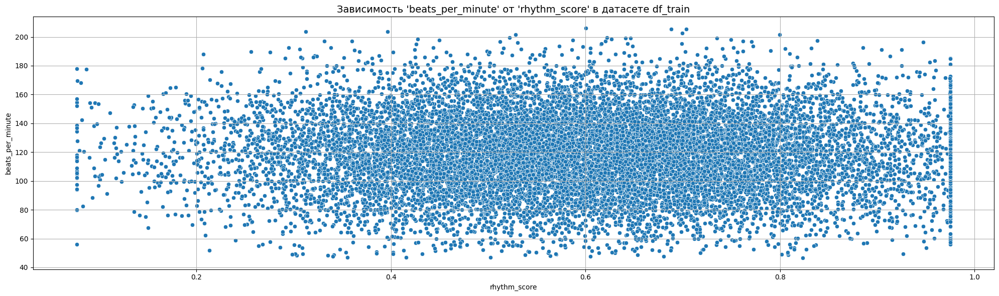

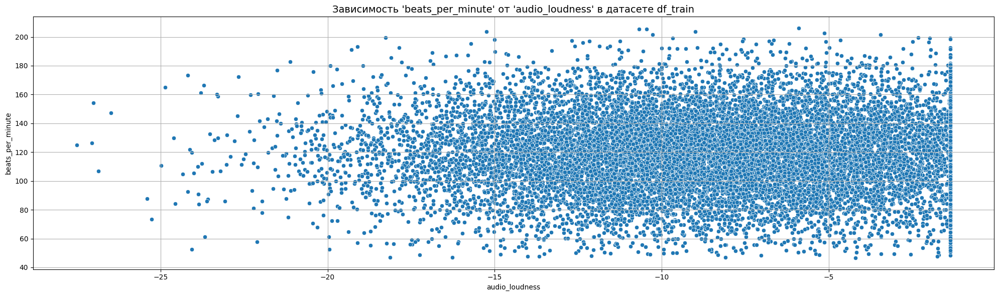

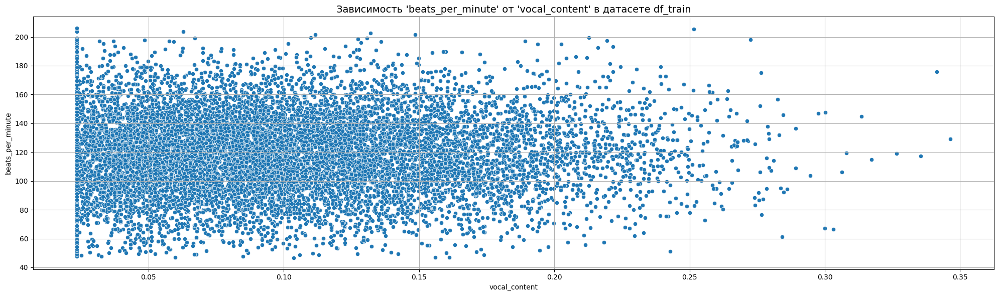

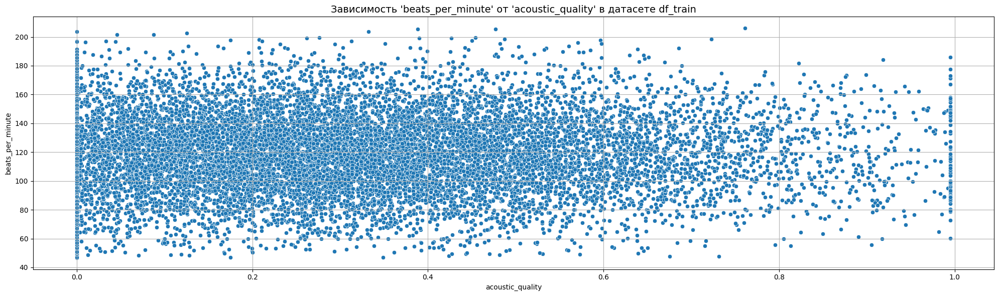

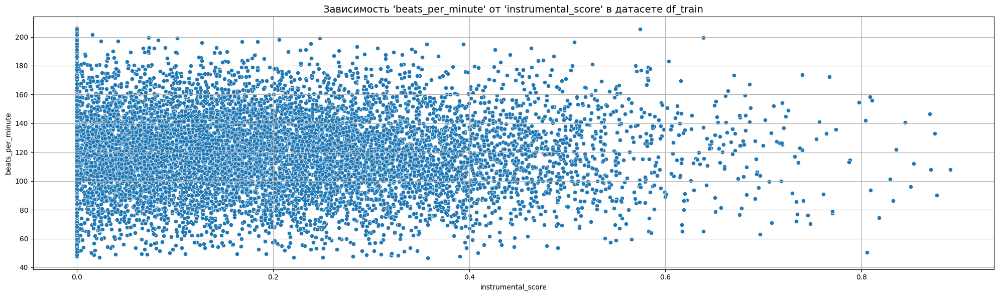

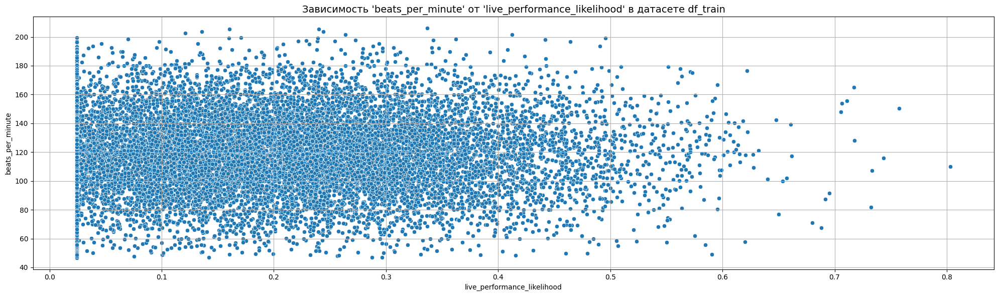

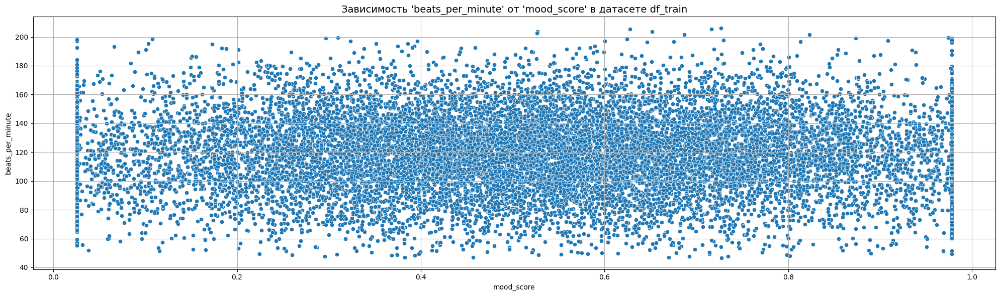

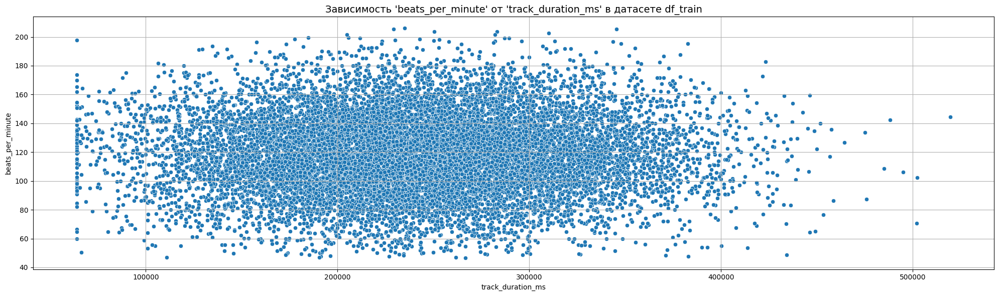

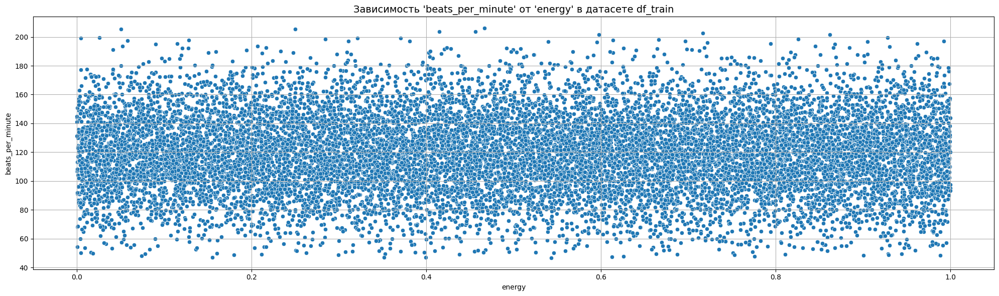

In [143]:
plot_target_vs_features(original_train, target='beats_per_minute')

<div class="alert alert-info">
  <b> * <a href="#ch2_1">к содержанию</a> </b> 
</div>

---